In [2]:
import pandas as pd
import numpy as np
import spacy
from spacy import displacy
from spacy.util import minibatch, compounding
from sklearn import preprocessing

import explacy
import urllib.request
import scattertext as st


import matplotlib.pyplot as plt


df_train = pd.read_csv('./Corona_NLP_train.csv')


In [3]:
spacy.load('en_core_web_md')

In [4]:
df_train.columns

Index(['UserName', 'ScreenName', 'Location', 'TweetAt', 'OriginalTweet',
       'Sentiment'],
      dtype='object')

In [5]:
df_train.head()
print(df_train.shape)

(41157, 6)


In [6]:
#EDA- Nan values
var_null_train = [var for var in df_train.columns if df_train[var].isnull().sum() > 0]
print(var_null_train)
df_train[var_null_train].isnull().mean()

['Location']


Location    0.208713
dtype: float64

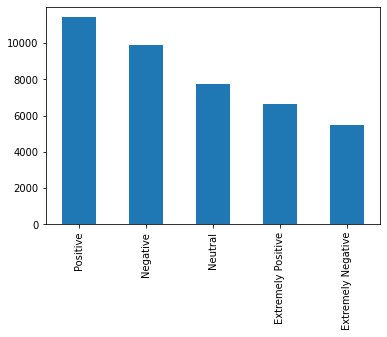

In [7]:
ax = df_train.Sentiment.value_counts().plot(kind='bar')
fig = ax.get_figure()

## since this is a sentiment analysis task only 'tweets' and 'sentiment' are considered

In [8]:
train_df = df_train[['OriginalTweet', 'Sentiment']]

In [9]:
train_df.shape

(41157, 2)

In [10]:
train_df.isnull().sum()

OriginalTweet    0
Sentiment        0
dtype: int64

In [11]:
label_encoder = preprocessing.LabelEncoder()
train_df['Sentiment']= label_encoder.fit_transform(train_df['Sentiment'])
  
train_df['Sentiment'].unique()

array([3, 4, 0, 2, 1])

In [12]:
train_df.head()

,OriginalTweet,Sentiment
0,@MeNyrbie @Phil_Gahan @Chrisitv https://t.co/i...,3
1,advice Talk to your neighbours family to excha...,4
2,Coronavirus Australia: Woolworths to give elde...,4
3,My food stock is not the only one which is emp...,4
4,"Me, ready to go at supermarket during the #COV...",0


## tokenization of tweets using spacy's 'en_core_web_md' model

In [13]:
spacy_tok = spacy.load('en_core_web_md') #English Language model for tokenization!
sample_review = train_df.OriginalTweet[55]
sample_review

'Morning everyone have a great and safe day. ??? #coronavirus #StopPanicBuying #BeKind #mufc #MUFC_Family'

In [14]:
spacy_parsed_review = spacy_tok(sample_review)
spacy_parsed_review

Morning everyone have a great and safe day. ??? #coronavirus #StopPanicBuying #BeKind #mufc #MUFC_Family

## Using explacy to see the tokenization and POS tag

In [15]:
#!wget https://raw.githubusercontent.com/tylerneylon/explacy/master/explacy.py

url = 'https://raw.githubusercontent.com/tylerneylon/explacy/master/explacy.py'
filename = 'explacy.py'
urllib.request.urlretrieve(url, filename)

('explacy.py', <http.client.HTTPMessage at 0x172d381cbe0>)

In [16]:
explacy.print_parse_info(spacy_tok, 'Covid-19 has taken many lives all over India and other nations')

Dep tree   Token    Dep type Lemma    Part of Sp
────────── ──────── ──────── ──────── ──────────
      ┌──► Covid-19 nsubj    Covid-19 PROPN     
      │┌─► has      aux      have     AUX       
┌┬──┬─┴┴── taken    ROOT     take     VERB      
││  │  ┌─► many     amod     many     ADJ       
││  └─►└── lives    dobj     life     NOUN      
││     ┌─► all      advmod   all      ADV       
│└─►┌──┴── over     prep     over     ADP       
│   └─►┌── India    pobj     India    PROPN     
│      └─► and      cc       and      CCONJ     
│      ┌─► other    amod     other    ADJ       
└─────►└── nations  dobj     nation   NOUN      


In [17]:
explacy.print_parse_info(spacy_tok,train_df.OriginalTweet[1])

Dep tree             Token      Dep type Lemma     Part of Sp
──────────────────── ────────── ──────── ───────── ──────────
                 ┌─► advice     compound advice    NOUN      
      ┌─►┌┬──────┴── Talk       nsubj    Talk      PROPN     
      │  │└─►┌┬───── to         prep     to        ADP       
      │  │   ││  ┌─► your       poss     your      PRON      
      │  │   │└─►└── neighbours pobj     neighbour NOUN      
      │  │   └─────► family     pobj     family    NOUN      
      │  │       ┌─► to         aux      to        PART      
      │  └───►┌──┴── exchange   advcl    exchange  VERB      
      │       │  ┌─► phone      compound phone     NOUN      
      │       └─►└── numbers    dobj     number    NOUN      
┌┬────┴───────┬───── create     ROOT     create    VERB      
││            │  ┌─► contact    compound contact   NOUN      
││            └─►└── list       dobj     list      NOUN      
│└─►┌─────────────── with       prep     with      ADP       
│   │   

## Visualizing Lemma, POS , deposition , shape of an example

In [18]:
tokenized_text = pd.DataFrame()

for i, token in enumerate(spacy_parsed_review):
    tokenized_text.loc[i, 'text'] = token.text
    tokenized_text.loc[i, 'lemma'] = token.lemma_,
    tokenized_text.loc[i, 'pos'] = token.pos_
    tokenized_text.loc[i, 'tag'] = token.tag_
    tokenized_text.loc[i, 'dep'] = token.dep_
    tokenized_text.loc[i, 'shape'] = token.shape_
    tokenized_text.loc[i, 'is_alpha'] = token.is_alpha
    tokenized_text.loc[i, 'is_stop'] = token.is_stop
    tokenized_text.loc[i, 'is_punctuation'] = token.is_punct

tokenized_text[:20]

,text,lemma,pos,tag,dep,shape,is_alpha,is_stop,is_punctuation
0,Morning,morning,NOUN,NN,npadvmod,Xxxxx,True,False,False
1,everyone,"(everyone,)",PRON,NN,nsubj,xxxx,True,True,False
2,have,"(have,)",VERB,VBP,ROOT,xxxx,True,True,False
3,a,"(a,)",DET,DT,det,x,True,True,False
4,great,"(great,)",ADJ,JJ,amod,xxxx,True,False,False
5,and,"(and,)",CCONJ,CC,cc,xxx,True,True,False
6,safe,"(safe,)",ADJ,JJ,conj,xxxx,True,False,False
7,day,"(day,)",NOUN,NN,dobj,xxx,True,False,False
8,.,"(.,)",PUNCT,.,punct,.,False,False,True
9,?,"(?,)",PUNCT,.,punct,?,False,False,True


In [19]:
#spacy.displacy.render(spacy_parsed_review, style='ent', jupyter=True)
spacy.explain('npadvmod') # to explain POS tag

'noun phrase as adverbial modifier'

In [20]:
sentence_spans = list(spacy_parsed_review.sents)
sentence_spans

[Morning everyone have a great and safe day. ???,
 #coronavirus #StopPanicBuying #BeKind #mufc #MUFC_Family]

In [21]:
displacy.render(spacy_parsed_review, style='dep', jupyter=True,options={'distance': 140})

In [22]:
options = {'compact': True, 'bg': 'white','distance': 140,
           'color': 'blue', 'font': 'Trebuchet MS'}
displacy.render(spacy_parsed_review, jupyter=True, style='dep', options=options)

In [23]:
noun_chunks_df = pd.DataFrame()

for i, chunk in enumerate(spacy_parsed_review.noun_chunks):
    noun_chunks_df.loc[i, 'text'] = chunk.text
    noun_chunks_df.loc[i, 'root'] = chunk.root,
    noun_chunks_df.loc[i, 'root.text'] = chunk.root.text,
    noun_chunks_df.loc[i, 'root.dep_'] = chunk.root.dep_
    noun_chunks_df.loc[i, 'root.head.text'] = chunk.root.head.text

noun_chunks_df[:20]


,text,root,root.text,root.dep_,root.head.text
0,everyone,everyone,everyone,nsubj,have
1,a great and safe day,"(day,)","(day,)",dobj,have
2,#coronavirus,"(coronavirus,)","(coronavirus,)",nsubj,StopPanicBuying
3,#,"(#,)","(#,)",appos,coronavirus
4,#BeKind #mufc #MUFC_Family,"(MUFC_Family,)","(MUFC_Family,)",dobj,StopPanicBuying


In [26]:
nlp = spacy.load('en_core_web_md',disable=["tagger","ner"])

In [ ]:
train_df['spacy_parsed'] = train_df.OriginalTweet.apply(nlp)
corpus = st.CorpusFromParsedDocuments(df,
                             category_col='Sentiment',
                             parsed_col='parsed').build()

[2021-05-05 20:45:38,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MeNyrbie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Phil_Gahan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Chrisitv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/iFz9FAn2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:45:38,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accounts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'adequate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:38,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'which'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,950]

[2021-05-05 20:45:38,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38

[2021-05-05 20:45:38,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'litteraly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:38,9

[2021-05-05 20:45:39,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'first'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confirmed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'case'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:39,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/cfXch7a2lU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cashier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:45:39,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39

[2021-05-05 20:45:39,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,095] [

[2021-05-05 20:45:39,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,12

[2021-05-05 20:45:39,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'govindia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,134] [WA

[2021-05-05 20:45:39,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'single'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39

[2021-05-05 20:45:39,191] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,191] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,194

[2021-05-05 20:45:39,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'village'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,219]

[2021-05-05 20:45:39,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,243] [WARNIN

[2021-05-05 20:45:39,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Travel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Brands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,2

[2021-05-05 20:45:39,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whether'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoiding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:45:39,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,327] [WARNING] 

[2021-05-05 20:45:39,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '_'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,344] [WARNING] 

[2021-05-05 20:45:39,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,359] [WARNING] 

[2021-05-05 20:45:39,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,379] [WARNING] 

[2021-05-05 20:45:39,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'man'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'traveled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,403

[2021-05-05 20:45:39,430] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,430] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groceries,'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:45:39,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonprofit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,452

[2021-05-05 20:45:39,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fair'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'china'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,479

[2021-05-05 20:45:39,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behavior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:39,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Monthly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,528]

[2021-05-05 20:45:39,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Movies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adult'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,547] [

[2021-05-05 20:45:39,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Monthly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yearly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,57

[2021-05-05 20:45:39,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adult'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cinema'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,592] [

[2021-05-05 20:45:39,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'police'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:39,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,642] [

[2021-05-05 20:45:39,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hunger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,6

[2021-05-05 20:45:39,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'symptoms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,699]

[2021-05-05 20:45:39,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,718] [WARNI

[2021-05-05 20:45:39,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'complaint'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Click'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,745

[2021-05-05 20:45:39,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,77

[2021-05-05 20:45:39,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ensues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,

[2021-05-05 20:45:39,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Breaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:3

[2021-05-05 20:45:39,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fun'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,

[2021-05-05 20:45:39,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@FinFabUK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'event'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cancelled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:39,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'link'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'below'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/GDDPTudCvj'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:45:39,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'point'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,921]

[2021-05-05 20:45:39,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'themselves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,

[2021-05-05 20:45:39,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'these'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'challenging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:39,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'company'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'objected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:39,

[2021-05-05 20:45:40,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:40,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jlmco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jlmcobrand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,04

[2021-05-05 20:45:40,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,068] [W

[2021-05-05 20:45:40,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'USA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,094] 

[2021-05-05 20:45:40,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'walmart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ztN3iMkgpD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Breaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:45:40,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Target'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40

[2021-05-05 20:45:40,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'someone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,176]

[2021-05-05 20:45:40,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Plus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'freezable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:40,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,217

[2021-05-05 20:45:40,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sparking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'run'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,248] 

[2021-05-05 20:45:40,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Everything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'were'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seeing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:40,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'proliferation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:40,318] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,318] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,319] [W

[2021-05-05 20:45:40,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,335] [W

[2021-05-05 20:45:40,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'However'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,365] [W

[2021-05-05 20:45:40,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'before'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,39

[2021-05-05 20:45:40,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Morning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:40,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,439]

[2021-05-05 20:45:40,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THANK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOUR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:40,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,481] [

[2021-05-05 20:45:40,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'facing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'challenges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:40,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impacts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:40,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Both'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'masks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'made'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,561

[2021-05-05 20:45:40,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,590]

[2021-05-05 20:45:40,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,

[2021-05-05 20:45:40,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Daily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Ybg8Zupdf6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:45:40,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essentials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,

[2021-05-05 20:45:40,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thinking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:40,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,719] [

[2021-05-05 20:45:40,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'will'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,745] [WAR

[2021-05-05 20:45:40,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40

[2021-05-05 20:45:40,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'news'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40

[2021-05-05 20:45:40,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,

[2021-05-05 20:45:40,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'JhalakBollywood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'JhalakKollywood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:45:40,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'facing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hardship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@balajis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:45:40,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,887] [WARN

[2021-05-05 20:45:40,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'includes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:40,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,937] [WARN

[2021-05-05 20:45:40,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Hrbzmh95VQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mo

[2021-05-05 20:45:40,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Loreign83'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@peanut_astro'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@my_amigouk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:40,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@afneil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:45:41,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'physical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:41,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'omnichannel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,

[2021-05-05 20:45:41,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ncTXF8TGyf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Love'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:41,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:45:42,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'attempt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'skype'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'video'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,1

[2021-05-05 20:45:42,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,188] 

[2021-05-05 20:45:42,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'websites'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,212] 

[2021-05-05 20:45:42,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unpopularopinion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:42,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weekend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amongst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:42,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seniors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/D09B71I699'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:45:42,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'existing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'conditions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coverage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:45:42,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'possible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,

[2021-05-05 20:45:42,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,332

[2021-05-05 20:45:42,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,355] [WAR

[2021-05-05 20:45:42,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,36

[2021-05-05 20:45:42,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:42,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Texan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'needs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'file'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,41

[2021-05-05 20:45:42,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NOT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reveal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'personal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,4

[2021-05-05 20:45:42,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'KenyanTraffic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Queues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:42,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@TheTodayShow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:42,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'patience'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'calls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42

[2021-05-05 20:45:42,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockmarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toiletpaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:42,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scrubs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,560]

[2021-05-05 20:45:42,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Westerners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,5

[2021-05-05 20:45:42,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronapocolypse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:42,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wonder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,629] [

[2021-05-05 20:45:42,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,659] [WA

[2021-05-05 20:45:42,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'packages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'China'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HELLA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:42,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wipe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,69

[2021-05-05 20:45:42,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ugly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,726] [WARN

[2021-05-05 20:45:42,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,751] [

[2021-05-05 20:45:42,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID?19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,77

[2021-05-05 20:45:42,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/6TqO57Lt0q'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:45:42,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'control'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@realDonaldTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:42,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,

[2021-05-05 20:45:42,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,886]

[2021-05-05 20:45:42,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Concealer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,917] 

[2021-05-05 20:45:42,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '10'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kitten'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,933] [W

[2021-05-05 20:45:42,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sanitizers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Walmart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Target'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:42,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WINWIN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:42,988] [W

[2021-05-05 20:45:43,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'leaving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,0

[2021-05-05 20:45:43,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/MzLdWhLGGg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '79'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:45:43,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/MRK7r62Fv5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:45:43,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,084] 

[2021-05-05 20:45:43,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '750'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,111] [W

[2021-05-05 20:45:43,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'upset'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,136

[2021-05-05 20:45:43,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ignorance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,151

[2021-05-05 20:45:43,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'turning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:43,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,206]

[2021-05-05 20:45:43,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'against'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:43,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,260] [

[2021-05-05 20:45:43,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,288] [WARNI

[2021-05-05 20:45:43,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'find'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'formula'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,304] 

[2021-05-05 20:45:43,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'freeze'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'companies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:43,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,35

[2021-05-05 20:45:43,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,380]

[2021-05-05 20:45:43,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:43,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contracting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mild'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:43,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'actually'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:43,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,46

[2021-05-05 20:45:43,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'resources'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:43,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,525]

[2021-05-05 20:45:43,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,5

[2021-05-05 20:45:43,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'debt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'holding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'organizations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:43,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hauled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'train'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bringing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43

[2021-05-05 20:45:43,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/EoXT7Q43ZB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:45:43,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta...https://t.co/C0z5g5aTmj'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Nordstrom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpholog

[2021-05-05 20:45:43,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/D166pdSHLM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:45:43,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Which'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,7

[2021-05-05 20:45:43,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,730]

[2021-05-05 20:45:43,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Currency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'corrections'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:43,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@NashTerrance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MccrorieJim'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@ArmyVet1775'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@rogerscarmen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:45:43,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sleep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Inc.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Casper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,8

[2021-05-05 20:45:43,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'l'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/0oAHf51FtI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:45:43,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,857] 

[2021-05-05 20:45:43,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,884]

[2021-05-05 20:45:43,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Google'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,91

[2021-05-05 20:45:43,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UAE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'efforts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,

[2021-05-05 20:45:43,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LuLu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,951]

[2021-05-05 20:45:43,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provoking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:43,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discussions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:45:44,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44

[2021-05-05 20:45:44,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'infect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'y''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,040] 

[2021-05-05 20:45:44,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'financial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'relief'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:44,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Release'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/nxrDH25i8r'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Apply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:45:44,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NOT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PANIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,1

[2021-05-05 20:45:44,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Resist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'herd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mentality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44

[2021-05-05 20:45:44,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:44,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'touted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,198] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,198] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,199] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44

[2021-05-05 20:45:44,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:44,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'too'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'late'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,243] [W

[2021-05-05 20:45:44,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tech'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,268] [WARNI

[2021-05-05 20:45:44,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Finances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '»'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:44,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Opportunities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:45,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'longer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,39

[2021-05-05 20:45:45,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/0CScQX1NZ5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:45:45,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'requesting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,4

[2021-05-05 20:45:45,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,464

[2021-05-05 20:45:45,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'short'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tonight.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'French'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:45,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'such'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,500] [

[2021-05-05 20:45:45,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'religious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:45,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,547] 

[2021-05-05 20:45:45,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Costco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,570] 

[2021-05-05 20:45:45,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'America'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'members'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,59

[2021-05-05 20:45:45,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reliable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'electric'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'service'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:45,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Distillery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,

[2021-05-05 20:45:45,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,651] 

[2021-05-05 20:45:45,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'acquisti'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,6

[2021-05-05 20:45:45,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beyond'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disappointed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:45,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'life'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'insurance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,709]

[2021-05-05 20:45:45,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'afraid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,731] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,731] [

[2021-05-05 20:45:45,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'depression'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/rlJ1MaaxgI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Woolworths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:45:45,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'garlic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'China'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,

[2021-05-05 20:45:45,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'daily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45

[2021-05-05 20:45:45,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Northgate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:45,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'live'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,840

[2021-05-05 20:45:45,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Apparently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'else'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:45,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '550++'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,

[2021-05-05 20:45:45,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,909] [W

[2021-05-05 20:45:45,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'United'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'States'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,

[2021-05-05 20:45:45,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,9

[2021-05-05 20:45:45,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:45,980] [WAR

[2021-05-05 20:45:46,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hiking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,

[2021-05-05 20:45:46,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:46,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,

[2021-05-05 20:45:46,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'leaders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:46,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'barely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:46,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'industry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46

[2021-05-05 20:45:46,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aware'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bogus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,157] 

[2021-05-05 20:45:46,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,180] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,180] [

[2021-05-05 20:45:46,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,

[2021-05-05 20:45:46,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,23

[2021-05-05 20:45:46,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'person'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'facemask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:46,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'letspanic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:46,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gallons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'milk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,304] 

[2021-05-05 20:45:46,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'locally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:46,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Zo5aG4jSHQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'San'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:45:46,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/zQu0sH8JKB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Q22'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:45:46,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'China'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:46,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GreaterChina'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:46,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Colorado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.......'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46

[2021-05-05 20:45:46,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,474]

[2021-05-05 20:45:46,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'On'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OWHealth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,509] [W

[2021-05-05 20:45:46,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:46,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/VBIqm3zp1Q'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oregon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gov.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:45:46,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'calm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,583] [

[2021-05-05 20:45:46,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,61

[2021-05-05 20:45:46,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overreaction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/gp65SNkBiw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,634] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/oPNIGTT6Zt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BREAKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_

[2021-05-05 20:45:46,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'issued'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,

[2021-05-05 20:45:46,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prison'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,6

[2021-05-05 20:45:46,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bharat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'updated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,714

[2021-05-05 20:45:46,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:46,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,764] [

[2021-05-05 20:45:46,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extremely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contracting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:45:46,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/1VafJCUMtf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:45:46,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grinds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:46,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hardly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paracetamol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:46,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'self'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,887]

[2021-05-05 20:45:46,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'services'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:46,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,929

[2021-05-05 20:45:46,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'existing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'condition'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:46,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'themselves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:46,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forefront'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:47,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,015] [W

[2021-05-05 20:45:47,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'walk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'knitting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,034

[2021-05-05 20:45:47,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'few'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,059]

[2021-05-05 20:45:47,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Looks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,084] 

[2021-05-05 20:45:47,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aYDgVUAcUe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '95'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:45:47,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,140] 

[2021-05-05 20:45:47,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wholesale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,15

[2021-05-05 20:45:47,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frightened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47

[2021-05-05 20:45:47,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'energy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,208] [

[2021-05-05 20:45:47,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'production'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,2

[2021-05-05 20:45:47,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/T3nZULlQwn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chief'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:45:47,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'least'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:47,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'house'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,304]

[2021-05-05 20:45:47,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,329]

[2021-05-05 20:45:47,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'further'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,35

[2021-05-05 20:45:47,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Found'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'milk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,383]

[2021-05-05 20:45:47,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ikea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eCommerce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'strategy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:47,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '14'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47

[2021-05-05 20:45:47,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,4

[2021-05-05 20:45:47,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Novel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:47,4

[2021-05-05 20:45:48,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48

[2021-05-05 20:45:48,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Month'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'month'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,686] [

[2021-05-05 20:45:48,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,7

[2021-05-05 20:45:48,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,729]

[2021-05-05 20:45:48,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drug'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'companies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'receiving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:48,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,777] [

[2021-05-05 20:45:48,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,791] 

[2021-05-05 20:45:48,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deadly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,81

[2021-05-05 20:45:48,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kampala'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/o8hGrXTgcG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MakabayiMercie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@TMCGLtd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mor

[2021-05-05 20:45:48,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'QuarantineLife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:4

[2021-05-05 20:45:48,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tax'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'payer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,884] 

[2021-05-05 20:45:48,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retailers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'earn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,9

[2021-05-05 20:45:48,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vicky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ngyuen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NOT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'qualified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:48,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,964] [WAR

[2021-05-05 20:45:48,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'town'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:48,987] [W

[2021-05-05 20:45:49,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doesnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'waste'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,002]

[2021-05-05 20:45:49,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ashamed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yourself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,0

[2021-05-05 20:45:49,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'getting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hazard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,04

[2021-05-05 20:45:49,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,061] [W

[2021-05-05 20:45:49,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'industry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,082]

[2021-05-05 20:45:49,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:49,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SMLR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ashley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,121] [

[2021-05-05 20:45:49,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bulk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,146] 

[2021-05-05 20:45:49,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,163]

[2021-05-05 20:45:49,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'class'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:49,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49

[2021-05-05 20:45:49,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,230] [WARNING] 

[2021-05-05 20:45:49,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,242] [WARNING] 

[2021-05-05 20:45:49,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confidence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:49,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'big'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,289] [W

[2021-05-05 20:45:49,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PROVIDERS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,311]

[2021-05-05 20:45:49,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IHSS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,32

[2021-05-05 20:45:49,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/WYobmaQrbM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopkeepers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:45:49,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'request'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CMOPb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:49,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,392] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,392] 

[2021-05-05 20:45:49,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'First'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,414] [WA

[2021-05-05 20:45:49,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fast'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,435] [WA

[2021-05-05 20:45:49,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'less'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'able'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,459] 

[2021-05-05 20:45:49,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,484] [WAR

[2021-05-05 20:45:49,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Division'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:49,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pangolin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sales'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'falter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:49,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/DXENtNIXiv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@lemondefr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Greed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:45:49,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,577] [WA

[2021-05-05 20:45:49,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vendors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,606] [

[2021-05-05 20:45:49,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/CkFPQkt8Sz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NYT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'looked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:45:49,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pretty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/e2ZNXajPre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:45:49,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '):'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,676] [

[2021-05-05 20:45:49,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,704] [WA

[2021-05-05 20:45:49,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'problem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,729

[2021-05-05 20:45:49,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pittsburgh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:49,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,778] [WARN

[2021-05-05 20:45:49,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '['. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THREAD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,813]

[2021-05-05 20:45:49,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'principal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:49,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,856] 

[2021-05-05 20:45:49,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Modeling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'study'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suggests'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:49,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,

[2021-05-05 20:45:49,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'harder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,9

[2021-05-05 20:45:49,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Ylcg3f85Z6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bakkt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Marching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Towards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:45:49,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SeriesB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:49,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'securitytoken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:50,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'field'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'veterinarian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:50,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'From'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doctors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,02

[2021-05-05 20:45:50,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'better'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shape'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,058]

[2021-05-05 20:45:50,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoVid-1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nothing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50

[2021-05-05 20:45:50,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,106] [

[2021-05-05 20:45:50,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Economics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Finance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@IvankaTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:45:50,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sense'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nomoreclosings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:50,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pointers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Lesdoggg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:50,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'being'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assholes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:50,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ammunition'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:50,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ok'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chaos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ensued'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,258] 

[2021-05-05 20:45:50,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,275] [W

[2021-05-05 20:45:50,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'new'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,304] 

[2021-05-05 20:45:50,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'return'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,328

[2021-05-05 20:45:50,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Seattle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50

[2021-05-05 20:45:50,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#covid?19uk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,37

[2021-05-05 20:45:50,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fellow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'human'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50

[2021-05-05 20:45:50,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'code'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '£'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,434] [WARN

[2021-05-05 20:45:50,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sales'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:50,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mealplan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mealprep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,4

[2021-05-05 20:45:50,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'appreciate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50

[2021-05-05 20:45:50,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'experience'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'given'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:50,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,558] [WARNI

[2021-05-05 20:45:50,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'something'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,

[2021-05-05 20:45:50,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dollar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:50,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'data'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'updated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50

[2021-05-05 20:45:50,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50

[2021-05-05 20:45:50,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'globally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,692

[2021-05-05 20:45:50,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'smart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'device'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,718]

[2021-05-05 20:45:50,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'law'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:50,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 

[2021-05-05 20:45:51,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51

[2021-05-05 20:45:51,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sympathy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,938]

[2021-05-05 20:45:51,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,962

[2021-05-05 20:45:51,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:51,9

[2021-05-05 20:45:52,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,016] [WARN

[2021-05-05 20:45:52,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/prD62ju5Sk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:45:52,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'citizens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'income'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52

[2021-05-05 20:45:52,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'company'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,

[2021-05-05 20:45:52,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,110] [WA

[2021-05-05 20:45:52,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,1

[2021-05-05 20:45:52,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'foodindustry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,1

[2021-05-05 20:45:52,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'past'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expiration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'date'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,

[2021-05-05 20:45:52,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HomeDepot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:52,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'person'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,21

[2021-05-05 20:45:52,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,234

[2021-05-05 20:45:52,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'storm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''re'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,255] [WA

[2021-05-05 20:45:52,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,273

[2021-05-05 20:45:52,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,299] [WAR

[2021-05-05 20:45:52,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,321

[2021-05-05 20:45:52,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'profit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,346] [W

[2021-05-05 20:45:52,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Yk7nIq9oHp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hang'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:45:52,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'run'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,382] [WAR

[2021-05-05 20:45:52,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Univ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Michigan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shows'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,

[2021-05-05 20:45:52,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '|'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,4

[2021-05-05 20:45:52,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronapocolypse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:52,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'didnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:52,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '23'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'month'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,495] [

[2021-05-05 20:45:52,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sentiment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'On'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/7nJqhag0fz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:45:52,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52

[2021-05-05 20:45:52,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/C3i6JIdQOM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:45:52,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,58

[2021-05-05 20:45:52,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trader'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Joes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,60

[2021-05-05 20:45:52,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'completely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EMPTY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:52,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,648] [WAR

[2021-05-05 20:45:52,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'halted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52

[2021-05-05 20:45:52,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gallon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'less'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,694

[2021-05-05 20:45:52,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@EIAgov'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dieselprice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52

[2021-05-05 20:45:52,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'somebody'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Parked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52

[2021-05-05 20:45:52,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Drink'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Turmeric'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,75

[2021-05-05 20:45:52,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ReneTrevor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/f23E1T1ibZ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Self'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:45:52,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@AldiUSA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,805] [

[2021-05-05 20:45:52,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,820] 

[2021-05-05 20:45:52,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,840] [WARNING

[2021-05-05 20:45:52,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scheduled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'based'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:52,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lowering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,88

[2021-05-05 20:45:52,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stopped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'non'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,

[2021-05-05 20:45:52,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'true'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,928] 

[2021-05-05 20:45:52,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fuckin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,942]

[2021-05-05 20:45:52,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/yqMgoP7x5E'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Smiths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:45:52,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/XxNOtumWjU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:52,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:45:53,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:53,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,

[2021-05-05 20:45:53,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wellness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reacting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:53,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unprecedented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'move'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:53,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overhyped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:53,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'providing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,

[2021-05-05 20:45:53,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'across'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:53,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@AmazonAE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@SouqEgypt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,198] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@SouqKSA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:45:53,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'efforts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,23

[2021-05-05 20:45:53,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Humane'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Society'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eastern'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:53,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Seniors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pension'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'card'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:53,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,306] [WAR

[2021-05-05 20:45:53,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/avTvRF16Di'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COMING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SOON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:45:53,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchasing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'junk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comfort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:53,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Anticipated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:53,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'News'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53

[2021-05-05 20:45:53,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/L1ktSWzJjX'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:45:53,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,4

[2021-05-05 20:45:53,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Muji'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,49

[2021-05-05 20:45:53,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,528

[2021-05-05 20:45:53,543] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lewisville'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53

[2021-05-05 20:45:53,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'society'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,571

[2021-05-05 20:45:53,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FREE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,595]

[2021-05-05 20:45:53,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'including'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medicines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:53,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthworkers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:53,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'advisory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explaining'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:53,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '|'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,70

[2021-05-05 20:45:53,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'high'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53

[2021-05-05 20:45:53,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,761] [WARNING] 

[2021-05-05 20:45:53,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staysafe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/5om8Y8rMm5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Financial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:45:53,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,808]

[2021-05-05 20:45:53,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bills'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,838] [WA

[2021-05-05 20:45:53,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,

[2021-05-05 20:45:53,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'once'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:53,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'midnight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,

[2021-05-05 20:45:53,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID?19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:53,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protection'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53

[2021-05-05 20:45:53,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:53

[2021-05-05 20:45:55,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nothing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,0

[2021-05-05 20:45:55,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BAD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,118] [WARN

[2021-05-05 20:45:55,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'students'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whod'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,14

[2021-05-05 20:45:55,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'indoors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,15

[2021-05-05 20:45:55,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'resources'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:55,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wondering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,215] 

[2021-05-05 20:45:55,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,233] [

[2021-05-05 20:45:55,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,25

[2021-05-05 20:45:55,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'within'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reason'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,282]

[2021-05-05 20:45:55,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,310] [WARN

[2021-05-05 20:45:55,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'efforts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:55,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/72wKsDqn4b'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/GcO6UfeAMZ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sounds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or '

[2021-05-05 20:45:55,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'number'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,531]

[2021-05-05 20:45:55,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unnecessary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:55,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'youre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/WiTqX0A9b5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:45:55,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seemed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,596] [

[2021-05-05 20:45:55,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,622] [WARN

[2021-05-05 20:45:55,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:55,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Office'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Montréal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'temporarily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:55,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,686] [WARN

[2021-05-05 20:45:55,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DemocraticSocialism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'looks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:45:55,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocerystore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,7

[2021-05-05 20:45:55,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'become'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'another'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tool'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:55,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WuFlu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,780] [WAR

[2021-05-05 20:45:55,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'using'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'underwear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,79

[2021-05-05 20:45:55,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,820] [WA

[2021-05-05 20:45:55,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:55,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suffering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:55,876] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'high'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,878] [W

[2021-05-05 20:45:55,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Town'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,904] [WAR

[2021-05-05 20:45:55,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'run'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alcohol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,927]

[2021-05-05 20:45:55,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Soooo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,950

[2021-05-05 20:45:55,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'answers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '....'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,967

[2021-05-05 20:45:55,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:55,

[2021-05-05 20:45:56,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,015] [WARNI

[2021-05-05 20:45:56,031] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,0

[2021-05-05 20:45:56,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopkeepers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'masks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:45:56,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,07

[2021-05-05 20:45:56,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@realDonaldTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'son'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:56,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'car'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,120] 

[2021-05-05 20:45:56,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fucking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56

[2021-05-05 20:45:56,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,16

[2021-05-05 20:45:56,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'especially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'u'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'r'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,187] 

[2021-05-05 20:45:56,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overnight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,212

[2021-05-05 20:45:56,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,227

[2021-05-05 20:45:56,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,249]

[2021-05-05 20:45:56,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:56,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'least'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,290] [

[2021-05-05 20:45:56,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'community'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lab'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'technicians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:45:56,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'biggest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'import'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,

[2021-05-05 20:45:56,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'greedy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mother'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fuckers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:56,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNSEASONED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:45:56,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essentials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,39

[2021-05-05 20:45:56,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Carrefour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:45:56,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'baked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,

[2021-05-05 20:45:56,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'severe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'penalties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'against'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:56,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'current'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:56,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confiscatory'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pricing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:56,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'global'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:56,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'active'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'With'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,566] [

[2021-05-05 20:45:56,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'remain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sales'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,5

[2021-05-05 20:45:56,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stressful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,

[2021-05-05 20:45:56,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '70'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,643] [

[2021-05-05 20:45:56,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,668] [WA

[2021-05-05 20:45:56,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,686] [WA

[2021-05-05 20:45:56,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'banks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,

[2021-05-05 20:45:56,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recovery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wouldn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,7

[2021-05-05 20:45:56,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'salute'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,759

[2021-05-05 20:45:56,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,784] [

[2021-05-05 20:45:56,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toddler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,809] 

[2021-05-05 20:45:56,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'While'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:56,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'active'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Seniors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:56,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/keTKwwSa9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'With'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:45:56,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'influx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,908] [

[2021-05-05 20:45:56,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:56,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:56,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:56,993

[2021-05-05 20:45:57,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'far'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'American'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,019]

[2021-05-05 20:45:57,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shares'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thanks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,04

[2021-05-05 20:45:57,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,0

[2021-05-05 20:45:57,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,096] [

[2021-05-05 20:45:57,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'normal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:57,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FakeNews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/X22lyFwgAI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:45:57,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nurses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'double'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shifts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:57,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'statistics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'skewed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:57,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'within'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,2

[2021-05-05 20:45:57,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ever'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,238] [

[2021-05-05 20:45:57,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keeping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:57,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'turning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:58,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:58,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,475] [WAR

[2021-05-05 20:45:58,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outcome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:58,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'water'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,516] [

[2021-05-05 20:45:58,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,546] [WA

[2021-05-05 20:45:58,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,561] [WAR

[2021-05-05 20:45:58,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seriously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Anglo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'govs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:58,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'season'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,

[2021-05-05 20:45:58,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'artificially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:45:58,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,673] [W

[2021-05-05 20:45:58,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,69

[2021-05-05 20:45:58,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NYC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,723

[2021-05-05 20:45:58,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'leaving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:58,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workplace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:58,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,791] [WARN

[2021-05-05 20:45:58,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2nd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,824] [

[2021-05-05 20:45:58,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'photos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'queuing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:58,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Committee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dealing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:58,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'months'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Medicines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,89

[2021-05-05 20:45:58,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,923] 

[2021-05-05 20:45:58,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'banks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,948

[2021-05-05 20:45:58,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'volunteers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'source'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:45:58,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'already'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:58,99

[2021-05-05 20:45:59,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,018]

[2021-05-05 20:45:59,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aren'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,0

[2021-05-05 20:45:59,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'self'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45

[2021-05-05 20:45:59,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,096] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,096] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,09

[2021-05-05 20:45:59,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UAE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cheap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,127] [WAR

[2021-05-05 20:45:59,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:59,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,175

[2021-05-05 20:45:59,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,198] [W

[2021-05-05 20:45:59,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,219] [W

[2021-05-05 20:45:59,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affordable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cancel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:45:59,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'phone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,266

[2021-05-05 20:45:59,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@PiyushGoyal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RailMinIndia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Steep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:45:59,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,30

[2021-05-05 20:45:59,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'change'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'his'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'house'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:5

[2021-05-05 20:45:59,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'school'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'camping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,349] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,

[2021-05-05 20:45:59,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,375] [WAR

[2021-05-05 20:45:59,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'acting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,

[2021-05-05 20:45:59,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confirm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,411

[2021-05-05 20:45:59,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,435] [

[2021-05-05 20:45:59,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cannabis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'before'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:45:59,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,482]

[2021-05-05 20:45:59,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Charles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,5

[2021-05-05 20:45:59,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'turning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,524]

[2021-05-05 20:45:59,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,

[2021-05-05 20:45:59,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Picture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:45:59,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,58

[2021-05-05 20:45:59,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '40'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'egg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cartons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,604]

[2021-05-05 20:45:59,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seeing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59

[2021-05-05 20:45:59,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,653] [

[2021-05-05 20:45:59,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,67

[2021-05-05 20:45:59,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:45:59,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coughing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,709

[2021-05-05 20:45:59,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hygiene'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,735] [WA

[2021-05-05 20:45:59,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusinindia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:45:59,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,774] 

[2021-05-05 20:45:59,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'category'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,795

[2021-05-05 20:45:59,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,82

[2021-05-05 20:45:59,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,838]

[2021-05-05 20:45:59,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,859] [WARNI

[2021-05-05 20:45:59,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,884] [W

[2021-05-05 20:45:59,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,907] 

[2021-05-05 20:45:59,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Street'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,920] [W

[2021-05-05 20:45:59,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'formed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'queues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:45:59,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '8'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'percent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'which'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,963]

[2021-05-05 20:45:59,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bullshit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:59,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:45:

[2021-05-05 20:46:00,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'done'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wuhan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,019]

[2021-05-05 20:46:00,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,05

[2021-05-05 20:46:00,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:00,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,093] [

[2021-05-05 20:46:00,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,122

[2021-05-05 20:46:00,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,137] [WAR

[2021-05-05 20:46:00,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,180] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:00,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chicken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,198] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ground'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,199]

[2021-05-05 20:46:00,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suffer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'penalties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00

[2021-05-05 20:46:00,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,

[2021-05-05 20:46:00,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,2

[2021-05-05 20:46:00,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,29

[2021-05-05 20:46:00,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'individual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rolls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:00,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sellers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:00,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'litre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Metro'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,373] [

[2021-05-05 20:46:00,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'says'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,396] 

[2021-05-05 20:46:00,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,421] [WAR

[2021-05-05 20:46:00,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'others'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'For'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,450] [W

[2021-05-05 20:46:00,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@POTUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,478] [W

[2021-05-05 20:46:00,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recession'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:00

[2021-05-05 20:46:01,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'police'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'streets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,66

[2021-05-05 20:46:01,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,690] 

[2021-05-05 20:46:01,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'However'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'strain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:01,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'adding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'option'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01

[2021-05-05 20:46:01,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'maintain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:01,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,7

[2021-05-05 20:46:01,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'water'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whilst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'escaping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:01,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grateful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,83

[2021-05-05 20:46:01,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'QuarantineLife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Telemedicine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:01,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,886] 

[2021-05-05 20:46:01,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'masks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'houses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:01,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'challenging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:01,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'concerns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Theyll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:01,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lemay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Schnucks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:01,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:02,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disease'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:02,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'added'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '43'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,041] 

[2021-05-05 20:46:02,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'term'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nature'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,067

[2021-05-05 20:46:02,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amidst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'severity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,

[2021-05-05 20:46:02,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'higher'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02

[2021-05-05 20:46:02,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 're'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,149] [

[2021-05-05 20:46:02,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,1

[2021-05-05 20:46:02,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,189] 

[2021-05-05 20:46:02,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,221] [W

[2021-05-05 20:46:02,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'others'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,24

[2021-05-05 20:46:02,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,274] [WARN

[2021-05-05 20:46:02,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mosul'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'city'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,293

[2021-05-05 20:46:02,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:02,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'badger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'farm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,34

[2021-05-05 20:46:02,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rather'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,364] 

[2021-05-05 20:46:02,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GPs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'huge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,386]

[2021-05-05 20:46:02,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'item'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,419

[2021-05-05 20:46:02,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'custodial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:02,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'places'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:02,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sprayed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lysol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,4

[2021-05-05 20:46:02,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,519] 

[2021-05-05 20:46:02,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sneeze'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,543] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,543] [

[2021-05-05 20:46:02,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100,000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,5

[2021-05-05 20:46:02,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'second'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'derivative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,5

[2021-05-05 20:46:02,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,619

[2021-05-05 20:46:02,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Morrisons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:02,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'resonse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,

[2021-05-05 20:46:02,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,

[2021-05-05 20:46:02,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,706] [WAR

[2021-05-05 20:46:02,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'focus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,731] [

[2021-05-05 20:46:02,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,75

[2021-05-05 20:46:02,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/n3t1E4wqsw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:02,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/lQdFEVrctc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/rnUpJF1vq4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Colombia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'm

[2021-05-05 20:46:02,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,826] [WARN

[2021-05-05 20:46:02,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mindful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:02,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'verbally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'abused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:02,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ChineseVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:02,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,

[2021-05-05 20:46:02,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,9

[2021-05-05 20:46:02,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Watch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,9

[2021-05-05 20:46:02,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'desks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,

[2021-05-05 20:46:02,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'updates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:02,9

[2021-05-05 20:46:03,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,019]

[2021-05-05 20:46:03,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,031] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SELFISH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,031] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'JACKASS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,0

[2021-05-05 20:46:03,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Interactions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:03,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raisin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,0

[2021-05-05 20:46:03,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prompted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:03,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-Doors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03

[2021-05-05 20:46:03,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,

[2021-05-05 20:46:03,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'symptom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,1

[2021-05-05 20:46:03,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hawaii'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beware'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:03,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/MvStphypHm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:46:03,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,229] 

[2021-05-05 20:46:03,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'getting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,251] [W

[2021-05-05 20:46:03,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'build'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ventilators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:03,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carnage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,293]

[2021-05-05 20:46:03,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'system'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,

[2021-05-05 20:46:03,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ChineseVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StaySafe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:03,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,362] [W

[2021-05-05 20:46:03,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6yrs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1950's-60'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'women'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:03,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AgeConcern'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:03,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,419

[2021-05-05 20:46:03,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'energy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,440] [WA

[2021-05-05 20:46:03,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'his'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,

[2021-05-05 20:46:03,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'materials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,485] [

[2021-05-05 20:46:03,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,510] [

[2021-05-05 20:46:03,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Departmental'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:03,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Patients'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,561] [W

[2021-05-05 20:46:03,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selfisolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3months'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:03,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'charged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'above'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,606

[2021-05-05 20:46:03,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,632] [

[2021-05-05 20:46:03,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,656] [WARN

[2021-05-05 20:46:03,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'young'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,682] [WAR

[2021-05-05 20:46:03,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'young'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,

[2021-05-05 20:46:03,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:03,726

[2021-05-05 20:46:04,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,914] [W

[2021-05-05 20:46:04,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sugar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'syrup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,937]

[2021-05-05 20:46:04,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Were'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'postponing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tonights'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:04,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impacted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:04,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:05,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Read'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,01

[2021-05-05 20:46:05,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sales'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,039] 

[2021-05-05 20:46:05,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'animal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flesh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,0

[2021-05-05 20:46:05,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'youll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,089] [

[2021-05-05 20:46:05,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explained'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,

[2021-05-05 20:46:05,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'released'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevalent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:05,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,163]

[2021-05-05 20:46:05,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,186

[2021-05-05 20:46:05,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'background'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,

[2021-05-05 20:46:05,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BarrieFoodbank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@BarrieFoodBank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:05,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '70s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,264] [W

[2021-05-05 20:46:05,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'half'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,280] [W

[2021-05-05 20:46:05,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'location'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,31

[2021-05-05 20:46:05,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/jQy03DFNUD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/TBS8TLRiAU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'holding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mo

[2021-05-05 20:46:05,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,3

[2021-05-05 20:46:05,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05

[2021-05-05 20:46:05,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'huge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,411] [WA

[2021-05-05 20:46:05,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'total'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:05,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'strict'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'strainful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confinement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:05,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'encourage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:05,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'owner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05

[2021-05-05 20:46:05,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decision'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'temporarily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:05,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,559] [

[2021-05-05 20:46:05,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/4Xpcp4ezdh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:05,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cleaning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'occurs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'often'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05

[2021-05-05 20:46:05,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,627] 

[2021-05-05 20:46:05,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Malaysia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'always'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:05,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nearly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,

[2021-05-05 20:46:05,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unavailable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/FlsRsnLmWu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@AmazonUK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:46:05,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,730] [

[2021-05-05 20:46:05,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'office'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'space'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,757

[2021-05-05 20:46:05,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'loneliness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,7

[2021-05-05 20:46:05,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,802

[2021-05-05 20:46:05,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,828] [WARN

[2021-05-05 20:46:05,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'call'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,848]

[2021-05-05 20:46:05,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'door'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,876]

[2021-05-05 20:46:05,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,9

[2021-05-05 20:46:05,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/3zUQB60Rb1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GrownandFlown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:46:05,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,946] [

[2021-05-05 20:46:05,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'postcodes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:05,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:05,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/2KOQfDAV4F'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,003] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:06,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'website'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,020

[2021-05-05 20:46:06,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ammo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,046] 

[2021-05-05 20:46:06,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coordinated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:06,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'congestive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'failure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:06,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'possible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'timeline'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,

[2021-05-05 20:46:06,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'With'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hanging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06

[2021-05-05 20:46:06,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,176] 

[2021-05-05 20:46:06,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gloves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,194] 

[2021-05-05 20:46:06,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,

[2021-05-05 20:46:06,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DigitalMarketing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/kSmLhRUAlt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Malaysia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpholo

[2021-05-05 20:46:06,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,268] [W

[2021-05-05 20:46:06,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/r55LLXzE40'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/MHMsNaUIx8'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morph

[2021-05-05 20:46:06,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'blissbakedgoods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/qEC4dQJHHr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wanna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:46:06,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wait'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,339]

[2021-05-05 20:46:06,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,36

[2021-05-05 20:46:06,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,374] 

[2021-05-05 20:46:06,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Brace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yourselves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UFC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,

[2021-05-05 20:46:06,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,426] 

[2021-05-05 20:46:06,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'joke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surviving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:06,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weapons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'huge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,47

[2021-05-05 20:46:06,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'platform'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ticket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Peeps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:06,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicbuy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,

[2021-05-05 20:46:06,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unusual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'policy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prescriptions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:06,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,567] [WAR

[2021-05-05 20:46:06,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,596] 

[2021-05-05 20:46:06,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'presence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,61

[2021-05-05 20:46:06,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'education'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:06,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockpiling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:06,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keeps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,6

[2021-05-05 20:46:06,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,708] 

[2021-05-05 20:46:06,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'salad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chicken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,72

[2021-05-05 20:46:06,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'record'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,74

[2021-05-05 20:46:06,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06

[2021-05-05 20:46:06,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'patterns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:06,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plenty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Heineken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,80

[2021-05-05 20:46:06,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/b3vf35gHbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:46:06,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,

[2021-05-05 20:46:06,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beyondmeat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fakefood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06

[2021-05-05 20:46:06,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,888] 

[2021-05-05 20:46:06,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'laptop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,909]

[2021-05-05 20:46:06,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RenewableEnergy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'windpower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@WindEurope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:06,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayhomechallenge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'momlife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:06,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'neutral'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:06,976] [

[2021-05-05 20:46:08,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,132] [WAR

[2021-05-05 20:46:08,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,148] [WARN

[2021-05-05 20:46:08,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scarce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,17

[2021-05-05 20:46:08,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Edwards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:08,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,227]

[2021-05-05 20:46:08,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'someone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,252

[2021-05-05 20:46:08,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paytech'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lendtech'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,27

[2021-05-05 20:46:08,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,297] [

[2021-05-05 20:46:08,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,322

[2021-05-05 20:46:08,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,3

[2021-05-05 20:46:08,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'list'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restricted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'products'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:08,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wisely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,400] [

[2021-05-05 20:46:08,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,426]

[2021-05-05 20:46:08,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'constant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'snacking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'habits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:08,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Parents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'self'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:08,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,499

[2021-05-05 20:46:08,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,527] [WAR

[2021-05-05 20:46:08,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FROM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FOOD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,551

[2021-05-05 20:46:08,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'walk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:08,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'maximum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:08,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,626] 

[2021-05-05 20:46:08,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'foodbank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'On'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,651] [W

[2021-05-05 20:46:08,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'word'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,671] [WARN

[2021-05-05 20:46:08,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,

[2021-05-05 20:46:08,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amidst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,

[2021-05-05 20:46:08,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'event'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,757] [

[2021-05-05 20:46:08,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:08,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,

[2021-05-05 20:46:08,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,822] [W

[2021-05-05 20:46:08,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:08,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thankful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,874] [

[2021-05-05 20:46:08,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,

[2021-05-05 20:46:08,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'morons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,928]

[2021-05-05 20:46:08,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plenty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'canned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,9

[2021-05-05 20:46:08,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'full'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:08,

[2021-05-05 20:46:09,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,002] 

[2021-05-05 20:46:09,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'snowflake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,031] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,032] [

[2021-05-05 20:46:09,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,050]

[2021-05-05 20:46:09,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cookingclass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pantry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'To'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:09,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'were'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,111] [WAR

[2021-05-05 20:46:09,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'police'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'force'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:09,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'first'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,153

[2021-05-05 20:46:09,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sponsor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arthritis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,1

[2021-05-05 20:46:09,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'activities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'steadily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'returned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:09,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,230

[2021-05-05 20:46:09,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:09,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,280] [WARNIN

[2021-05-05 20:46:09,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confidence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'give'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:09,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,329] [WARNI

[2021-05-05 20:46:09,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plenty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,354] 

[2021-05-05 20:46:09,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'between'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'picking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:09,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,404

[2021-05-05 20:46:09,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tonic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'water'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Apparently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:09,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Sg8cH97PiR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayhomechallenge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:46:09,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STILL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,4

[2021-05-05 20:46:09,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,508] 

[2021-05-05 20:46:09,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'something'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,523] [

[2021-05-05 20:46:09,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fantasy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'novels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:09,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'too'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'probably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09

[2021-05-05 20:46:09,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pressure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,602] [

[2021-05-05 20:46:09,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09

[2021-05-05 20:46:09,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09

[2021-05-05 20:46:09,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Clorox'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wipes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,6

[2021-05-05 20:46:09,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,711] 

[2021-05-05 20:46:09,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'event'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'youre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,735

[2021-05-05 20:46:09,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Levity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Live'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'owns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,76

[2021-05-05 20:46:09,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/lpAHnT6cT4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/JRVy5R5AXc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'm

[2021-05-05 20:46:09,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'less'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'environment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:09,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'logistics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'firms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09

[2021-05-05 20:46:09,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '+100k'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jobs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,851] 

[2021-05-05 20:46:09,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Maybe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reevaluate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:0

[2021-05-05 20:46:09,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayinghome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:09,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'digitaldivide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@cpneighbours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CrystalPalaceTT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@pgtimebank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mor

[2021-05-05 20:46:09,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pitchforks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'firebrands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:09,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'choose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'between'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:09,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/WqQjgWUuPn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'President'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'announcement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologiz

[2021-05-05 20:46:09,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cleaning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:09,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surfaces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,010] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:10,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'besafe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,027]

[2021-05-05 20:46:10,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.@Amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disallowing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'merchants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:10,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,073]

[2021-05-05 20:46:10,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clinics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'already'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'claiming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:10,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MarketingLand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/kPjVk5Znjv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:46:10,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'marketing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'advertising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:10,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,157] [WA

[2021-05-05 20:46:10,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'providing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,180] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jobs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,180] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,18

[2021-05-05 20:46:10,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'N'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,206] [WA

[2021-05-05 20:46:10,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '780'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '570'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,224] [WARNI

[2021-05-05 20:46:10,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'missed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:10,246]

[2021-05-05 20:46:11,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'theres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:11,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stocking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,399] 

[2021-05-05 20:46:11,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Awesome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,4

[2021-05-05 20:46:11,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,449] 

[2021-05-05 20:46:11,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'noodles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,474]

[2021-05-05 20:46:11,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,4

[2021-05-05 20:46:11,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toiletpaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '['. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,52

[2021-05-05 20:46:11,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '+'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worldwide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,551] [W

[2021-05-05 20:46:11,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hiking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,

[2021-05-05 20:46:11,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'remain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'throughout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:11,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'K'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,624]

[2021-05-05 20:46:11,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hiring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100,000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:11,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirustoronto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'More'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gaps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:11,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,6

[2021-05-05 20:46:11,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'appreciate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:11,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,750

[2021-05-05 20:46:11,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,

[2021-05-05 20:46:11,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:11,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'invasionofthebodysnatchers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/QunDcTdSp9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 

[2021-05-05 20:46:11,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,846]

[2021-05-05 20:46:11,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,872] [W

[2021-05-05 20:46:11,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'She'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,898] [

[2021-05-05 20:46:11,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicshopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:11,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,947] [

[2021-05-05 20:46:11,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kills'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MORE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '7,514'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,975]

[2021-05-05 20:46:11,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'water'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:11,995] [W

[2021-05-05 20:46:12,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'neighborhood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:12,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'filed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'attorney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12

[2021-05-05 20:46:12,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Anxious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoppers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'snatching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:12,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/5CGOLngUas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@SkyIreland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hiya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:12,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'announces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'percent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:12,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19KE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/IUAt9V7SCo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:12,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nearly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,

[2021-05-05 20:46:12,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'facing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,205] [

[2021-05-05 20:46:12,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doubled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kabul'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:12,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'special'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:12,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,2

[2021-05-05 20:46:12,299] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,299] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'awhile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,300] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,301] [

[2021-05-05 20:46:12,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Absolutely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NOTHING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:12,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'else'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,353

[2021-05-05 20:46:12,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'brand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'considerations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:12,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,401] [WAR

[2021-05-05 20:46:12,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'given'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12

[2021-05-05 20:46:12,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ShopLocal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/UUwO09L3IF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologi

[2021-05-05 20:46:12,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'skyrocket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'too'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:12,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Randalls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/yCBgWUyQqF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/o0NIpoGNNt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'm

[2021-05-05 20:46:12,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,528

[2021-05-05 20:46:12,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,5

[2021-05-05 20:46:12,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'youll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nothing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:12,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,604] 

[2021-05-05 20:46:12,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wounder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'arseholes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:12,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nearly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,656] [

[2021-05-05 20:46:12,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'conduct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:12,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'issues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'physically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:12,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'among'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:12,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,748] [WARNIN

[2021-05-05 20:46:12,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'itself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'countless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:12,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cheerful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carefully'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:12,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'infectious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Almost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'infinite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:12,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'piece'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,854

[2021-05-05 20:46:12,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,868]

[2021-05-05 20:46:12,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'political'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,90

[2021-05-05 20:46:12,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,92

[2021-05-05 20:46:12,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chaos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'iHomeCCTV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:12,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,967] [WARN

[2021-05-05 20:46:12,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'garbage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'farmers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:12,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fruit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:13,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anywhere'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,017

[2021-05-05 20:46:13,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,045] [W

[2021-05-05 20:46:13,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'positive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'person'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,

[2021-05-05 20:46:13,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,09

[2021-05-05 20:46:13,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yourselves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:13,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'notice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,138

[2021-05-05 20:46:13,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13

[2021-05-05 20:46:13,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,189] 

[2021-05-05 20:46:13,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,208] [

[2021-05-05 20:46:13,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,238] [WAR

[2021-05-05 20:46:13,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'likes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'squeeze'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:13,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'red'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,289] [WAR

[2021-05-05 20:46:13,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '8'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,315] [WARNING

[2021-05-05 20:46:13,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seems'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unusual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:13,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cheap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Guinness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,353

[2021-05-05 20:46:13,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,381] [WAR

[2021-05-05 20:46:13,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'points'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '774'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,409]

[2021-05-05 20:46:13,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/vXKfzOr01'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'g'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:13,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,458] [WARN

[2021-05-05 20:46:13,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,475] [W

[2021-05-05 20:46:13,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:13,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:13,520] 

[2021-05-05 20:46:14,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'States'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shutting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14

[2021-05-05 20:46:14,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,549] [

[2021-05-05 20:46:14,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocerystores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:14,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-Staying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,603] 

[2021-05-05 20:46:14,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,629]

[2021-05-05 20:46:14,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,654

[2021-05-05 20:46:14,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '230p'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discuss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,67

[2021-05-05 20:46:14,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'socialist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'actions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:14,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'David'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pecker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AMIs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,73

[2021-05-05 20:46:14,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,756] 

[2021-05-05 20:46:14,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doctor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'current'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,7

[2021-05-05 20:46:14,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restocking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quickly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:14,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goodnessgracious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/lYT4uYgrOk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:46:14,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'morning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,852] [

[2021-05-05 20:46:14,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,876] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'before'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,876

[2021-05-05 20:46:14,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,904] [

[2021-05-05 20:46:14,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'airlines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,929] [W

[2021-05-05 20:46:14,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'industry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groups'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:14,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplychainmanagement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/qLDGv8Bz5S'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:14,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'part'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:46:15,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lowered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'file'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,010

[2021-05-05 20:46:15,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dollar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'payment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,

[2021-05-05 20:46:15,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,063] [WAR

[2021-05-05 20:46:15,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'years'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'propped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,091]

[2021-05-05 20:46:15,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,11

[2021-05-05 20:46:15,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'created'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,

[2021-05-05 20:46:15,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'firearms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,160]

[2021-05-05 20:46:15,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'More'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/FrMZPavI5P'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:15,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:15,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,235] [W

[2021-05-05 20:46:15,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'including'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:15,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,287] [W

[2021-05-05 20:46:15,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'entered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:15,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'currently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vaccines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:15,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'related'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'claims'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,373

[2021-05-05 20:46:15,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,398] [

[2021-05-05 20:46:15,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BiWay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consider'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shutting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:15,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,451] [W

[2021-05-05 20:46:15,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scientists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,469]

[2021-05-05 20:46:15,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopTheSpread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:15,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,515

[2021-05-05 20:46:15,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Milk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Towels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,542

[2021-05-05 20:46:15,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'find'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,571] [

[2021-05-05 20:46:15,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19Ontario'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/BNQ30SFI8Q'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Microsoft'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mor

[2021-05-05 20:46:15,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,61

[2021-05-05 20:46:15,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sparks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:15,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'option'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,666]

[2021-05-05 20:46:15,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:15,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/bNa9f4PpMv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:46:15,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'United'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'States'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,7

[2021-05-05 20:46:15,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:15,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'onlineshopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALERT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:15,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,826] [

[2021-05-05 20:46:15,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vunerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:15,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fiscal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stimulus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:15,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'towards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,897]

[2021-05-05 20:46:15,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'operational'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,

[2021-05-05 20:46:15,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/KSgK1IEvWW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:15,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:15,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Processing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:15,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/sD1qQtwt9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:16,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/jvjPr9mCNL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:16,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,

[2021-05-05 20:46:16,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Valley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'That'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deliver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'To'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,

[2021-05-05 20:46:16,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clerk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,095] [W

[2021-05-05 20:46:16,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'already'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,125] [

[2021-05-05 20:46:16,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'latter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reason'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,1

[2021-05-05 20:46:16,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'innovative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'find'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ways'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:16,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wipes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'papers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,1

[2021-05-05 20:46:16,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,214] [W

[2021-05-05 20:46:16,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'congressional'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'musing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:16,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'commerce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'websites'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pressure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:16,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,293] 

[2021-05-05 20:46:16,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'walk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,320] [WARNI

[2021-05-05 20:46:16,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Inc.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'announced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,34

[2021-05-05 20:46:16,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'communities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:16,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'find'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,399] [WARN

[2021-05-05 20:46:16,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'potentially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:16,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,456] [WARNING

[2021-05-05 20:46:16,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,476

[2021-05-05 20:46:16,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '17th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,503] 

[2021-05-05 20:46:16,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'relax'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mean'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,529] [WA

[2021-05-05 20:46:16,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,557] [

[2021-05-05 20:46:16,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'answer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,5

[2021-05-05 20:46:16,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'urged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Americans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:16,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,628] [WAR

[2021-05-05 20:46:16,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Precautions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:16,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'US'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'President'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:16,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,708

[2021-05-05 20:46:16,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demographic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16

[2021-05-05 20:46:16,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUSPENDED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:16,753

[2021-05-05 20:46:17,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GsfromtheP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17

[2021-05-05 20:46:17,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'style'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:17,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,81

[2021-05-05 20:46:17,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'perfect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'synonyms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:17,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'China'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,86

[2021-05-05 20:46:17,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Transportation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,

[2021-05-05 20:46:17,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'minimize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,911] [

[2021-05-05 20:46:17,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beloved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hometown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:17,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'message'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:17,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'call'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'center'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arizona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:17,

[2021-05-05 20:46:18,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18

[2021-05-05 20:46:18,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'investing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RealEstate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:18,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@TomSwarbrick1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,052] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@darrenadam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,052] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@LBCNews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@BBCNews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:46:18,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'couple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'invited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:18,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '18'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:18,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@morrisons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@sainsburys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@asda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@tesco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:18,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'otcmarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:18,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,185] [WARN

[2021-05-05 20:46:18,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'immune'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,204] [WARN

[2021-05-05 20:46:18,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'centres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,2

[2021-05-05 20:46:18,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:18,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Surely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'adds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,269

[2021-05-05 20:46:18,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dramatic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,29

[2021-05-05 20:46:18,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,320] [WARN

[2021-05-05 20:46:18,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'person'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,347] [W

[2021-05-05 20:46:18,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,375

[2021-05-05 20:46:18,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jobs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,3

[2021-05-05 20:46:18,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reassure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:18,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:18,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,459] [W

[2021-05-05 20:46:18,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'difference'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18

[2021-05-05 20:46:18,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,510] 

[2021-05-05 20:46:18,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hurricanes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:18,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,554

[2021-05-05 20:46:18,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'calm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,580]

[2021-05-05 20:46:18,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,60

[2021-05-05 20:46:18,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'few'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,633] [WAR

[2021-05-05 20:46:18,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ingredients'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:18,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockpiling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,

[2021-05-05 20:46:18,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,7

[2021-05-05 20:46:18,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'again'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'changed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:18,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pictures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,76

[2021-05-05 20:46:18,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heartfelt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:18,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'such'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'childcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,8

[2021-05-05 20:46:18,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'India'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,832]

[2021-05-05 20:46:18,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:18,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deeper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meaning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'move'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:18,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'haha'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Islands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,905

[2021-05-05 20:46:18,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,93

[2021-05-05 20:46:18,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GroceryStore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:1

[2021-05-05 20:46:18,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'security'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:18,

[2021-05-05 20:46:18,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'little'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ones'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,001

[2021-05-05 20:46:19,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'running'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thinking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,

[2021-05-05 20:46:19,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:19,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'society'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,

[2021-05-05 20:46:19,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wuhan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'China'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,101] [W

[2021-05-05 20:46:19,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,114] [W

[2021-05-05 20:46:19,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'proposing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,151] 

[2021-05-05 20:46:19,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'change'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HHSGov'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@WhiteHouse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:19,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'door'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,

[2021-05-05 20:46:19,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/5jyCcXcLKa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'From'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:46:19,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@roe_con'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@AnneKasaba'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:19,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Leave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,269] [

[2021-05-05 20:46:19,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,30

[2021-05-05 20:46:19,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'result'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'huge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,324]

[2021-05-05 20:46:19,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,348] [WA

[2021-05-05 20:46:19,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'QuarantineLife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ilEHDYsf4W'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:19,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Compact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,39

[2021-05-05 20:46:19,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,4

[2021-05-05 20:46:19,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'article'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'includes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,

[2021-05-05 20:46:19,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'something'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,46

[2021-05-05 20:46:19,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'his'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,483] [WARN

[2021-05-05 20:46:19,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,50

[2021-05-05 20:46:19,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UKGoverment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:19,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dairy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,5

[2021-05-05 20:46:19,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dorks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'running'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,58

[2021-05-05 20:46:19,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ai'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,616] [WA

[2021-05-05 20:46:19,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'changing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'habits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:19,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@sainsburys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Ocado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@asda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:19,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'availability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impossible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sensible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:46:19,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'households'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,

[2021-05-05 20:46:19,731] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'penultimate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:19,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,755] [WA

[2021-05-05 20:46:19,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,780] 

[2021-05-05 20:46:19,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,804]

[2021-05-05 20:46:19,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BreakingNews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Collapse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:19,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exploit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:19,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'folks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:19

[2021-05-05 20:46:20,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:20,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEEDED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:20,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UNTIL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:20,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TODAY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:20,9

[2021-05-05 20:46:21,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Assume'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,

[2021-05-05 20:46:21,031] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roukami'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Na'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'm?j'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,033] 

[2021-05-05 20:46:21,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'se'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'snaila'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'navyovat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cenu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:21,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,072] [WA

[2021-05-05 20:46:21,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PANDEMIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ur'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,10

[2021-05-05 20:46:21,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'POSs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,115] [WAR

[2021-05-05 20:46:21,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gym'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'each'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21

[2021-05-05 20:46:21,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ALL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SELFISH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,174] 

[2021-05-05 20:46:21,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,2

[2021-05-05 20:46:21,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'veggies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21

[2021-05-05 20:46:21,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:21,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,280

[2021-05-05 20:46:21,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hazardous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:21,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MSCHF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,

[2021-05-05 20:46:21,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayhomechallenge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:21,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,

[2021-05-05 20:46:21,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,390]

[2021-05-05 20:46:21,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19india'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IndiaFightsCorona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:46:21,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,442]

[2021-05-05 20:46:21,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,469] [

[2021-05-05 20:46:21,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,486] [W

[2021-05-05 20:46:21,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'example'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'change'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,5

[2021-05-05 20:46:21,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,549] [WA

[2021-05-05 20:46:21,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Austria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,571] [

[2021-05-05 20:46:21,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '+'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disabled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'folks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,59

[2021-05-05 20:46:21,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effects'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,6

[2021-05-05 20:46:21,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'try'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,645] [WARN

[2021-05-05 20:46:21,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Minimum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '60'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,672] [WA

[2021-05-05 20:46:21,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'producers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,692

[2021-05-05 20:46:21,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,

[2021-05-05 20:46:21,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'schooling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:21,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meme'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,776] [WA

[2021-05-05 20:46:21,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trump2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'One'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:21,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'built'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:21,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'y2k'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21

[2021-05-05 20:46:21,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,87

[2021-05-05 20:46:21,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,900]

[2021-05-05 20:46:21,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,926] [W

[2021-05-05 20:46:21,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'partner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:21,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,981]

[2021-05-05 20:46:21,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'try'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:21,996] [WAR

[2021-05-05 20:46:22,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,023] 

[2021-05-05 20:46:22,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RealCdnSS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:22,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'difficulty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:22,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,0

[2021-05-05 20:46:22,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deserve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:22,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'screaming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,135]

[2021-05-05 20:46:22,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ever'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'again'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,160] [WA

[2021-05-05 20:46:22,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:22,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,207] [

[2021-05-05 20:46:22,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cooking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,

[2021-05-05 20:46:22,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Qi25xDneaT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:22,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'makes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,284] [

[2021-05-05 20:46:22,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,309] [

[2021-05-05 20:46:22,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exercising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responsibility'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:46:22,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'asked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ensure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,365

[2021-05-05 20:46:22,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,391] [WAR

[2021-05-05 20:46:22,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IMPOSE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIMITS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,

[2021-05-05 20:46:22,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoppers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22

[2021-05-05 20:46:22,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'piss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Seen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,466] [

[2021-05-05 20:46:22,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'advantage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22

[2021-05-05 20:46:22,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dealing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,5

[2021-05-05 20:46:22,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'call'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,533] 

[2021-05-05 20:46:22,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anymore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,561] [

[2021-05-05 20:46:22,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,58

[2021-05-05 20:46:22,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicbuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StPatricksDay2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:22,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ammo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,634] 

[2021-05-05 20:46:22,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,659

[2021-05-05 20:46:22,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,683] 

[2021-05-05 20:46:22,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'banks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'providing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:22,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,7

[2021-05-05 20:46:22,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hasn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'been'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,761] [WA

[2021-05-05 20:46:22,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ensure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nobody'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'runs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,

[2021-05-05 20:46:22,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,807] [WAR

[2021-05-05 20:46:22,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'walking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,829]

[2021-05-05 20:46:22,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'made'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,857

[2021-05-05 20:46:22,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'challenge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:22,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'population'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,

[2021-05-05 20:46:22,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,925] [

[2021-05-05 20:46:22,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Son'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Creedence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Clearwater'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:22,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,974]

[2021-05-05 20:46:22,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pretty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sceptical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:22,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:23,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'he'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accelerated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,026]

[2021-05-05 20:46:23,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:23,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'apart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,0

[2021-05-05 20:46:23,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'holding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,102] 

[2021-05-05 20:46:23,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WashYourHands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:23,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Humans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:46:24,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'creams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,137]

[2021-05-05 20:46:24,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'arms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,162] [

[2021-05-05 20:46:24,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'horror'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,187] [WAR

[2021-05-05 20:46:24,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,207] [WARNIN

[2021-05-05 20:46:24,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'being'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'high'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'season'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,

[2021-05-05 20:46:24,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'across'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,2

[2021-05-05 20:46:24,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/sPsmxpU2hW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'new'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:46:24,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'longer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'term'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,307

[2021-05-05 20:46:24,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nothing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:2

[2021-05-05 20:46:24,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disruption'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,35

[2021-05-05 20:46:24,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'That'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'means'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,385] [WA

[2021-05-05 20:46:24,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/vxI0vsa3SJ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reassuring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:46:24,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,426] [WA

[2021-05-05 20:46:24,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,455] [WARNI

[2021-05-05 20:46:24,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'US'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'non'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,480] [WA

[2021-05-05 20:46:24,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,505] [WARNI

[2021-05-05 20:46:24,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,529] [WARN

[2021-05-05 20:46:24,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'throughout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:24,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'another'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'man'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:2

[2021-05-05 20:46:24,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unwell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,

[2021-05-05 20:46:24,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HappyToHelp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Colchester'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:24,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cancelled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:24,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suitable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24

[2021-05-05 20:46:24,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'parts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'American'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,

[2021-05-05 20:46:24,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,724] [WAR

[2021-05-05 20:46:24,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'family'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,749] [WAR

[2021-05-05 20:46:24,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,776] [

[2021-05-05 20:46:24,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HOARDING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,803] 

[2021-05-05 20:46:24,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:2

[2021-05-05 20:46:24,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'brown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'boots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,8

[2021-05-05 20:46:24,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,8

[2021-05-05 20:46:24,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,893] [W

[2021-05-05 20:46:24,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hotel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'occupancy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drastically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:24,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frontlines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,94

[2021-05-05 20:46:24,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,971] [WARN

[2021-05-05 20:46:24,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'operating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:24,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'allowed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:25,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'touched'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'u'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Watch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,025

[2021-05-05 20:46:25,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'truck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,042] [W

[2021-05-05 20:46:25,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,070] [WARN

[2021-05-05 20:46:25,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Pauline_Latham'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:25,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ltd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'managing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'director'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ram'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:25,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,139] 

[2021-05-05 20:46:25,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'issues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,16

[2021-05-05 20:46:25,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'firefighters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EMT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,

[2021-05-05 20:46:25,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'else'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25

[2021-05-05 20:46:25,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:25,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25

[2021-05-05 20:46:25,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bleach'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bottles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,28

[2021-05-05 20:46:25,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,3

[2021-05-05 20:46:25,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,

[2021-05-05 20:46:25,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,364

[2021-05-05 20:46:25,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'capitalism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'noworries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:2

[2021-05-05 20:46:25,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wildaf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,406]

[2021-05-05 20:46:25,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,438] [W

[2021-05-05 20:46:25,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'implementation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25

[2021-05-05 20:46:25,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'KwikNews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/jDLPjxPIRR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:46:25,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/7zpDCGqYUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Safety'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:46:25,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100+people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25

[2021-05-05 20:46:25,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tape'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,560] [W

[2021-05-05 20:46:25,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,585] [WAR

[2021-05-05 20:46:25,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LosAngelesCounty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'letting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:25,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '20'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,632] [WARN

[2021-05-05 20:46:25,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LRW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SVP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@cpeccleston'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spoke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:25,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'radar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bypassing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:25,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'struck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'instead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,7

[2021-05-05 20:46:25,731] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mixed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'messages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:25,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,750] [W

[2021-05-05 20:46:25,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoestring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,77

[2021-05-05 20:46:25,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'news'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,801] [

[2021-05-05 20:46:25,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@FarmBureau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FlattenTheCurve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:25,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,8

[2021-05-05 20:46:25,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fifth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Avenue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,883] [

[2021-05-05 20:46:25,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:25,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/AXC2oUuW4V'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'move'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:25,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MayorOfLA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'posted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:25,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:25,995] 

[2021-05-05 20:46:26,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'easy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,020] [

[2021-05-05 20:46:26,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,

[2021-05-05 20:46:26,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'else'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '*'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '*'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,065] [WAR

[2021-05-05 20:46:26,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Friday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'night'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,088

[2021-05-05 20:46:26,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keeping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:26,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'encountered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gouging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:26,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,164]

[2021-05-05 20:46:26,199] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,199] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:2

[2021-05-05 20:46:26,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coeliac'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ZHnuH8ltsi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:46:26,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,250]

[2021-05-05 20:46:26,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'replacements'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:26,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'putting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:26,2

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

[2021-05-05 20:46:27,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MSW2021'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typ

[2021-05-05 20:46:27,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'universal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'basic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'income'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'better'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:27,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discussion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:2

[2021-05-05 20:46:27,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'live'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,347] [WARNI

[2021-05-05 20:46:27,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'understand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'psychological'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'idea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:27,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'case'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,402

[2021-05-05 20:46:27,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,425]

[2021-05-05 20:46:27,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVIDCanada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:27,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'learning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chinese'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,4

[2021-05-05 20:46:27,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,4

[2021-05-05 20:46:27,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:27,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'move'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,

[2021-05-05 20:46:27,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,581] 

[2021-05-05 20:46:27,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tickets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '12'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'railway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,

[2021-05-05 20:46:27,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'themed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27

[2021-05-05 20:46:27,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bullshit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,

[2021-05-05 20:46:27,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wrestling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,

[2021-05-05 20:46:27,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'given'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'solves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,71

[2021-05-05 20:46:27,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'picked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,745] [W

[2021-05-05 20:46:27,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'terrified'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'facial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expressions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:27,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SEM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'professionals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27

[2021-05-05 20:46:27,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dimouts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,814]

[2021-05-05 20:46:27,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'end.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,829]

[2021-05-05 20:46:27,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/WH8YTsdMvA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/PAQP1UB0F9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@BorisJohnson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler

[2021-05-05 20:46:27,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HAPPENING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WHAT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,880]

[2021-05-05 20:46:27,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Combat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:27,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:27,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CEO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,969] [WARN

[2021-05-05 20:46:27,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thinking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:27,997

[2021-05-05 20:46:28,010] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vital'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:28,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,

[2021-05-05 20:46:28,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,068] [

[2021-05-05 20:46:28,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'declared'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@premierinn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@pentahotels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:46:28,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TCS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,116] [

[2021-05-05 20:46:28,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ladies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nurse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,142

[2021-05-05 20:46:28,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'immune'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,168] [W

[2021-05-05 20:46:28,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,1

[2021-05-05 20:46:28,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/zTrZZKYBTA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/shfNQeaYGj'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' 

[2021-05-05 20:46:28,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,234] [

[2021-05-05 20:46:28,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Liquor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'priorities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,2

[2021-05-05 20:46:28,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,288] [

[2021-05-05 20:46:28,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:28,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ILKESTON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,340] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ROAD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,340] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RADFORD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SHOP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:28,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rights'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:28,392] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Indeed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Maybe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,394]

[2021-05-05 20:46:28,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,409] [

[2021-05-05 20:46:28,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'apply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coupons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,439]

[2021-05-05 20:46:28,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,466] 

[2021-05-05 20:46:28,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,486] [

[2021-05-05 20:46:28,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'partner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'braved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,51

[2021-05-05 20:46:28,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'QuarantineLife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WorkFromHome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:28,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Epidemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aaGbWJM00P'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:46:28,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'afford'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,578

[2021-05-05 20:46:28,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28

[2021-05-05 20:46:28,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'showing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,63

[2021-05-05 20:46:28,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliveries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Australia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:28,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Malls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bankrupt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,68

[2021-05-05 20:46:28,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/37QPRbEClB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'something'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:46:28,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'automatic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,728] 

[2021-05-05 20:46:28,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,752] 

[2021-05-05 20:46:28,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'end'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,774] [

[2021-05-05 20:46:28,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'majority'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,

[2021-05-05 20:46:28,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Corvid19uk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,820] [

[2021-05-05 20:46:28,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clerks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,8

[2021-05-05 20:46:28,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wilds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,874] [W

[2021-05-05 20:46:28,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'likely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:28,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cleaning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'products'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PPE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:28,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,943] [WA

[2021-05-05 20:46:28,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@roweafr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:28,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:28,999] 

[2021-05-05 20:46:29,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,024]

[2021-05-05 20:46:29,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,051] [W

[2021-05-05 20:46:29,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19BE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,074]

[2021-05-05 20:46:29,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'potentially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'infected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:29,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thankful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,122]

[2021-05-05 20:46:29,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Were'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'planning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,147]

[2021-05-05 20:46:29,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'justincase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ikLCl29LQ4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Seattle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aiming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologi

[2021-05-05 20:46:29,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'used'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:29,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'capitalist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'failed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:29,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'days'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,240]

[2021-05-05 20:46:29,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,26

[2021-05-05 20:46:29,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rush'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,280

[2021-05-05 20:46:29,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ever'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,31

[2021-05-05 20:46:29,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:29,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'changes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@dutcherkimberly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:29,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,390]

[2021-05-05 20:46:29,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wearestillworking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:29,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'driving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'force'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:2

[2021-05-05 20:46:29,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:29,46

[2021-05-05 20:46:30,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30

[2021-05-05 20:46:30,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seeing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'posts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,3

[2021-05-05 20:46:30,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'term'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,370]

[2021-05-05 20:46:30,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,400] [WARNIN

[2021-05-05 20:46:30,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,428] [WARN

[2021-05-05 20:46:30,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,443] [W

[2021-05-05 20:46:30,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'neighborhood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,46

[2021-05-05 20:46:30,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eliminated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,

[2021-05-05 20:46:30,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,513] [WARNING] 

[2021-05-05 20:46:30,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30

[2021-05-05 20:46:30,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weekend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,56

[2021-05-05 20:46:30,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ago'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:30,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'logistics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30

[2021-05-05 20:46:30,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'products'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'big'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,651

[2021-05-05 20:46:30,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CStore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Plastics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,667

[2021-05-05 20:46:30,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'truth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,694] [WAR

[2021-05-05 20:46:30,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'live'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,

[2021-05-05 20:46:30,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/km6DtObNlb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'services'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologi

[2021-05-05 20:46:30,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NJ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bergen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'County'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Executive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:30,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '201'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,793] [WARNIN

[2021-05-05 20:46:30,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FENNS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NovaScotia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30

[2021-05-05 20:46:30,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discriminate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Meanwhile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Uganda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:30,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'garlic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,873] [W

[2021-05-05 20:46:30,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,90

[2021-05-05 20:46:30,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aware'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'An'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,926]

[2021-05-05 20:46:30,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,943

[2021-05-05 20:46:30,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'daily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,975

[2021-05-05 20:46:30,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusinpakistan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:30,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@BorisJohnson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:46:31,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31

[2021-05-05 20:46:31,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,048] [W

[2021-05-05 20:46:31,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'job'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,072] [

[2021-05-05 20:46:31,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buyers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,10

[2021-05-05 20:46:31,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,126] [

[2021-05-05 20:46:31,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoppers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'search'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:31,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'strain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,1

[2021-05-05 20:46:31,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MutiaraDamansara'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,

[2021-05-05 20:46:31,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID?19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,223] [WA

[2021-05-05 20:46:31,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'follow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,238] [WAR

[2021-05-05 20:46:31,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,262] [WARNING] 

[2021-05-05 20:46:31,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31

[2021-05-05 20:46:31,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'survival'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bushcraft'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,

[2021-05-05 20:46:31,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,338] [WARN

[2021-05-05 20:46:31,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clerks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:31,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sweep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/VzQIjiuOu9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpholog

[2021-05-05 20:46:31,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'others'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'normal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,418] 

[2021-05-05 20:46:31,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,44

[2021-05-05 20:46:31,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,471] [W

[2021-05-05 20:46:31,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/swho7lKoeE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:46:31,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'helping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,514

[2021-05-05 20:46:31,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '......'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,54

[2021-05-05 20:46:31,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seniors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,567] [W

[2021-05-05 20:46:31,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'humanity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/plywYpGCIZ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:31,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'content'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Try'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,619] [W

[2021-05-05 20:46:31,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,638]

[2021-05-05 20:46:31,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,659] [W

[2021-05-05 20:46:31,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayhomechallenge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31

[2021-05-05 20:46:31,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Big'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:31,731] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Cq8Hbzfi8h'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,731] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Apple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:31,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'One'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,7

[2021-05-05 20:46:31,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'society'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:31,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beginning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:31,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'transport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:31,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,860]

[2021-05-05 20:46:31,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,878] [W

[2021-05-05 20:46:31,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,903] 

[2021-05-05 20:46:31,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'try'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,924] 

[2021-05-05 20:46:31,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'simple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'call'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'center'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31

[2021-05-05 20:46:31,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Part'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'II'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,977] [WARNI

[2021-05-05 20:46:31,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:31,993] [WA

[2021-05-05 20:46:32,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'preventive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:32,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '12'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,046] [

[2021-05-05 20:46:32,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Part'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,07

[2021-05-05 20:46:32,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ShelterInPlace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/cYwvxl4hzx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Love'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:46:32,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'theatre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,114] [

[2021-05-05 20:46:32,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,

[2021-05-05 20:46:32,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/wVokY1OUlT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WeNeedToShare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:46:32,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'significant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:32,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'appointments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'repairs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:32,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,2

[2021-05-05 20:46:32,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,26

[2021-05-05 20:46:32,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'queues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stretch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:32,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'minutes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,318] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32

[2021-05-05 20:46:32,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tourists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,

[2021-05-05 20:46:32,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,359] [WARN

[2021-05-05 20:46:32,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,386] 

[2021-05-05 20:46:32,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tests'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'positive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:32,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'access'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,433

[2021-05-05 20:46:32,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Closures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/YWq6klL714'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:46:32,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wartime'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,489] 

[2021-05-05 20:46:32,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'living'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'third'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,513] 

[2021-05-05 20:46:32,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'photos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,539] 

[2021-05-05 20:46:32,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jerky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemicchopped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:32,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Phil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Weiser'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'says'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,586]

[2021-05-05 20:46:32,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clothes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,609

[2021-05-05 20:46:32,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anti'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:32

[2021-05-05 20:46:33,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,135]

[2021-05-05 20:46:33,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Imagine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'such'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,1

[2021-05-05 20:46:33,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ideas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'including'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33

[2021-05-05 20:46:33,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'month'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'record'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,2

[2021-05-05 20:46:33,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'company'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,237]

[2021-05-05 20:46:33,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'face'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,260]

[2021-05-05 20:46:33,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'link'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'list'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,287] [W

[2021-05-05 20:46:33,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'earth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,319] 

[2021-05-05 20:46:33,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crudeoil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:33,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/HxhCYvlGYK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/o5JTz7nybA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Imamofpeace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' o

[2021-05-05 20:46:33,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'others'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,391] 

[2021-05-05 20:46:33,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Duterte'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pledges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33

[2021-05-05 20:46:33,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'testing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,441]

[2021-05-05 20:46:33,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accordingly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Although'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hubby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:33,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,493

[2021-05-05 20:46:33,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'finally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'his'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,52

[2021-05-05 20:46:33,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'volume'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,547] [W

[2021-05-05 20:46:33,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'magically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exempt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'viral'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:33,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'uphold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'highest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:33,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Regulations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/c1LpSExacW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:33,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,646]

[2021-05-05 20:46:33,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/hz0ZFp8k5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'K'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@PrimetimeJermyn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:46:33,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'job'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'duties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'associates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:33,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:33,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarketnews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AFRAID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:33,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'criminal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'charges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33

[2021-05-05 20:46:33,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'insanity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Device'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,8

[2021-05-05 20:46:33,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,839] [WA

[2021-05-05 20:46:33,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'caused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,855] [W

[2021-05-05 20:46:33,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'appointment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'system'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:33,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Valley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,

[2021-05-05 20:46:33,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HUGE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'profits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33

[2021-05-05 20:46:33,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,955

[2021-05-05 20:46:33,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fresh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'air'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sunshine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:33,99

[2021-05-05 20:46:34,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'germs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,00

[2021-05-05 20:46:34,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'change'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ones'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,041

[2021-05-05 20:46:34,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,076

[2021-05-05 20:46:34,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/k0xYelVmmt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'To'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:34,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shutting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:34,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,158

[2021-05-05 20:46:34,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OMG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,183] 

[2021-05-05 20:46:34,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,198] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,199] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,199] [

[2021-05-05 20:46:34,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Band'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plenty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,23

[2021-05-05 20:46:34,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'destabilize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:34,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'swabs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unavailable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:34,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34

[2021-05-05 20:46:34,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusinpakistan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THREAD/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:34,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Details'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'below'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,367] 

[2021-05-05 20:46:34,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ban'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,392] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,392] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,

[2021-05-05 20:46:34,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,421] [

[2021-05-05 20:46:34,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'noodles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,446] 

[2021-05-05 20:46:34,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toiletpaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,4

[2021-05-05 20:46:34,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'touch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'face'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,4

[2021-05-05 20:46:34,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Theres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'currently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:34,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stretch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,549] [W

[2021-05-05 20:46:34,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,577]

[2021-05-05 20:46:34,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cashier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'she'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,59

[2021-05-05 20:46:34,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fucking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:34,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,643] [

[2021-05-05 20:46:34,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'per'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,668] [

[2021-05-05 20:46:34,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'something'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,695] [

[2021-05-05 20:46:34,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,720

[2021-05-05 20:46:34,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seconds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,74

[2021-05-05 20:46:34,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,772] 

[2021-05-05 20:46:34,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,792] [W

[2021-05-05 20:46:34,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'e'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,820] [WARNIN

[2021-05-05 20:46:34,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TheShopriteGroup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:34,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'concerns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,8

[2021-05-05 20:46:34,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gathering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:34,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,92

[2021-05-05 20:46:34,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groceries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/z0syoKOPh9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:46:34,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NTM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,972] [WARN

[2021-05-05 20:46:34,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:34,997] [W

[2021-05-05 20:46:35,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Smile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,041] [WA

[2021-05-05 20:46:35,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,064] [WARNI

[2021-05-05 20:46:35,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'case'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'late'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,103] 

[2021-05-05 20:46:35,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,133]

[2021-05-05 20:46:35,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:35,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'logistics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'web'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35

[2021-05-05 20:46:35,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pneumonia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,209

[2021-05-05 20:46:35,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'else'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,230] [WARN

[2021-05-05 20:46:35,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'collab'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,253

[2021-05-05 20:46:35,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hang'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,282] [

[2021-05-05 20:46:35,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'run'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,309] [W

[2021-05-05 20:46:35,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,341]

[2021-05-05 20:46:35,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'menhangingout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'itsapartyoutthere'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:35,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responsible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35

[2021-05-05 20:46:35,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'full'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,429] 

[2021-05-05 20:46:35,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35

[2021-05-05 20:46:35,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'received'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'letters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35

[2021-05-05 20:46:35,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbrea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:35,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BBC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,531] [W

[2021-05-05 20:46:35,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'besafe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/r2PlJNlZCk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sainsbury'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:35,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Full'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Details'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,590

[2021-05-05 20:46:35,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,609] [WARNING] 

[2021-05-05 20:46:35,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,628] [WARNING] 

[2021-05-05 20:46:35,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,657]

[2021-05-05 20:46:35,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelterinplace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Restaurants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:35,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '70'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,704] [WARN

[2021-05-05 20:46:35,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chaos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'developing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:35,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@verizon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Financialy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'speaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:35,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35

[2021-05-05 20:46:35,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,819] [WA

[2021-05-05 20:46:35,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tune'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,843] [WA

[2021-05-05 20:46:35,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,871

[2021-05-05 20:46:35,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'w/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:35,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shipping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Canada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,91

[2021-05-05 20:46:35,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fatal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,941

[2021-05-05 20:46:35,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/l38rhBRpB2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@PattyHajdu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:35,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yourself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:35,991

[2021-05-05 20:46:36,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,022] 

[2021-05-05 20:46:36,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Top'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ahead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,059

[2021-05-05 20:46:36,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medicines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toiletries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:36,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wednesday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:36,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,130]

[2021-05-05 20:46:36,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Add'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,15

[2021-05-05 20:46:36,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'KeepCalm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:36,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,205] [WARNIN

[2021-05-05 20:46:36,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'At'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,232] [W

[2021-05-05 20:46:36,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GoVols1914'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:36,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,276] [WAR

[2021-05-05 20:46:36,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'terribly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'personification'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:36,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,329

[2021-05-05 20:46:36,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'immediately'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'change'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'course'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:36,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'replenish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:36,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,4

[2021-05-05 20:46:36,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36

[2021-05-05 20:46:36,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@OregonGovBrown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HawaiiGovOffice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MaineGovernor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GovPhilScott'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or

[2021-05-05 20:46:36,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:36,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,523] [WARNI

[2021-05-05 20:46:36,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'debt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,564] [W

[2021-05-05 20:46:36,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'insufficient'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,

[2021-05-05 20:46:36,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,640] [W

[2021-05-05 20:46:36,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,660]

[2021-05-05 20:46:36,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'controll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:36,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,739] [WA

[2021-05-05 20:46:36,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'usual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'daily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,780

[2021-05-05 20:46:36,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:3

[2021-05-05 20:46:36,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:36,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@FTC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,8

[2021-05-05 20:46:36,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Trye1SQxM4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'On'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:36,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,945] [W

[2021-05-05 20:46:36,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'able'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'leave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'house'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:36,98

[2021-05-05 20:46:37,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SanFrancisco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,

[2021-05-05 20:46:37,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Italy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2nd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,049] [W

[2021-05-05 20:46:37,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,083

[2021-05-05 20:46:37,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'novelcoronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,

[2021-05-05 20:46:37,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sakal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,139

[2021-05-05 20:46:37,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,

[2021-05-05 20:46:37,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'which'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,205] 

[2021-05-05 20:46:37,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Retailwork'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'corona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,2

[2021-05-05 20:46:37,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'piling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,266] 

[2021-05-05 20:46:37,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mt.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,299] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Arrowsmith'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,300] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37

[2021-05-05 20:46:37,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@WWEAsuka'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:37,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''m'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'honestly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:37,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Andrex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Classic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Clean'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,

[2021-05-05 20:46:37,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Newspaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,4

[2021-05-05 20:46:37,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Then'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,435] [

[2021-05-05 20:46:37,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weighing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,460

[2021-05-05 20:46:37,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ASD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,488

[2021-05-05 20:46:37,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Notclear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'borisJohnson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:37,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusPandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirusUpdates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:37,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'little'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'procedure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,

[2021-05-05 20:46:37,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,582] [W

[2021-05-05 20:46:37,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fast'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'companies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:37

[2021-05-05 20:46:38,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,564] 

[2021-05-05 20:46:38,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disinfecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sources'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:38,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'catering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:38,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WTI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,678] [W

[2021-05-05 20:46:38,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nature'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,

[2021-05-05 20:46:38,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '72'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,765] [WA

[2021-05-05 20:46:38,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fighting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:38,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STOCK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MUCH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,822] [

[2021-05-05 20:46:38,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/4WYwlGQlDe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deputies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'warn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:46:38,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'part'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ontario'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,892]

[2021-05-05 20:46:38,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'always'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'freeze'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,91

[2021-05-05 20:46:38,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LasVegas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,935] [W

[2021-05-05 20:46:38,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,957] [WA

[2021-05-05 20:46:38,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'locusts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stripped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:38,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clean'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:39,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'opening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'early'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accommodate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:39,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,041] [WARNI

[2021-05-05 20:46:39,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grabbing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,06

[2021-05-05 20:46:39,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:39,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'read'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,116] [WAR

[2021-05-05 20:46:39,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,143

[2021-05-05 20:46:39,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toiletpaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:39,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,186] [W

[2021-05-05 20:46:39,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:39,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'U.S.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retailers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,228]

[2021-05-05 20:46:39,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'headwinds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:39,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,291] 

[2021-05-05 20:46:39,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'freezer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frozenfood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,

[2021-05-05 20:46:39,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '8'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,343

[2021-05-05 20:46:39,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'producing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roll/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soap/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:39,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'underdog'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,398]

[2021-05-05 20:46:39,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'implement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:39,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,44

[2021-05-05 20:46:39,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Laura'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ashley'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:39,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enjoy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,492] [W

[2021-05-05 20:46:39,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,521

[2021-05-05 20:46:39,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'testing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/pwSTbw5IqA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Judging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:46:39,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trumpisalyingsackofshit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'possible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:46:39,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tendencies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,

[2021-05-05 20:46:39,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/IMH9j8Sdft'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@covid__19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@robthemhnurse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphol

[2021-05-05 20:46:39,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'listening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,692] 

[2021-05-05 20:46:39,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'visiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39

[2021-05-05 20:46:39,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Nr0VdVhZ4H'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:46:39,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'law'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,8

[2021-05-05 20:46:39,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'big'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,849]

[2021-05-05 20:46:39,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'access'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,870] 

[2021-05-05 20:46:39,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'While'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hasnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:39,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,938] [W

[2021-05-05 20:46:39,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.....'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,953]

[2021-05-05 20:46:39,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OCD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stress'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:39,986] [W

[2021-05-05 20:46:40,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'choosing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,01

[2021-05-05 20:46:40,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,

[2021-05-05 20:46:40,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarketraiders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:40,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ready'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,101] [WAR

[2021-05-05 20:46:40,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40

[2021-05-05 20:46:40,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ColoradoStrong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:40,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'experts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,184]

[2021-05-05 20:46:40,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,208]

[2021-05-05 20:46:40,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:40,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,258] 

[2021-05-05 20:46:40,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exploded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,28

[2021-05-05 20:46:40,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ridiculous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Canada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:40,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'minor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'benefits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:40,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'either'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockmarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:40,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Siege'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,391

[2021-05-05 20:46:40,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coughing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'w/o'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:40,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,4

[2021-05-05 20:46:40,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sorry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,459] 

[2021-05-05 20:46:40,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walmart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,4

[2021-05-05 20:46:40,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walmart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,513]

[2021-05-05 20:46:40,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'can'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fuck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,542] [

[2021-05-05 20:46:40,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'face'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,5

[2021-05-05 20:46:40,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusaustralia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:40,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,619]

[2021-05-05 20:46:40,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MMD4ADA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Michelle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,

[2021-05-05 20:46:40,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'new'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'blog'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'series'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,683]

[2021-05-05 20:46:40,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,7

[2021-05-05 20:46:40,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'club'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,738] [W

[2021-05-05 20:46:40,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'breaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40

[2021-05-05 20:46:40,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40

[2021-05-05 20:46:40,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Read'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'complete'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:40,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ridiculous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:40,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,863] [WARNING] 

[2021-05-05 20:46:40,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cdnpoli'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/jfAu4DqaDu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Final'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:46:40,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,906

[2021-05-05 20:46:40,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clean'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fresh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,95

[2021-05-05 20:46:40,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groceries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'she'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:40,9

[2021-05-05 20:46:41,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unnecessary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:41,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ThisMorning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cover'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mouth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:41,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaAlert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:41,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronafighters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_

[2021-05-05 20:46:42,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,216

[2021-05-05 20:46:42,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,249] 

[2021-05-05 20:46:42,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'VAT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stimulate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:42,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'platform'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rosie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,318] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/E7ykocM6Tq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:46:42,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'producing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'highest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:42,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'big'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'city'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,405] [WARN

[2021-05-05 20:46:42,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ammo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,421] [

[2021-05-05 20:46:42,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'month'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,450] [WAR

[2021-05-05 20:46:42,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spreading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'asymptomatic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:42,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/pnbJGiwyO9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CORONAVIRUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UPDATE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:46:42,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'several'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'days'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ago'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,534]

[2021-05-05 20:46:42,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disruption'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'caused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:42,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RealNadiaB.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,601]

[2021-05-05 20:46:42,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'QuarantineLife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:42,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayinghome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayhome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:42,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'travel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'warnings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:42,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'before'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:42,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'service'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:42,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,762

[2021-05-05 20:46:42,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,789] [

[2021-05-05 20:46:42,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,818

[2021-05-05 20:46:42,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,833

[2021-05-05 20:46:42,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,859] [W

[2021-05-05 20:46:42,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '24'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,887] [WAR

[2021-05-05 20:46:42,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,918] [WARN

[2021-05-05 20:46:42,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,938]

[2021-05-05 20:46:42,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,969] 

[2021-05-05 20:46:42,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/m0jaYUALMI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:42,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:46:43,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doordash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'instacart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,

[2021-05-05 20:46:43,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'literally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,0

[2021-05-05 20:46:43,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dedicated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43

[2021-05-05 20:46:43,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'found'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'apparently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43

[2021-05-05 20:46:43,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Francesco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'La'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Camera'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,

[2021-05-05 20:46:43,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43

[2021-05-05 20:46:43,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/REdVLragLD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:46:43,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shirt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,206] [

[2021-05-05 20:46:43,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'foodservice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:43,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'midst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,258]

[2021-05-05 20:46:43,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dealer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'services'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/pzlxTNSpqQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:46:43,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicbuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'petsofinsta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:43,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'average'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'towels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:43,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,363] 

[2021-05-05 20:46:43,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,38

[2021-05-05 20:46:43,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'libraries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,40

[2021-05-05 20:46:43,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:43,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,461]

[2021-05-05 20:46:43,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nurses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,488] [WA

[2021-05-05 20:46:43,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'While'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,515]

[2021-05-05 20:46:43,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:43,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@QuickTake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:43,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Pc11MyM4TD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'VIA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@QuickTake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologiz

[2021-05-05 20:46:43,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@bopinion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/vOr0NYCzcm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:46:43,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shutdowns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@NewRezHQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:43,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'baby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,675] [WAR

[2021-05-05 20:46:43,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,699

[2021-05-05 20:46:43,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,

[2021-05-05 20:46:43,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,744] [WARN

[2021-05-05 20:46:43,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43

[2021-05-05 20:46:43,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'too'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,795] [WAR

[2021-05-05 20:46:43,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heros'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,827] [

[2021-05-05 20:46:43,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whole'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43

[2021-05-05 20:46:43,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'made'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,8

[2021-05-05 20:46:43,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'During'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,

[2021-05-05 20:46:43,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,934] [WARNING] 

[2021-05-05 20:46:43,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'interrupted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,

[2021-05-05 20:46:43,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'terms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'costs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,978]

[2021-05-05 20:46:43,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chairman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:43,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'United'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Securities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:44,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HamOnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covidontario'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aAll3jnUPO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:46:44,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'round'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,0

[2021-05-05 20:46:44,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,09

[2021-05-05 20:46:44,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,105] [WA

[2021-05-05 20:46:44,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockingup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:44,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:44,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'units'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,197] [W

[2021-05-05 20:46:44,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Guys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '....'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ready'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,225

[2021-05-05 20:46:44,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'USA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,252] [WAR

[2021-05-05 20:46:44,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LosAngeles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:44,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MentalHealthMatters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/JilEdZHZg0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:46:44,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'proportion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,326

[2021-05-05 20:46:44,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,3

[2021-05-05 20:46:44,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SOElosses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'privatization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:44,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,406] [W

[2021-05-05 20:46:44,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'movement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bcuz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,432]

[2021-05-05 20:46:44,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,458] 

[2021-05-05 20:46:44,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,478] [WARNING] 

[2021-05-05 20:46:44,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,500] [W

[2021-05-05 20:46:44,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nuts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nuts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,525

[2021-05-05 20:46:44,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'article'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:44,550]

[2021-05-05 20:46:45,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'REMAIN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OPERATIONAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,

[2021-05-05 20:46:45,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'few'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'days'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,730] [

[2021-05-05 20:46:45,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wanted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,

[2021-05-05 20:46:45,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'During'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worldwide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:45,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'For'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'convenience'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,

[2021-05-05 20:46:45,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockpiling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:45,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,851] 

[2021-05-05 20:46:45,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/QRk4K1KGUU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:45,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,899] [

[2021-05-05 20:46:45,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ToiletPaperPanic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'induced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:45,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'packets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distinctive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:45,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'teachers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:45,

[2021-05-05 20:46:46,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'symptoms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,00

[2021-05-05 20:46:46,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sainsbury'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'waitrose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,

[2021-05-05 20:46:46,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,052] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:46,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,080] [WARNIN

[2021-05-05 20:46:46,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'list'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,110] [

[2021-05-05 20:46:46,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,135] [

[2021-05-05 20:46:46,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,1

[2021-05-05 20:46:46,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,1

[2021-05-05 20:46:46,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:46,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkouts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,242]

[2021-05-05 20:46:46,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,270] [WARN

[2021-05-05 20:46:46,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,292

[2021-05-05 20:46:46,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,323]

[2021-05-05 20:46:46,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,348] [WARNI

[2021-05-05 20:46:46,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:46,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@amix3k'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46

[2021-05-05 20:46:46,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'peeve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,424] [W

[2021-05-05 20:46:46,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,441

[2021-05-05 20:46:46,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,472] [

[2021-05-05 20:46:46,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CORONAVIRUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mike'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,

[2021-05-05 20:46:46,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'products'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'replenished'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:46,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'News'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/go9UoUhOTl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ok'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:46:46,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'constantly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:46,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'resisted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'far'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,594] 

[2021-05-05 20:46:46,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,614] 

[2021-05-05 20:46:46,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,638] [WARNI

[2021-05-05 20:46:46,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,6

[2021-05-05 20:46:46,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vegan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'which'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'makes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,67

[2021-05-05 20:46:46,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'better'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,700] [

[2021-05-05 20:46:46,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poverty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,72

[2021-05-05 20:46:46,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,750

[2021-05-05 20:46:46,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essentials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:46,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'says'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/mlRKahQ7Vg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:46:46,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46

[2021-05-05 20:46:46,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,856] [WARNIN

[2021-05-05 20:46:46,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'law'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,880] 

[2021-05-05 20:46:46,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:46,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pembelian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,

[2021-05-05 20:46:46,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEVER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THAT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,961] [

[2021-05-05 20:46:46,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '....'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:46,983] [W

[2021-05-05 20:46:47,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/9NLboFO1jF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stepdad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:46:47,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:47,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'canned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,060] 

[2021-05-05 20:46:47,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,088] [

[2021-05-05 20:46:47,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meanwhile'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,10

[2021-05-05 20:46:47,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TuesdayThoughts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47

[2021-05-05 20:46:47,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'run'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,151] [WAR

[2021-05-05 20:46:47,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weekly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:47,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'transitioned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:47,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,226] [

[2021-05-05 20:46:47,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Starkist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ready'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47

[2021-05-05 20:46:47,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thinking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,

[2021-05-05 20:46:47,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shutting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pubs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:47,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,338] [W

[2021-05-05 20:46:47,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,355] [W

[2021-05-05 20:46:47,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '44'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,385] [

[2021-05-05 20:46:47,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sign'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,406

[2021-05-05 20:46:47,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'maxmotives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:47,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wellbeing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,4

[2021-05-05 20:46:47,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recession'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:47,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cumbria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'warrant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,5

[2021-05-05 20:46:47,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,532

[2021-05-05 20:46:47,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,561] [WA

[2021-05-05 20:46:47,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mount'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '|'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,583

[2021-05-05 20:46:47,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impossible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,60

[2021-05-05 20:46:47,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bagel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,

[2021-05-05 20:46:47,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,6

[2021-05-05 20:46:47,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sometimes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'makes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:47,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'were'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'threadbare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:47,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ppl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'apparently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,739

[2021-05-05 20:46:47,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,756] [WARNING] 

[2021-05-05 20:46:47,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'importance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'knowing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:47,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jacking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,8

[2021-05-05 20:46:47,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:47,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19PH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:47,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:47,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cyberbullying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:48,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,944] [WAR

[2021-05-05 20:46:48,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'celebration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:48,9

[2021-05-05 20:46:49,003] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prison'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,00

[2021-05-05 20:46:49,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,031] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'idea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pushed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:49,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'swamped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Canada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,060]

[2021-05-05 20:46:49,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assertive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:49,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pantries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,

[2021-05-05 20:46:49,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'him'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,153] [W

[2021-05-05 20:46:49,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:49,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,2

[2021-05-05 20:46:49,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overweight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,222] 

[2021-05-05 20:46:49,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'More'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,259]

[2021-05-05 20:46:49,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49

[2021-05-05 20:46:49,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MAGA2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'KAG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,306] [

[2021-05-05 20:46:49,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'engage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:49,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protection'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:4

[2021-05-05 20:46:49,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'N95facemask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/vSoq030i0P'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:46:49,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,407]

[2021-05-05 20:46:49,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,421] [W

[2021-05-05 20:46:49,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'packs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,448] [WARN

[2021-05-05 20:46:49,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Experts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weigh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:49,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,

[2021-05-05 20:46:49,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wallets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ya'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ever'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,526] 

[2021-05-05 20:46:49,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:49,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '12News'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Another'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'story'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,

[2021-05-05 20:46:49,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,609

[2021-05-05 20:46:49,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:49,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suspect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,648]

[2021-05-05 20:46:49,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'litter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'box'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,675

[2021-05-05 20:46:49,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gyms'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,700] [W

[2021-05-05 20:46:49,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Alcohol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'either'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:49,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,

[2021-05-05 20:46:49,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,790] 

[2021-05-05 20:46:49,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'foods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,8

[2021-05-05 20:46:49,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,83

[2021-05-05 20:46:49,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'million'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,863] 

[2021-05-05 20:46:49,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:49,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Office'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Attorney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,

[2021-05-05 20:46:49,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'types'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,932

[2021-05-05 20:46:49,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cornoravirusus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CornavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:46:49,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nbnews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:49,980]

[2021-05-05 20:46:50,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/khxWudJqXs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Feeding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Frenzy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpholog

[2021-05-05 20:46:50,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:50,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,069] [WARNIN

[2021-05-05 20:46:50,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'minds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,089] [

[2021-05-05 20:46:50,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'survive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,

[2021-05-05 20:46:50,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,133] [W

[2021-05-05 20:46:50,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'want'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Give'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'blood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,16

[2021-05-05 20:46:50,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sensible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,180

[2021-05-05 20:46:50,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Police'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,209] [W

[2021-05-05 20:46:50,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Police'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,

[2021-05-05 20:46:50,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Theyre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'face'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,257] [

[2021-05-05 20:46:50,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'being'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assholes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:50,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Los'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Angeles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'providing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:50,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'step'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:50,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ureBgV6YNA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:46:50,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitiser'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:50,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:50,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,430] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,431] [

[2021-05-05 20:46:50,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Las'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vegas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,453] 

[2021-05-05 20:46:50,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:50,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ethnics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,503] [WAR

[2021-05-05 20:46:50,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,521] [

[2021-05-05 20:46:50,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'helping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,54

[2021-05-05 20:46:50,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,563]

[2021-05-05 20:46:50,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consideration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:50,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/kX6hlRGfnQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aware'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:46:50,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'believe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,6

[2021-05-05 20:46:50,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'girlfriend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,656

[2021-05-05 20:46:50,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spreading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Colorado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:50,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'operations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'include'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:50,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,737] [WARN

[2021-05-05 20:46:50,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'give'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,764]

[2021-05-05 20:46:50,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unemployed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:50,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sourced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'locally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'team'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:50,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'direct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'self'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,846

[2021-05-05 20:46:50,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'him'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,868]

[2021-05-05 20:46:50,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'laughing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,889] [

[2021-05-05 20:46:50,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tesco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Extra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Watford'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,9

[2021-05-05 20:46:50,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FOR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THIS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SHINY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TOILET'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,9

[2021-05-05 20:46:50,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'adaptation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50

[2021-05-05 20:46:50,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reduce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:50,98

[2021-05-05 20:46:51,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,008

[2021-05-05 20:46:51,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,02

[2021-05-05 20:46:51,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'test'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,057] [WA

[2021-05-05 20:46:51,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increasing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,

[2021-05-05 20:46:51,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusindia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'becomes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'latest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:51,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Remember'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:51,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mode'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:51,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/RPhr2yYcRB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:46:52,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,002] [WARN

[2021-05-05 20:46:52,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'share'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,028] [

[2021-05-05 20:46:52,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hindustan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unilever'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52

[2021-05-05 20:46:52,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52

[2021-05-05 20:46:52,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'never'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forgive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'myself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52

[2021-05-05 20:46:52,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'steps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'respond'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:52,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'arrangements'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'made'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:52,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,171]

[2021-05-05 20:46:52,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wankers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,188] [WAR

[2021-05-05 20:46:52,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,222] 

[2021-05-05 20:46:52,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,241]

[2021-05-05 20:46:52,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'merch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:52,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'planning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'call'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:52,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reaction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'news'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,331

[2021-05-05 20:46:52,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3rd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,

[2021-05-05 20:46:52,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'probably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,376

[2021-05-05 20:46:52,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52

[2021-05-05 20:46:52,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1.5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chicken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,424] 

[2021-05-05 20:46:52,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sainsbury'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,436]

[2021-05-05 20:46:52,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pollution'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'obesity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52

[2021-05-05 20:46:52,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevention'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:52,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@drharshvardhan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@AmitShah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:46:52,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'means'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'came'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,53

[2021-05-05 20:46:52,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,561] [W

[2021-05-05 20:46:52,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,576] [W

[2021-05-05 20:46:52,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'change'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confirmed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:52,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:52,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'run'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,660] 

[2021-05-05 20:46:52,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HUL_News'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@AnilSinghvi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '_'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:52,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'QuarantineLife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:52,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:52,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52

[2021-05-05 20:46:52,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'big'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,780

[2021-05-05 20:46:52,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'myself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'included'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,809

[2021-05-05 20:46:52,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,83

[2021-05-05 20:46:52,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicbuyers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockpiling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:52,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,8

[2021-05-05 20:46:52,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'capital'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'holders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'currently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'using'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:52,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,94

[2021-05-05 20:46:52,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'governments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:52,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:52,989]

[2021-05-05 20:46:53,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'community'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53

[2021-05-05 20:46:53,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pubs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:53,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,056] [W

[2021-05-05 20:46:53,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'house'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:53,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'porch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,103] [

[2021-05-05 20:46:53,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'call'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,120] 

[2021-05-05 20:46:53,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deserves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53

[2021-05-05 20:46:53,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'entered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ghana'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:53,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deadly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,191] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,191] [WA

[2021-05-05 20:46:53,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,224] [WARN

[2021-05-05 20:46:53,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,245

[2021-05-05 20:46:53,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'person'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53

[2021-05-05 20:46:53,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53

[2021-05-05 20:46:53,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ina'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'popular'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,31

[2021-05-05 20:46:53,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,339] [W

[2021-05-05 20:46:53,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,362] [WAR

[2021-05-05 20:46:53,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53

[2021-05-05 20:46:53,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,402] 

[2021-05-05 20:46:53,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beauty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flowers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,

[2021-05-05 20:46:53,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,455] 

[2021-05-05 20:46:53,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comfortable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:53,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'question'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,

[2021-05-05 20:46:53,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'appreciate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,

[2021-05-05 20:46:53,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,561] [WA

[2021-05-05 20:46:53,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ga'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'na'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kakana'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,577] [WA

[2021-05-05 20:46:53,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'valued'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53

[2021-05-05 20:46:53,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scroll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,625] [

[2021-05-05 20:46:53,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,653] [

[2021-05-05 20:46:53,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'family'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,67

[2021-05-05 20:46:53,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,691

[2021-05-05 20:46:53,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,716] [W

[2021-05-05 20:46:53,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'usual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:53,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'considerate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:53,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'track'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forecast'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'global'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:53,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,809] [W

[2021-05-05 20:46:53,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,833] [W

[2021-05-05 20:46:53,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'green'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'light'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,853]

[2021-05-05 20:46:53,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'brick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mortars'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53

[2021-05-05 20:46:53,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'older'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,8

[2021-05-05 20:46:53,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'between'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,9

[2021-05-05 20:46:53,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'material'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:53,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Black'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Matter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,97

[2021-05-05 20:46:53,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:53,994] [WARN

[2021-05-05 20:46:54,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'illegal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bringing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,

[2021-05-05 20:46:54,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:54,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,085] [W

[2021-05-05 20:46:54,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'greedy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:54,101]

[2021-05-05 20:46:55,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GOAIR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exploiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:55,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spawned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:55,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'technology'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mental'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:55,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'talk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55

[2021-05-05 20:46:55,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Queensland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:55,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,1

[2021-05-05 20:46:55,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'city'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,203] 

[2021-05-05 20:46:55,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poultry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'industry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'badly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:55,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'either'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distributing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:55,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Germany'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,276] [W

[2021-05-05 20:46:55,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hospitals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outstanding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:55,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@chicagotribune'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@TIME'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@WSJ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unbelievable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:46:55,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CNN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@nytimes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,

[2021-05-05 20:46:55,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'equipment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:55,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,395]

[2021-05-05 20:46:55,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,4

[2021-05-05 20:46:55,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Australian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:55,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,465] 

[2021-05-05 20:46:55,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nifty50'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,492] [

[2021-05-05 20:46:55,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FOR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sharemarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,509

[2021-05-05 20:46:55,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'news'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HUL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,543

[2021-05-05 20:46:55,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:55,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Save'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'false'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'analogies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:55,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoppers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lining'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:55,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Digital'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tax'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,644]

[2021-05-05 20:46:55,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unskilled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,67

[2021-05-05 20:46:55,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RWDSU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@UFCW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'current'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,

[2021-05-05 20:46:55,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PSA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ppl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,723] [WAR

[2021-05-05 20:46:55,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/vDJpeKrap1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:46:55,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,769] [WA

[2021-05-05 20:46:55,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,792]

[2021-05-05 20:46:55,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'holding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'special'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exclusive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:55,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/nARXm1ZPCQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:55,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,

[2021-05-05 20:46:55,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'remain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'committed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:55,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Seize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'opportunity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:55,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'JobSearch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'opportunity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:55,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'push'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Saudi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,968] [W

[2021-05-05 20:46:55,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:55,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:56,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Watch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,013] [WARNI

[2021-05-05 20:46:56,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'according'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:56,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,061] 

[2021-05-05 20:46:56,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Agnesian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shoppe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:56,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '5277'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/DizZ8RVbjJ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Australia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:56,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,140] [WARN

[2021-05-05 20:46:56,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,157] [WAR

[2021-05-05 20:46:56,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ancient'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'culture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,182] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,18

[2021-05-05 20:46:56,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,207] 

[2021-05-05 20:46:56,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:56,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'year'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,258] [WAR

[2021-05-05 20:46:56,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56

[2021-05-05 20:46:56,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'That'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,306] [WA

[2021-05-05 20:46:56,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'boarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56

[2021-05-05 20:46:56,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'II'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'required'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,

[2021-05-05 20:46:56,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,384]

[2021-05-05 20:46:56,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'post'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,410

[2021-05-05 20:46:56,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pretty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,436] 

[2021-05-05 20:46:56,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,468] [W

[2021-05-05 20:46:56,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:56,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Singapore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56

[2021-05-05 20:46:56,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Europe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/JUelGWPJtM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ecommerce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:46:56,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'portfolio'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:56,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,580]

[2021-05-05 20:46:56,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:56,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suggest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Morrisons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:56,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'growth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:56,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,681]

[2021-05-05 20:46:56,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,709] [W

[2021-05-05 20:46:56,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nothappyJan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,729] 

[2021-05-05 20:46:56,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unmatched'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'better'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:56,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,784] [W

[2021-05-05 20:46:56,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,808] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,808

[2021-05-05 20:46:56,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'life'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,827

[2021-05-05 20:46:56,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assumptions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'obtained'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:46:56,876] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assumptions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:56,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,903] [W

[2021-05-05 20:46:56,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'operational'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:56,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carrying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:46:56,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID?19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:56,

[2021-05-05 20:46:57,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discount'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:57,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'several'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'major'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57

[2021-05-05 20:46:57,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,061] 

[2021-05-05 20:46:57,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,088] [W

[2021-05-05 20:46:57,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57

[2021-05-05 20:46:57,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'collapse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'air'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,139]

[2021-05-05 20:46:57,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'upset'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forgot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,16

[2021-05-05 20:46:57,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'average'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57

[2021-05-05 20:46:57,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mycuriosity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bcm212'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,

[2021-05-05 20:46:57,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'intend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,248]

[2021-05-05 20:46:57,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-using'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'designated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'utensils'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:57,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ppl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,308] [

[2021-05-05 20:46:57,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'second'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,33

[2021-05-05 20:46:57,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sainsburys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prioritycustomers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:46:57,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affordable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:57,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'refugee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:57,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,430] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dampness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,431

[2021-05-05 20:46:57,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'senseless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,460]

[2021-05-05 20:46:57,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'caught'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,486] [W

[2021-05-05 20:46:57,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'titanic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57

[2021-05-05 20:46:57,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,540] [

[2021-05-05 20:46:57,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,580

[2021-05-05 20:46:57,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UBI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'policy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'On'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,607] [W

[2021-05-05 20:46:57,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'downside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,625

[2021-05-05 20:46:57,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57

[2021-05-05 20:46:57,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'further'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57

[2021-05-05 20:46:57,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poultry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,701

[2021-05-05 20:46:57,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,729] [WA

[2021-05-05 20:46:57,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'couple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,756] [

[2021-05-05 20:46:57,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57

[2021-05-05 20:46:57,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,793

[2021-05-05 20:46:57,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,818]

[2021-05-05 20:46:57,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unsung'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:57,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'producing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,8

[2021-05-05 20:46:57,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plenty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,897] 

[2021-05-05 20:46:57,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'serve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,92

[2021-05-05 20:46:57,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'service'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,94

[2021-05-05 20:46:57,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:57,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'company'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:57,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'produces'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:58,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitisers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:58,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/pLPfPTkDQx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 're'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:58,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gun'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,077] [

[2021-05-05 20:46:58,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'freezer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staples'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,

[2021-05-05 20:46:58,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'made'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,137] [WA

[2021-05-05 20:46:58,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cook'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,156

[2021-05-05 20:46:58,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cnuts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Saw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'these'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,197]

[2021-05-05 20:46:58,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Italians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,217]

[2021-05-05 20:46:58,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FlattenTheCurve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:46:58,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,270] 

[2021-05-05 20:46:58,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'producer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:46:58,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'barrel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,322] [W

[2021-05-05 20:46:58,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'looming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,359] [

[2021-05-05 20:46:58,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,3

[2021-05-05 20:46:58,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,407

[2021-05-05 20:46:58,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'broke'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,437] 

[2021-05-05 20:46:58,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,464]

[2021-05-05 20:46:58,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/iuJd7MeiE6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '55'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:58,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reaching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Older'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Diners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58

[2021-05-05 20:46:58,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ever'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,536] [

[2021-05-05 20:46:58,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,56

[2021-05-05 20:46:58,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'areas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,595] [WA

[2021-05-05 20:46:58,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,62

[2021-05-05 20:46:58,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bookings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'higher'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,

[2021-05-05 20:46:58,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'loyalty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,664] [WA

[2021-05-05 20:46:58,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,691] [

[2021-05-05 20:46:58,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/TIB7WXWRov'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:46:58,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'creating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,7

[2021-05-05 20:46:58,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,763]

[2021-05-05 20:46:58,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'focused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,79

[2021-05-05 20:46:58,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'focus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,81

[2021-05-05 20:46:58,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'jobs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,843]

[2021-05-05 20:46:58,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'researchdifferent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:46:58,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,88

[2021-05-05 20:46:58,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'parking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:58,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'woman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,

[2021-05-05 20:46:58,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,963] [

[2021-05-05 20:46:58,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heavily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:58,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:46:59,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Services'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,017] [

[2021-05-05 20:46:59,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OprahWinfrey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wix'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,03

[2021-05-05 20:46:59,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doctors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nurses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,06

[2021-05-05 20:46:59,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bay?#MyGovIndia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:46:59,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,140] [

[2021-05-05 20:46:59,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,1

[2021-05-05 20:46:59,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fauci'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Doctors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nurses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:5

[2021-05-05 20:46:59,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inevitable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Severity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:46:59,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'then'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'collapses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:

[2021-05-05 20:46:59,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,263

[2021-05-05 20:46:59,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3/18'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,293] [WARN

[2021-05-05 20:46:59,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feedamerica'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/k80PcK12VG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Almost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'desert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologi

[2021-05-05 20:46:59,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fortunes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46

[2021-05-05 20:46:59,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Human'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:46:59,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'savagery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:00,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hamster'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,12

[2021-05-05 20:47:00,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,14

[2021-05-05 20:47:00,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ignorant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00

[2021-05-05 20:47:00,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'positive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,196]

[2021-05-05 20:47:00,209] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Read'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,211] [W

[2021-05-05 20:47:00,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bag'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,237] [WAR

[2021-05-05 20:47:00,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Commodity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:00,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Id'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,2

[2021-05-05 20:47:00,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'obese'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,313]

[2021-05-05 20:47:00,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,338] [W

[2021-05-05 20:47:00,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,354] [WARN

[2021-05-05 20:47:00,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:00,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'transport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'operators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:00,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OJ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,439] 

[2021-05-05 20:47:00,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checklist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:00,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,4

[2021-05-05 20:47:00,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'details'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,50

[2021-05-05 20:47:00,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'services'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:00,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,555] [

[2021-05-05 20:47:00,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'festival'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Less'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'human'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,5

[2021-05-05 20:47:00,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BBBDelivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,609] 

[2021-05-05 20:47:00,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Checks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:00,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fears'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surrounding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00

[2021-05-05 20:47:00,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'details'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,695] 

[2021-05-05 20:47:00,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'set'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,721] [WAR

[2021-05-05 20:47:00,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'team'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'number'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,744]

[2021-05-05 20:47:00,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scammers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'using'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:00,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/wApL07k6pK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Miss'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:00,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'troubled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'For'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,81

[2021-05-05 20:47:00,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:00,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'she'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,867] [W

[2021-05-05 20:47:00,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'studying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'become'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,8

[2021-05-05 20:47:00,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'revenue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:00,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,

[2021-05-05 20:47:00,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020Undefeated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:00,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'novel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:00,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'epidemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:01,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'majorly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,0

[2021-05-05 20:47:01,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.0000009375'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,046] 

[2021-05-05 20:47:01,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncertainty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:01,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:01,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,122] [WA

[2021-05-05 20:47:01,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'share'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bonuses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:01,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'managing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:01,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:01,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'called'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'governor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:01,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'REMAIN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OPEN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,262] [

[2021-05-05 20:47:01,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,28

[2021-05-05 20:47:01,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:01,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'largest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:01,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vector'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/hSuuLDMxL4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LET'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:01,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SPECIAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DISCOUNTED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRICES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FOR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:01,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'few'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,411] [WA

[2021-05-05 20:47:01,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,438] [WARNI

[2021-05-05 20:47:01,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,46

[2021-05-05 20:47:01,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hope'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,488] 

[2021-05-05 20:47:01,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'governors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:01,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,547

[2021-05-05 20:47:01,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continuing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'concerns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'relating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:01,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chief'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stawinski'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:01,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bright'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'side'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,6

[2021-05-05 20:47:01,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'presents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,6

[2021-05-05 20:47:01,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'each'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,676] 

[2021-05-05 20:47:01,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,703] [WAR

[2021-05-05 20:47:01,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CEO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'statements'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,728

[2021-05-05 20:47:01,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'despite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:01

[2021-05-05 20:47:02,003] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,003] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,005

[2021-05-05 20:47:02,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,021] [WARNIN

[2021-05-05 20:47:02,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'each'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'practice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:02,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'case'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,082] [WAR

[2021-05-05 20:47:02,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:02,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:02,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'commitment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,16

[2021-05-05 20:47:02,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vigilant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,19

[2021-05-05 20:47:02,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'urging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pennsylvania'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:02,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'described'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'classic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'favorites'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:02,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shutdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,2

[2021-05-05 20:47:02,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WHO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@narendramodi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@realDonaldTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:02,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'middle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,333]

[2021-05-05 20:47:02,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'walk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,

[2021-05-05 20:47:02,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reminder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'While'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,405]

[2021-05-05 20:47:02,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cashier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:02,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'listen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,459

[2021-05-05 20:47:02,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'such'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,485] [

[2021-05-05 20:47:02,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'der'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,504] [WARN

[2021-05-05 20:47:02,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Finished'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'analyzing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '22'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'different'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:02,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Denmark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,56

[2021-05-05 20:47:02,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stopped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,59

[2021-05-05 20:47:02,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:02,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:03,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ChineseVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronapocolypse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:03,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:03,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:03,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,816]

[2021-05-05 20:47:03,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'across'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:03,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03

[2021-05-05 20:47:03,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03

[2021-05-05 20:47:03,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,910] [WARN

[2021-05-05 20:47:03,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'word'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anxiety'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,93

[2021-05-05 20:47:03,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'break'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,965] 

[2021-05-05 20:47:03,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:03,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:04,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rapidly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'follow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gov'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:04,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'China'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,0

[2021-05-05 20:47:04,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'without'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,074] 

[2021-05-05 20:47:04,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'helpline'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,114

[2021-05-05 20:47:04,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,155] [WA

[2021-05-05 20:47:04,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selfish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,189] [W

[2021-05-05 20:47:04,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PSA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,233] 

[2021-05-05 20:47:04,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,25

[2021-05-05 20:47:04,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusaustralia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:04,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'regularly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:04,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'operations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,

[2021-05-05 20:47:04,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'region'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,378] [

[2021-05-05 20:47:04,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,408] [WAR

[2021-05-05 20:47:04,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'myself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,4

[2021-05-05 20:47:04,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'f/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Disinfecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,4

[2021-05-05 20:47:04,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Center'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'West'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:04,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'launches'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'men'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:04,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HUGE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRICE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DROP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,572]

[2021-05-05 20:47:04,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'perform'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'non'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:04,634] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04

[2021-05-05 20:47:04,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'middle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,681] [

[2021-05-05 20:47:04,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'neighbours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:04,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stockpiling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/gD9JzASq5C'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpholog

[2021-05-05 20:47:04,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,7

[2021-05-05 20:47:04,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'counter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:04,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Paswan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:04,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'India'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'govt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'says'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,880] 

[2021-05-05 20:47:04,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'U.S.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:04,916

[2021-05-05 20:47:05,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cleaner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,25

[2021-05-05 20:47:05,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumergoods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,2

[2021-05-05 20:47:05,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'maintain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,3

[2021-05-05 20:47:05,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Peterborough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'area'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dwindling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:05,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'took'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,385] 

[2021-05-05 20:47:05,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ironic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isntitironic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05

[2021-05-05 20:47:05,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,455] [WAR

[2021-05-05 20:47:05,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,488]

[2021-05-05 20:47:05,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Milwaukee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'donating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:05,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,546] [WARNIN

[2021-05-05 20:47:05,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'along'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,57

[2021-05-05 20:47:05,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'leave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'During'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:05,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,634] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Enjoy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05

[2021-05-05 20:47:05,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'treasuries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,67

[2021-05-05 20:47:05,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Philippines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '187'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05

[2021-05-05 20:47:05,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SNAP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:05,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'westjet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,905

[2021-05-05 20:47:05,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ordered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,937] [WA

[2021-05-05 20:47:05,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:05,9

[2021-05-05 20:47:06,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,00

[2021-05-05 20:47:06,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'brother'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nothings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wrong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:06,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'banks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,0

[2021-05-05 20:47:06,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/IJHI49MHpm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'highlights'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:47:06,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,146

[2021-05-05 20:47:06,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fewer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'volunteers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'places'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:06,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'update'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'team'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,21

[2021-05-05 20:47:06,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'further'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'notice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:06,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,27

[2021-05-05 20:47:06,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CBD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Navigating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,310]

[2021-05-05 20:47:06,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accept'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unreasonable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:06,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '26.20'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Profitpk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,369

[2021-05-05 20:47:06,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,38

[2021-05-05 20:47:06,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Taxi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,421] [WARNIN

[2021-05-05 20:47:06,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MPDurant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@FoodAllianceNY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Counties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:06,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Humans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:06,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,52

[2021-05-05 20:47:06,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@NDSUExtension'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'David'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ripplinger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:06,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'energy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,

[2021-05-05 20:47:06,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06

[2021-05-05 20:47:06,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'island'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/rz9fMgnZY1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:06,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'collections'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2021'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:06,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'truck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '....'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,

[2021-05-05 20:47:06,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'historical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'examples'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:06,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdownparis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,7

[2021-05-05 20:47:06,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'marked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,79

[2021-05-05 20:47:06,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Monday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '16th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,83

[2021-05-05 20:47:06,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stayhome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/HM77YRBuDN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Before'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:47:06,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'margins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extremely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,8

[2021-05-05 20:47:06,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'activity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:06,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'town'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:06,95

[2021-05-05 20:47:08,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Purina?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dr.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Roussin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'again'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:08,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,059] [WAR

[2021-05-05 20:47:08,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sabcnews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,093] [WA

[2021-05-05 20:47:08,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restricting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'access'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'already'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:47:08,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarenteen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:08,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:09,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rewarded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,021] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Once'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,021] 

[2021-05-05 20:47:09,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'catch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'communism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,0

[2021-05-05 20:47:09,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,072] 

[2021-05-05 20:47:09,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,105] 

[2021-05-05 20:47:09,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Failures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Obama'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,1

[2021-05-05 20:47:09,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'layout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Department'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:09,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ShopeeTH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,1

[2021-05-05 20:47:09,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Q2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shld'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,195] [WARNI

[2021-05-05 20:47:09,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ok'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,213] [WARN

[2021-05-05 20:47:09,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'real'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,23

[2021-05-05 20:47:09,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'markets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'auspol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,267]

[2021-05-05 20:47:09,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exception'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,

[2021-05-05 20:47:09,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:09,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'means'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,340] [

[2021-05-05 20:47:09,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sleepovers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.@amazon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:09,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'include'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/eJJ91lLBo9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:09,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kinds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,411] 

[2021-05-05 20:47:09,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vintage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,4

[2021-05-05 20:47:09,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'connected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Weve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'joined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:09,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Read'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,478] [WAR

[2021-05-05 20:47:09,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'helping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ensure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'constant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:09,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/AbMCB2avxN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:47:09,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,566] [WAR

[2021-05-05 20:47:09,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'While'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'individual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'circumstances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:09,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,616

[2021-05-05 20:47:09,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Las'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vegas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'One'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,644] 

[2021-05-05 20:47:09,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ukproperty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'housingsupply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@UKEnterprise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:47:09,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '+'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,690] 

[2021-05-05 20:47:09,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/bIQne6gxse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Special'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'report'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpholog

[2021-05-05 20:47:09,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'excessive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amounts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:09,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ingredients'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,

[2021-05-05 20:47:09,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'introduced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:0

[2021-05-05 20:47:09,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wrong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'context'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,

[2021-05-05 20:47:09,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'members'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'highest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:09,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/fe4KsO2PL1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'All'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:09,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:09,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exposure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,

[2021-05-05 20:47:09,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'longer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'without'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,93

[2021-05-05 20:47:09,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Front'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,958] 

[2021-05-05 20:47:09,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'finance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:09,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'regarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:10,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:10,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Boris'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Johnson'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,036]

[2021-05-05 20:47:10,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,

[2021-05-05 20:47:10,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'she'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'felt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,091] [WAR

[2021-05-05 20:47:10,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reach'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '25'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,114] [WARN

[2021-05-05 20:47:10,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forextrading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forextrader'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:10,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'least'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,157] [WAR

[2021-05-05 20:47:10,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buyingagent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,198] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,199] 

[2021-05-05 20:47:10,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,227] [

[2021-05-05 20:47:10,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Attorney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'General'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Curtis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:10,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/XPAoYX1inu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/lWtBoiFXP6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@FTC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mor

[2021-05-05 20:47:10,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,298] 

[2021-05-05 20:47:10,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,32

[2021-05-05 20:47:10,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sainsburys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:10,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'legitimately'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'high'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:10,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,404] [WAR

[2021-05-05 20:47:10,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pooh?#coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'badly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:10,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,450] [WARN

[2021-05-05 20:47:10,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Sludgeycourt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@crystal4obama'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@JoanieVee1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:10,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disabled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:10,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Imagine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,52

[2021-05-05 20:47:10,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,5

[2021-05-05 20:47:10,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicbuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:10,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protections'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/8CYTzAPtmH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:47:10,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'note'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'front'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,625] 

[2021-05-05 20:47:10,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frontliners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'real'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,63

[2021-05-05 20:47:10,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nothing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'short'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'terrifying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:10,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bosses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BIL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,702

[2021-05-05 20:47:10,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,722] [

[2021-05-05 20:47:10,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'puts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,745] 

[2021-05-05 20:47:10,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'billing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'calls'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,77

[2021-05-05 20:47:10,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comfortably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'without'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:10,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'key'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'technical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,827]

[2021-05-05 20:47:10,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Update'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10

[2021-05-05 20:47:10,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'listened'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'advice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:10,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/XsK9o4PtIf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:47:10,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'producer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'end'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hums'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,920

[2021-05-05 20:47:10,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/uihrCcp1oo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Medium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:10,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'high'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:10,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'antibiotics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:11,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frozen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'section'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11

[2021-05-05 20:47:11,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grateful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Share'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,0

[2021-05-05 20:47:11,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,050] [W

[2021-05-05 20:47:11,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'focused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:11,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'event'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:12,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'professional'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:12,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'American'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,1

[2021-05-05 20:47:12,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,1

[2021-05-05 20:47:12,191] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,194] [WAR

[2021-05-05 20:47:12,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'That'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,22

[2021-05-05 20:47:12,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'white'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,239] [WA

[2021-05-05 20:47:12,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:12,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Church'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,295] [

[2021-05-05 20:47:12,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,322] [WA

[2021-05-05 20:47:12,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,336] [W

[2021-05-05 20:47:12,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,363]

[2021-05-05 20:47:12,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,388] 

[2021-05-05 20:47:12,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,41

[2021-05-05 20:47:12,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'infection'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'droplets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:12,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'city'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Los'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,474] [W

[2021-05-05 20:47:12,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'causing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,497] [W

[2021-05-05 20:47:12,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'growing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'number'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,5

[2021-05-05 20:47:12,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,547] [

[2021-05-05 20:47:12,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,568

[2021-05-05 20:47:12,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fooddelivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,59

[2021-05-05 20:47:12,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'couple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,616] 

[2021-05-05 20:47:12,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Biker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Guy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Yeah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,643] [

[2021-05-05 20:47:12,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '*'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Biker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Guy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'puts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,663] [

[2021-05-05 20:47:12,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Diamond'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'analyst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:12,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:12,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Singapore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fresh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,745

[2021-05-05 20:47:12,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pelted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,77

[2021-05-05 20:47:12,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'US'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,800] [WARNIN

[2021-05-05 20:47:12,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ethanol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Based'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,82

[2021-05-05 20:47:12,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'volumes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,

[2021-05-05 20:47:12,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,893] [WAR

[2021-05-05 20:47:12,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lunch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,918]

[2021-05-05 20:47:12,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,944] [WARNI

[2021-05-05 20:47:12,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,966] [W

[2021-05-05 20:47:12,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'society'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:12

[2021-05-05 20:47:13,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,017] 

[2021-05-05 20:47:13,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retailers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:13,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'instead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forcing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:13,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'diet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Never'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,105]

[2021-05-05 20:47:13,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13

[2021-05-05 20:47:13,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'released'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'theaters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worldwide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:13,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Drug'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coverage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,203] 

[2021-05-05 20:47:13,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enrollment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,2

[2021-05-05 20:47:13,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medicare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medigap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,24

[2021-05-05 20:47:13,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wait'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,277]

[2021-05-05 20:47:13,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carrier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,2

[2021-05-05 20:47:13,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:13,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,35

[2021-05-05 20:47:13,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'needs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,373

[2021-05-05 20:47:13,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,3

[2021-05-05 20:47:13,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BuyBooks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Canada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13

[2021-05-05 20:47:13,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,449]

[2021-05-05 20:47:13,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:13,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'four'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Americans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'actively'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:13,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'injected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,535] [W

[2021-05-05 20:47:13,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'previous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,5

[2021-05-05 20:47:13,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shows'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'differs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:13,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@KCBSRadio'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'below'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,

[2021-05-05 20:47:13,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prompts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'new'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'laws'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13

[2021-05-05 20:47:13,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'using'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,67

[2021-05-05 20:47:13,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,695] [W

[2021-05-05 20:47:13,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:13,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'service'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:13,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13

[2021-05-05 20:47:13,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,803] [

[2021-05-05 20:47:13,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RalphsGrocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:13,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,856] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,859] [WARNING] 

[2021-05-05 20:47:13,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,876] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,877] 

[2021-05-05 20:47:13,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@benandjerrys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:13,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/vZ4FwfP740'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:13,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Avoiding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:13,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/4OSlHTcEL5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,976] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Saudi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:13,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:13,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'countries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:14,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sales'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,024

[2021-05-05 20:47:14,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Zara'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,04

[2021-05-05 20:47:14,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LuluGuinness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,

[2021-05-05 20:47:14,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:14,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sadness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Drayton'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Manor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:14,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,160] [

[2021-05-05 20:47:14,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirusUpdate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:14,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Id'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'love'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'call'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,218] [W

[2021-05-05 20:47:14,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Duffex'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,

[2021-05-05 20:47:14,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'charge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,369] [

[2021-05-05 20:47:14,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seniors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '65'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '+'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,406] [

[2021-05-05 20:47:14,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tuesday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pressured'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,

[2021-05-05 20:47:14,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'energy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,449]

[2021-05-05 20:47:14,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'living'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,472] [

[2021-05-05 20:47:14,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scoop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:14,507] [

[2021-05-05 20:47:15,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FlattenTheCurve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'arent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:15,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'watching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Steam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wishlist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:15,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '20'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15

[2021-05-05 20:47:15,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Genuinely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confused'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,

[2021-05-05 20:47:15,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,730] [WA

[2021-05-05 20:47:15,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frequently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15

[2021-05-05 20:47:15,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expertadvise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/LVUgWdsL6b'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:15,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'difficult'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'period'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:15,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Impacting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fashion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:15,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/UCqvcGehFD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:15,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,875] [WAR

[2021-05-05 20:47:15,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'group'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,907] [W

[2021-05-05 20:47:15,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eBay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,933]

[2021-05-05 20:47:15,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '35'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DMs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,949] [WARNI

[2021-05-05 20:47:15,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pokeball'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,9

[2021-05-05 20:47:15,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:15,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'production'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'capacity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:16,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worrying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:16,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,043] [WAR

[2021-05-05 20:47:16,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,074] [

[2021-05-05 20:47:16,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,096] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,096] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '10'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,097] [WAR

[2021-05-05 20:47:16,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,118

[2021-05-05 20:47:16,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'precautions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mount'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:16,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'photo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prove'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,

[2021-05-05 20:47:16,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,191] [WAR

[2021-05-05 20:47:16,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buyers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,204] 

[2021-05-05 20:47:16,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EBT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,240] [WARN

[2021-05-05 20:47:16,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'barely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:16,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'masks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,283]

[2021-05-05 20:47:16,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'family'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,307]

[2021-05-05 20:47:16,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,336]

[2021-05-05 20:47:16,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'across'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'U.S.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,364] 

[2021-05-05 20:47:16,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/tSGoNVeDWS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'light'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:47:16,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,418] [

[2021-05-05 20:47:16,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cyberstronghold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Y3hlerWOMG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:47:16,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Precautions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:16,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,489] [WARN

[2021-05-05 20:47:16,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Qhv6PpFzQd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:47:16,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discovered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,543] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,543] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suppliers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:16,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,567] [WARN

[2021-05-05 20:47:16,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:16,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,618

[2021-05-05 20:47:16,634] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,636

[2021-05-05 20:47:16,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Council'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16

[2021-05-05 20:47:16,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Point'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,6

[2021-05-05 20:47:16,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,713] [W

[2021-05-05 20:47:16,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'practices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Handwashing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:16,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'community'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:16,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/pK5VIaaWCf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AMAZING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:47:16,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:16,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/gle8BSy56'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:16,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fresh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'multi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'year'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,872]

[2021-05-05 20:47:16,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mid-1.4200s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,893] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weaker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:16,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '18'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,925] [WARN

[2021-05-05 20:47:16,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:16,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:17,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'system'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,31

[2021-05-05 20:47:17,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17

[2021-05-05 20:47:17,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buyers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,37

[2021-05-05 20:47:17,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Commission'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FCCC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,395

[2021-05-05 20:47:17,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:17,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'markets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:17,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '|'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,465] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Yz8PgCR0ma'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:47:17,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:17,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:17,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'African'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'markets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'remain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:17,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,576] [WARN

[2021-05-05 20:47:17,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6PM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '18th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,

[2021-05-05 20:47:17,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bills'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,627] [W

[2021-05-05 20:47:17,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:17,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,684] 

[2021-05-05 20:47:17,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,70

[2021-05-05 20:47:17,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19SouthAfrica'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aMJz0GRY6y'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphol

[2021-05-05 20:47:17,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,7

[2021-05-05 20:47:17,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'foodandbeverage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Ywhqv1s7Mv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:47:17,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Salehi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Isfahani'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'considers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:17,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'youve'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,

[2021-05-05 20:47:17,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'number'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emails'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,85

[2021-05-05 20:47:17,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,872] 

[2021-05-05 20:47:17,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'polite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'conducting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17

[2021-05-05 20:47:17,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:17,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'built'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dismissal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17

[2021-05-05 20:47:17,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'containment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:17,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'border'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:17,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,000

[2021-05-05 20:47:18,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unsung'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heroes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,02

[2021-05-05 20:47:18,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,062] [W

[2021-05-05 20:47:18,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,080] [W

[2021-05-05 20:47:18,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1.5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,108] [WARN

[2021-05-05 20:47:18,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Another'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'concern'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,134

[2021-05-05 20:47:18,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'single'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:18,152]

[2021-05-05 20:47:18,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

[2021-05-05 20:47:19,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'renewed'. Check that your pipeline includes components that assign token.pos, ty

[2021-05-05 20:47:19,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,150] [

[2021-05-05 20:47:19,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncertainty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:19,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19

[2021-05-05 20:47:19,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Baskets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hrly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,2

[2021-05-05 20:47:19,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,249] [WARNI

[2021-05-05 20:47:19,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,281] [WAR

[2021-05-05 20:47:19,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'progress'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'towards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,299] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,299] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ultimate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:19,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'partner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dynata'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumersentiment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:19,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NHS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,347] [W

[2021-05-05 20:47:19,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'already'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,

[2021-05-05 20:47:19,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tolietpaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,392] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''m'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,394]

[2021-05-05 20:47:19,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@acccgovau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'released'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:19,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ACCC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'asking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goodwill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:1

[2021-05-05 20:47:19,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,464]

[2021-05-05 20:47:19,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,4

[2021-05-05 20:47:19,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gigi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19

[2021-05-05 20:47:19,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'visit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:19,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'myself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'daughter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,5

[2021-05-05 20:47:19,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'loaf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,586] [WAR

[2021-05-05 20:47:19,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'including'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19

[2021-05-05 20:47:19,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'including'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ifUcan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:19,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coworker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,6

[2021-05-05 20:47:19,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Protective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'N95mask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,

[2021-05-05 20:47:19,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'above'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,

[2021-05-05 20:47:19,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2003'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,731] [WA

[2021-05-05 20:47:19,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essentials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Experts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:19,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'South'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Central'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Railway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19

[2021-05-05 20:47:19,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worldwide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,801] [W

[2021-05-05 20:47:19,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nowhere'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,830] [

[2021-05-05 20:47:19,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'commercialrealestate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goodmanre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:19,876] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'leaders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:19,878] [W

[2021-05-05 20:47:20,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'product'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,180] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'upfront.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:20,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,210

[2021-05-05 20:47:20,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,226] [

[2021-05-05 20:47:20,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,25

[2021-05-05 20:47:20,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FoodSupplyChain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:20,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shows'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,29

[2021-05-05 20:47:20,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Apparently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'transmittable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:20,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impacted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,3

[2021-05-05 20:47:20,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,37

[2021-05-05 20:47:20,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recession'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,40

[2021-05-05 20:47:20,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'corp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'debt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20

[2021-05-05 20:47:20,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Conference'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prix'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20

[2021-05-05 20:47:20,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'filling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'despite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:20,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,4

[2021-05-05 20:47:20,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,522

[2021-05-05 20:47:20,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'search'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'study'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,5

[2021-05-05 20:47:20,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,572] 

[2021-05-05 20:47:20,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:20,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'England'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:20,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'little'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'water'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,

[2021-05-05 20:47:20,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'six'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behavior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:20,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,699] 

[2021-05-05 20:47:20,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,725]

[2021-05-05 20:47:20,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:20,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'based'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'subsidiary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,7

[2021-05-05 20:47:20,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/J7qbVIAqdj'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:20,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Info'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@AynRandPaulRyan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Woah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:20,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'died'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,852] 

[2021-05-05 20:47:20,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Iftar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,884] 

[2021-05-05 20:47:20,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Friday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,914]

[2021-05-05 20:47:20,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/V7CXxgrtSr'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:20,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,962]

[2021-05-05 20:47:20,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'piece'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:20,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:21,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homeoffice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21

[2021-05-05 20:47:21,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'perhaps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,036] [WAR

[2021-05-05 20:47:21,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gauging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@dananessel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GovWhitmer-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:47:21,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21

[2021-05-05 20:47:21,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'post'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'office'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,104]

[2021-05-05 20:47:21,135] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,138] [WAR

[2021-05-05 20:47:21,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,154] [WARN

[2021-05-05 20:47:21,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,

[2021-05-05 20:47:21,209] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pub'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,211] [WA

[2021-05-05 20:47:21,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21

[2021-05-05 20:47:21,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TOILET'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PAPER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,254]

[2021-05-05 20:47:21,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'real'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'damage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflicted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:21,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'novel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,307] [WA

[2021-05-05 20:47:21,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'questions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'launching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:21,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paramount'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'smart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,34

[2021-05-05 20:47:21,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21

[2021-05-05 20:47:21,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'account'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anymore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'started'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:21,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'access'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shouldnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,4

[2021-05-05 20:47:21,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,440] 

[2021-05-05 20:47:21,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,471] [

[2021-05-05 20:47:21,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,490] 

[2021-05-05 20:47:21,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,517] [

[2021-05-05 20:47:21,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dropping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:21,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:21,56

[2021-05-05 20:47:23,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'follow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,

[2021-05-05 20:47:23,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,375] [WA

[2021-05-05 20:47:23,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:23,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'night'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Enjoy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,421] [W

[2021-05-05 20:47:23,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,444] [WARN

[2021-05-05 20:47:23,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '64'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'copd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,473] [WARNI

[2021-05-05 20:47:23,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:23,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groceries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,5

[2021-05-05 20:47:23,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23

[2021-05-05 20:47:23,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''re'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,568] [W

[2021-05-05 20:47:23,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ujo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,594] [WA

[2021-05-05 20:47:23,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,622

[2021-05-05 20:47:23,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'serious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:23,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hygiene'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,

[2021-05-05 20:47:23,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,694] [W

[2021-05-05 20:47:23,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'give'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,717] [W

[2021-05-05 20:47:23,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '999'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,729] [WARN

[2021-05-05 20:47:23,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'book'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,761] [

[2021-05-05 20:47:23,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'absolute'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,7

[2021-05-05 20:47:23,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@piersmorgan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:23,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,835] [WAR

[2021-05-05 20:47:23,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'against'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Asian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-Americans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:23,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:23,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '17'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,909] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'year'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,910] [WARN

[2021-05-05 20:47:23,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prey'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fears'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,

[2021-05-05 20:47:23,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'corporate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'debt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,960

[2021-05-05 20:47:23,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'survival'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fittest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:23

[2021-05-05 20:47:24,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,010] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:24,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,03

[2021-05-05 20:47:24,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pausing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:24,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,090] [WARN

[2021-05-05 20:47:24,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Leave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,113] 

[2021-05-05 20:47:24,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '57'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'changed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,139] [

[2021-05-05 20:47:24,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,1

[2021-05-05 20:47:24,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24

[2021-05-05 20:47:24,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Asia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,216] [W

[2021-05-05 20:47:24,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'petrochemicals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/n0W4kBT7FE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologiz

[2021-05-05 20:47:24,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,255

[2021-05-05 20:47:24,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'KIND'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,283] 

[2021-05-05 20:47:24,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,30

[2021-05-05 20:47:24,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:24,349] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,354] [WARN

[2021-05-05 20:47:24,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'days'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,377] [WARNI

[2021-05-05 20:47:24,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'transmission'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:24,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,42

[2021-05-05 20:47:24,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'triggered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:24,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,475] [WARN

[2021-05-05 20:47:24,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'point'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,498]

[2021-05-05 20:47:24,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crudeoil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FULL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STORY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,5

[2021-05-05 20:47:24,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'producers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'known'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,54

[2021-05-05 20:47:24,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stuff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,561] [W

[2021-05-05 20:47:24,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'these'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extraordinary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:24,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mature'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,610

[2021-05-05 20:47:24,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pretty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,641

[2021-05-05 20:47:24,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'survive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Corona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,

[2021-05-05 20:47:24,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/l2tws7QmL5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:24,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buyers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,710] [

[2021-05-05 20:47:24,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,740]

[2021-05-05 20:47:24,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24

[2021-05-05 20:47:24,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LOOK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Residents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,7

[2021-05-05 20:47:24,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19PH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:24,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pantries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:24,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,858

[2021-05-05 20:47:24,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,882] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'been'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,8

[2021-05-05 20:47:24,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'introduce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24

[2021-05-05 20:47:24,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restaurants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '*'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24

[2021-05-05 20:47:24,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/mO5THQypVu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'save'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:24,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,987] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:24,989]

[2021-05-05 20:47:25,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'through'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:25,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,

[2021-05-05 20:47:25,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'legislation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:25,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unemployment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'insurance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@dnmacera'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@FarmBoy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:47:25,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'info'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,113] [WA

[2021-05-05 20:47:25,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'problems'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SunRice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prepares'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:25,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/CNHHYfuKtx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'realize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:25,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,197]

[2021-05-05 20:47:25,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,218]

[2021-05-05 20:47:25,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'actual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'value'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,240

[2021-05-05 20:47:25,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cutting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:25,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25

[2021-05-05 20:47:25,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,30

[2021-05-05 20:47:25,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'World'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Worship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'songs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:25,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'final'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:25,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rationing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'own'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:25,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:25,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SelfIsolation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,430

[2021-05-05 20:47:25,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surprised'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:25,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Greater'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:25,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cincinnati'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:26,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEXT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AND'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,628] [W

[2021-05-05 20:47:26,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'front'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,658]

[2021-05-05 20:47:26,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,686] 

[2021-05-05 20:47:26,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26

[2021-05-05 20:47:26,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crises'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,736

[2021-05-05 20:47:26,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'approached'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:26,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019de'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:26,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,81

[2021-05-05 20:47:26,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grabbing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:26,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,870

[2021-05-05 20:47:26,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@kristenvbrown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RebeccaDRobbins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Heyboth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphol

[2021-05-05 20:47:26,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'these'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'politics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delayed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:26,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRICES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DUE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,948] [W

[2021-05-05 20:47:26,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'finances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,

[2021-05-05 20:47:26,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EXCEPT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:26,999] 

[2021-05-05 20:47:27,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,031] [WAR

[2021-05-05 20:47:27,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FUCKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IDIOTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'KILLING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:27,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'off'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'top'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,071] 

[2021-05-05 20:47:27,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,084] [W

[2021-05-05 20:47:27,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fresh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'milk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,112] 

[2021-05-05 20:47:27,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hike'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,139] 

[2021-05-05 20:47:27,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:27,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'normal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weekly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'without'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:27,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:27,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'received'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,2

[2021-05-05 20:47:27,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limitations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,

[2021-05-05 20:47:27,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,282] [W

[2021-05-05 20:47:27,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NCL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,307] 

[2021-05-05 20:47:27,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Russia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'partnered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:27,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'per'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gallon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:27,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'viruses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ripping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,3

[2021-05-05 20:47:27,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a.m.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,405] [WA

[2021-05-05 20:47:27,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'part'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,43

[2021-05-05 20:47:27,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,454] 

[2021-05-05 20:47:27,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,4

[2021-05-05 20:47:27,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doctors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,505]

[2021-05-05 20:47:27,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'approximately'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'years'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:27,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'uncommonsense'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'He'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:27,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'encourages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27

[2021-05-05 20:47:27,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Luxembourg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.@Barchester_care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:27,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'several'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'res'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,62

[2021-05-05 20:47:27,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flights'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,652]

[2021-05-05 20:47:27,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HEB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,678] 

[2021-05-05 20:47:27,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,708] [WARNI

[2021-05-05 20:47:27,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'truth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,727] [WAR

[2021-05-05 20:47:27,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rationing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goddaughter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:27,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suggestions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:27,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CLOSE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOUR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DOORS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,801]

[2021-05-05 20:47:27,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bottom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,828] 

[2021-05-05 20:47:27,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '*'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'works'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,860] 

[2021-05-05 20:47:27,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,8

[2021-05-05 20:47:27,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clients'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27

[2021-05-05 20:47:27,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,932] [

[2021-05-05 20:47:27,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spreads'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:27,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/CzmBCyTuSq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:27,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ramen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:47:28,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'side'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,003

[2021-05-05 20:47:28,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,

[2021-05-05 20:47:28,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,056] [WAR

[2021-05-05 20:47:28,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,079] [WAR

[2021-05-05 20:47:28,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'smells'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'six'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'different'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:28,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'collapse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:28,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'declare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,160]

[2021-05-05 20:47:28,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dickmove'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,187

[2021-05-05 20:47:28,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'On'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,203]

[2021-05-05 20:47:28,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Companion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:28,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Continues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:28,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,277] [WAR

[2021-05-05 20:47:28,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,30

[2021-05-05 20:47:28,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:28,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,347] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'REUTERS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,348] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kevin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,348] 

[2021-05-05 20:47:28,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fulham'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,372] [WAR

[2021-05-05 20:47:28,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dedicated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'helping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:28,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,42

[2021-05-05 20:47:28,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'died'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'summer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,452]

[2021-05-05 20:47:28,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'solution'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,476] 

[2021-05-05 20:47:28,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'New'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,

[2021-05-05 20:47:28,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,51

[2021-05-05 20:47:28,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Police'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Station'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gathering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '4th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:28,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '22.90'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,574] [WARN

[2021-05-05 20:47:28,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'apply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,598

[2021-05-05 20:47:28,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,630

[2021-05-05 20:47:28,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tune'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,659] [W

[2021-05-05 20:47:28,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'give'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,685] 

[2021-05-05 20:47:28,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,7

[2021-05-05 20:47:28,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'video'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,735] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,735

[2021-05-05 20:47:28,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@asda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:28,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:28,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bottles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kronen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:28,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:2

[2021-05-05 20:47:29,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PROTECT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GROCERY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STORE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WORKERS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:29,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29

[2021-05-05 20:47:29,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:29,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:30,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,

[2021-05-05 20:47:30,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,036] [W

[2021-05-05 20:47:30,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'using'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'random'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,063] 

[2021-05-05 20:47:30,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'blitzed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,083] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,084] [W

[2021-05-05 20:47:30,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,115] 

[2021-05-05 20:47:30,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,142] 

[2021-05-05 20:47:30,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bankruptcy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'US'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bankruptcy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:30,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'legislation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Act'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,1

[2021-05-05 20:47:30,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,219] [WA

[2021-05-05 20:47:30,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/eu8R8nHVsk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'First'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'observation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:47:30,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ironic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,273] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,27

[2021-05-05 20:47:30,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ordering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliveries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'easier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:30,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,315] [WAR

[2021-05-05 20:47:30,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30

[2021-05-05 20:47:30,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'life'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,365] 

[2021-05-05 20:47:30,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,38

[2021-05-05 20:47:30,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:30,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'area'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,433] [WARN

[2021-05-05 20:47:30,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,450]

[2021-05-05 20:47:30,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'finances'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,47

[2021-05-05 20:47:30,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'date'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30

[2021-05-05 20:47:30,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'w/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HSD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EPS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'growth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,525] 

[2021-05-05 20:47:30,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@ConsumerRights'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@TheSun'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@BBCNews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@rtenews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:47:30,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Egoli170'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'For'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:30,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NICD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'website'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,595]

[2021-05-05 20:47:30,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THANK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,621]

[2021-05-05 20:47:30,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medications'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,

[2021-05-05 20:47:30,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'theyre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30

[2021-05-05 20:47:30,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopHoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:30,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yourself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yourself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:30,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30

[2021-05-05 20:47:30,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fruit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,77

[2021-05-05 20:47:30,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'international'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:30,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/79cWPX1zef'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:47:30,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'until'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'May'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,874

[2021-05-05 20:47:30,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,901

[2021-05-05 20:47:30,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,932] [WARNI

[2021-05-05 20:47:30,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ThanksTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,951] 

[2021-05-05 20:47:30,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'control'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,974] 

[2021-05-05 20:47:30,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doctors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:30,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,000]

[2021-05-05 20:47:31,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:31,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/mRqytCqkhP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Updated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'product'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:47:31,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WHOLE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FAMILY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'can'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,07

[2021-05-05 20:47:31,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,096] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,09

[2021-05-05 20:47:31,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,120

[2021-05-05 20:47:31,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,144] 

[2021-05-05 20:47:31,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31

[2021-05-05 20:47:31,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/19Qls1pOtE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:31,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,218] 

[2021-05-05 20:47:31,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'refurbished'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,2

[2021-05-05 20:47:31,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,267] 

[2021-05-05 20:47:31,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'favorite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,

[2021-05-05 20:47:31,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'personal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'family'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,30

[2021-05-05 20:47:31,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'commercial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'informed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:31,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '|'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SBS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Voices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/vYjSpDUL4B'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:31,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'APRIL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1st'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,384] [WA

[2021-05-05 20:47:31,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'current'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:31,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vee'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'begin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,433] [WA

[2021-05-05 20:47:31,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'infecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'others'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,4

[2021-05-05 20:47:31,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'five'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,48

[2021-05-05 20:47:31,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:31,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'proportional'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'number'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:31,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'arsehole'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:31,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,580] [WA

[2021-05-05 20:47:31,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poultry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'except'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,605

[2021-05-05 20:47:31,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unsure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,6

[2021-05-05 20:47:31,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CNN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'few'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,656] [W

[2021-05-05 20:47:31,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,680] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'debt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,681

[2021-05-05 20:47:31,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'agricultural'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'industry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bracing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:31,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,734] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,734] [WAR

[2021-05-05 20:47:31,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'announced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Everything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Must'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:31,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,787] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'community'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31

[2021-05-05 20:47:31,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Green'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Beans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Spaghetti'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:31,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tins'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,837] [W

[2021-05-05 20:47:31,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MeghanMcCain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Agree'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Attempted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:31,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'someones'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:31,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SelfIsolation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'putting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:31,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protection'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:31,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'list'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'parents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,958]

[2021-05-05 20:47:31,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aggressively'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:31,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'place'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:32,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'While'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,009] [

[2021-05-05 20:47:32,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'smartest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,027

[2021-05-05 20:47:32,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'couscous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,061

[2021-05-05 20:47:32,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Goddamn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,076] 

[2021-05-05 20:47:32,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'truck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:32,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Venezuelan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32

[2021-05-05 20:47:32,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'riders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nothing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:32,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'opening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:32,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,209] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,209] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,209

[2021-05-05 20:47:32,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,243] 

[2021-05-05 20:47:32,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'convenience'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:32,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:32,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,306] 

[2021-05-05 20:47:32,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,338] [

[2021-05-05 20:47:32,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'across'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'New'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Zealand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/9AAZuQx03'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:47:32,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'website'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,383] [W

[2021-05-05 20:47:32,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'related'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'preparedness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:32,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'straight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,430] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32

[2021-05-05 20:47:32,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cute'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,458] [WAR

[2021-05-05 20:47:32,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'greedy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assholes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,4

[2021-05-05 20:47:32,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'needs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,502] [WAR

[2021-05-05 20:47:32,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,528

[2021-05-05 20:47:32,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:32,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,569] [WAR

[2021-05-05 20:47:32,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cik'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cik'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,600] [WAR

[2021-05-05 20:47:32,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,618] [WARNI

[2021-05-05 20:47:32,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,65

[2021-05-05 20:47:32,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'page'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,687] [WAR

[2021-05-05 20:47:32,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/MR7LqxSRU4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ventured'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:47:32,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'walk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,729] [W

[2021-05-05 20:47:32,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'item'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,754] [

[2021-05-05 20:47:32,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vibe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,77

[2021-05-05 20:47:32,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chaos'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32

[2021-05-05 20:47:32,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Y'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,822] 

[2021-05-05 20:47:32,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'she'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'traveled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:32,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ministry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'set'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guidelines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:32,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,902] [WAR

[2021-05-05 20:47:32,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2020'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,934] [WAR

[2021-05-05 20:47:32,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'loved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ones'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,954] 

[2021-05-05 20:47:32,977] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tickets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '10'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:32,980] 

[2021-05-05 20:47:33,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Millennium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hotel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33

[2021-05-05 20:47:33,031] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Metal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Exchange'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'temporarily'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suspend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:33,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Global'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'benchmark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:33,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'already'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:33,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whilst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:33,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eggs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,127] [WA

[2021-05-05 20:47:33,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chocolates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,14

[2021-05-05 20:47:33,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Philadelphia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,167]

[2021-05-05 20:47:33,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'different'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'locations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:33,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,219]

[2021-05-05 20:47:33,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'brand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,2

[2021-05-05 20:47:33,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'been'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,264

[2021-05-05 20:47:33,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'city'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '5,000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,

[2021-05-05 20:47:33,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,309

[2021-05-05 20:47:33,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Isolation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'During'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:33,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Apparently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,7

[2021-05-05 20:47:33,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'completely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,

[2021-05-05 20:47:33,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,767] 

[2021-05-05 20:47:33,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Tesco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Guildford'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,7

[2021-05-05 20:47:33,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'view'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,815] [

[2021-05-05 20:47:33,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,835] [W

[2021-05-05 20:47:33,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behavior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dangerous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:33,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'post'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,891] [W

[2021-05-05 20:47:33,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'national'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33

[2021-05-05 20:47:33,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'layoffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,94

[2021-05-05 20:47:33,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,965] [WARNI

[2021-05-05 20:47:33,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CURE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CORONAVIRUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SYMPTOMS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:33,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:34,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CORONAVIRUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BUT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,02

[2021-05-05 20:47:34,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/WrLHYzIzAA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/O2moxigUSp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CBD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:47:34,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'difficult'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:34,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stripped'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,09

[2021-05-05 20:47:34,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MarshGlobal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/RK0z6He7Sv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:34,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'till'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '06.04'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,143] 

[2021-05-05 20:47:34,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:34,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'New'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Delhi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,196] [WAR

[2021-05-05 20:47:34,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'living'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,226] [WAR

[2021-05-05 20:47:34,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'energetic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,246]

[2021-05-05 20:47:34,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'town'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,271] [W

[2021-05-05 20:47:34,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drug'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,299] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,299] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reserving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:34,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'certain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:34,3

[2021-05-05 20:47:35,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Global'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35

[2021-05-05 20:47:35,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SupplyChains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/C37KAjgRTg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:35,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/mRWps0Glr5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:47:35,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Manipuri'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'students'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stranded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:35,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scarcity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,34

[2021-05-05 20:47:35,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'card'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:35,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scully'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clearance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35

[2021-05-05 20:47:35,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Clorox'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,422] [WA

[2021-05-05 20:47:35,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'real'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,442] 

[2021-05-05 20:47:35,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'letter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,4

[2021-05-05 20:47:35,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'markets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cattlemarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:35,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'screw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,515]

[2021-05-05 20:47:35,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seems'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keeping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:35,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wasting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'precious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:35,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/rIXfoxDwBT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:47:35,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,621]

[2021-05-05 20:47:35,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@ICMRDELHI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soups'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:35,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,67

[2021-05-05 20:47:35,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behaviour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoppers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:35,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MessageWrap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '99.99'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effective'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:35,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'testing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'facility'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,74

[2021-05-05 20:47:35,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35

[2021-05-05 20:47:35,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CarnivalCruise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@flightcentreAU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:47:35,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pass'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '200,000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,82

[2021-05-05 20:47:35,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,837] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Xhs1HpCMfS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/tUKyiOjxLV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mo

[2021-05-05 20:47:35,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'myopia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'culture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:35,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'asked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wrong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:35,889]

[2021-05-05 20:47:36,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TX'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,360] [W

[2021-05-05 20:47:36,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,389] [WARN

[2021-05-05 20:47:36,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,415

[2021-05-05 20:47:36,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,440] [WAR

[2021-05-05 20:47:36,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'together'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,4

[2021-05-05 20:47:36,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'informed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,4

[2021-05-05 20:47:36,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'battery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,509] [

[2021-05-05 20:47:36,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'She'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kept'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,523] [WA

[2021-05-05 20:47:36,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,552] [WA

[2021-05-05 20:47:36,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''m'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'proud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,575] [WA

[2021-05-05 20:47:36,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tested'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'positive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,5

[2021-05-05 20:47:36,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STOP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PANIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BUYING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,621

[2021-05-05 20:47:36,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groceries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,

[2021-05-05 20:47:36,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@FarmBureau'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'agriculture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:36,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Russian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Roulette'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'except'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:36,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Google'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,715] [W

[2021-05-05 20:47:36,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'growing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expectations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surplus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:36,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,76

[2021-05-05 20:47:36,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@jam_kamal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36

[2021-05-05 20:47:36,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kurdistan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SaudiArabia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:36,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BABYWIPES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36

[2021-05-05 20:47:36,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RepJerryNadler'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@JimPressOffice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:36,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'downs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36

[2021-05-05 20:47:36,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'model'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,907]

[2021-05-05 20:47:36,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,929] [WA

[2021-05-05 20:47:36,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'getting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:36,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,984

[2021-05-05 20:47:36,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'learner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:36,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,000] [W

[2021-05-05 20:47:37,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'finance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,024

[2021-05-05 20:47:37,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '100.96'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'falling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,048

[2021-05-05 20:47:37,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/kuwIpF1KQW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/NI251eU3Tq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or

[2021-05-05 20:47:37,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HappyCities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:37,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'edit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'existing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:37,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cunts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19uk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,140

[2021-05-05 20:47:37,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,1

[2021-05-05 20:47:37,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'new'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,194] [WAR

[2021-05-05 20:47:37,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businessnews'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:37,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,245] [W

[2021-05-05 20:47:37,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'copmpany'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:37,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nearby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,

[2021-05-05 20:47:37,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '_'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '500'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,315] [WARNIN

[2021-05-05 20:47:37,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spreading'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19.Down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:37,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'For'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,

[2021-05-05 20:47:37,392] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'below'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '70'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'US'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,394] 

[2021-05-05 20:47:37,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plunge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,412

[2021-05-05 20:47:37,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'credit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'card'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'info'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,438]

[2021-05-05 20:47:37,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lowest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,463] [W

[2021-05-05 20:47:37,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contemplate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,

[2021-05-05 20:47:37,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'battling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seriously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37

[2021-05-05 20:47:37,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comfort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,52

[2021-05-05 20:47:37,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'called'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37

[2021-05-05 20:47:37,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safety'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,578] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,578]

[2021-05-05 20:47:37,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,604]

[2021-05-05 20:47:37,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'survive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,63

[2021-05-05 20:47:37,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,659] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,659] 

[2021-05-05 20:47:37,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gouging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37

[2021-05-05 20:47:37,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'agencies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'noted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'multiple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:37,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shift'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'among'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,729]

[2021-05-05 20:47:37,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:37,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'product'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:37,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:37,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:38,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:38,731] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusfacts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wellnesswednesday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:47:38,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/0jqWH5YNLV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MCO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:38,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,784] [WARNING] 

[2021-05-05 20:47:38,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,807] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:38,808] 

[2021-05-05 20:47:39,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eastern'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Melbourne'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:39,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'curious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,103]

[2021-05-05 20:47:39,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purposes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,

[2021-05-05 20:47:39,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coupe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:39,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,172] 

[2021-05-05 20:47:39,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'forced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,

[2021-05-05 20:47:39,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dedicated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,221] [

[2021-05-05 20:47:39,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,239] 

[2021-05-05 20:47:39,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'car'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'student'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,265] 

[2021-05-05 20:47:39,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HuffPost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocerystore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:39,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bleach'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tylenol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,314

[2021-05-05 20:47:39,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'progressive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'position'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'auspol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:39,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,372] [WA

[2021-05-05 20:47:39,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,402] 

[2021-05-05 20:47:39,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'side'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,427] [

[2021-05-05 20:47:39,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'value'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,454]

[2021-05-05 20:47:39,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '|'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cross'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,478] [W

[2021-05-05 20:47:39,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'non'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,50

[2021-05-05 20:47:39,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'usa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,523] [W

[2021-05-05 20:47:39,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@ImranKhanPTI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saheb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ab'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:39,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'escalate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,577] [

[2021-05-05 20:47:39,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Amidst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/7DbRKFjaFQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologiz

[2021-05-05 20:47:39,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disabled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:3

[2021-05-05 20:47:39,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'attitudes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'changes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39

[2021-05-05 20:47:39,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slowed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:39,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Annou'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,698] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/8oJyhbacWw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/U6LG4SeAnk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mo

[2021-05-05 20:47:39,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,7

[2021-05-05 20:47:39,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clean'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'energy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'investment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:39,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'agreed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'upon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,798] [

[2021-05-05 20:47:39,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PACP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:39,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '_'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,846] [WARNING] 

[2021-05-05 20:47:39,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'team'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,871] [WA

[2021-05-05 20:47:39,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '697'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1220'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,903] [WAR

[2021-05-05 20:47:39,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'queue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,927] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,927]

[2021-05-05 20:47:39,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'warning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'letters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sellers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:39,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RBS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:39,981] [WARNING

[2021-05-05 20:47:40,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Data'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Caps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,002] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Waive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,002

[2021-05-05 20:47:40,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'within'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,026

[2021-05-05 20:47:40,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'God'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,057] [WA

[2021-05-05 20:47:40,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'God'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Matthew'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,078] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6:31'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,078]

[2021-05-05 20:47:40,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wild'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'conspiracy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'theories'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:40,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'travel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'insurance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:40,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'launched'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,184]

[2021-05-05 20:47:40,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'underground'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,204] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bunker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:40,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,252]

[2021-05-05 20:47:40,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/lRiPeCCCRz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:47:40,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slowly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,31

[2021-05-05 20:47:40,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'self'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,346] [

[2021-05-05 20:47:40,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Utah'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Banks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/atUxHIxhlA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:47:40,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,39

[2021-05-05 20:47:40,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,421] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SupplyChains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40

[2021-05-05 20:47:40,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40

[2021-05-05 20:47:40,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,476] [W

[2021-05-05 20:47:40,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'school'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suspended'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:40,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'learned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,519] 

[2021-05-05 20:47:40,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eventprofs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,5

[2021-05-05 20:47:40,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/WzcSqA8z6B'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:47:40,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@realDonaldTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:40,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RealJamesWoods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'He'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,

[2021-05-05 20:47:40,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quote'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Donald'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,656

[2021-05-05 20:47:40,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@realDonaldTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '·'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:40,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '·'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,695] [WARN

[2021-05-05 20:47:40,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '·'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '9'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Mar'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,719] [WARN

[2021-05-05 20:47:40,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'backtracking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:40,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'new'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'script'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,771

[2021-05-05 20:47:40,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,799] [WA

[2021-05-05 20:47:40,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,819]

[2021-05-05 20:47:40,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/bbdXaktRuh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/gLODnwlBv8'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Maybe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mor

[2021-05-05 20:47:40,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disclose'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:40,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NYC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,897] [WAR

[2021-05-05 20:47:40,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,915] [WAR

[2021-05-05 20:47:40,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pub'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ix0LBbC3uM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Y2RvQB2pWs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:47:40,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LatinAmerica'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Chinese'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:40,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,994] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:40,995] [WARNI

[2021-05-05 20:47:41,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spouse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'knows'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,0

[2021-05-05 20:47:41,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,052] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,052] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,053

[2021-05-05 20:47:41,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'regardless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,07

[2021-05-05 20:47:41,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'above'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,093]

[2021-05-05 20:47:41,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,121] [W

[2021-05-05 20:47:41,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,147]

[2021-05-05 20:47:41,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,178] [WA

[2021-05-05 20:47:41,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feeling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,217] 

[2021-05-05 20:47:41,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Happy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:41,2

[2021-05-05 20:47:44,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cook'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,105] [

[2021-05-05 20:47:44,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@ASavageNation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'China'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:44,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all,$22'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trillion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'debt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:44,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,17

[2021-05-05 20:47:44,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,207

[2021-05-05 20:47:44,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,233] [

[2021-05-05 20:47:44,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'engineered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/LKOk0jz27o'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:47:44,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'testy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:44,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'truck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,309] 

[2021-05-05 20:47:44,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tested'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'positive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,3

[2021-05-05 20:47:44,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/f6PjxI6Nhy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:44,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tracker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'looking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:44,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ShameonHUL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:44,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'were'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:44,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,4

[2021-05-05 20:47:44,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'period'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:44,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Meat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Fresh'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,505] [

[2021-05-05 20:47:44,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MothersDay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,51

[2021-05-05 20:47:44,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supposed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gather'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groups'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:44,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'With'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Front'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,584]

[2021-05-05 20:47:44,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'videoeditor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:44,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surplus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,637]

[2021-05-05 20:47:44,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'did'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,667] [

[2021-05-05 20:47:44,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''re'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,684] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Twitter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bragging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44

[2021-05-05 20:47:44,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'running'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'smoothly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:44,732] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,733] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,734] 

[2021-05-05 20:47:44,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/3AJnzyE37f'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:44,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'countries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'point'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44

[2021-05-05 20:47:44,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'underemployed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:44,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,855] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'w/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,855

[2021-05-05 20:47:44,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shipping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Canada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44

[2021-05-05 20:47:44,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'use'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WATER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'instead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,906

[2021-05-05 20:47:44,928] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,93

[2021-05-05 20:47:44,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,956] [W

[2021-05-05 20:47:44,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'advantage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:44,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:45,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'myself'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Signed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,016] 

[2021-05-05 20:47:45,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ikea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45

[2021-05-05 20:47:45,060] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'concerned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:45,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meeting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'growing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45

[2021-05-05 20:47:45,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GOVUK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CardiffFoodbank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:45,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'couldnt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,140] [

[2021-05-05 20:47:45,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tip'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,159] [WA

[2021-05-05 20:47:45,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,188

[2021-05-05 20:47:45,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'months'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,209]

[2021-05-05 20:47:45,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Canned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,234] [

[2021-05-05 20:47:45,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'broken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,258] [

[2021-05-05 20:47:45,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nurses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45

[2021-05-05 20:47:45,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,311] 

[2021-05-05 20:47:45,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,334] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'news'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,335] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:45,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'brunt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,

[2021-05-05 20:47:45,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'industry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,39

[2021-05-05 20:47:45,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,41

[2021-05-05 20:47:45,431] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/yZOFQMCRFq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/JanFF8MBh1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'From'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@SPGlobalPlatts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ru

[2021-05-05 20:47:45,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HalifaxReTales'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'onset'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:45,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,494] [

[2021-05-05 20:47:45,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'group'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,5

[2021-05-05 20:47:45,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Talent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'parent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'company'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45

[2021-05-05 20:47:45,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,568

[2021-05-05 20:47:45,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'observed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,5

[2021-05-05 20:47:45,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,614] [

[2021-05-05 20:47:45,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,6

[2021-05-05 20:47:45,670] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumption'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tax'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reduction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:45,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Taxes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,696] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,697] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,697] [WARNI

[2021-05-05 20:47:45,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,715] [

[2021-05-05 20:47:45,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fears'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '+'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:45,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,764] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'literally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fighting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:45,784] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,795] [WA

[2021-05-05 20:47:45,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'includes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'locations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Madison'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:45,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,836] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'California'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'husband'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45

[2021-05-05 20:47:45,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wiggle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'room'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,8

[2021-05-05 20:47:45,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dunkirk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Britain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:45,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'instead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,909] [WAR

[2021-05-05 20:47:45,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'airsoft'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,936] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'airsofter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,9

[2021-05-05 20:47:45,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,962] [

[2021-05-05 20:47:45,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:45,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:46,010] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safety'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,013] 

[2021-05-05 20:47:46,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'steps'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,0

[2021-05-05 20:47:46,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'product'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restrictions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:46,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'profitting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,084] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,085] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:46,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/T5dQRoGpWw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:46,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spaghetti'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:46,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:46,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'popular'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46

[2021-05-05 20:47:46,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assured'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,54

[2021-05-05 20:47:46,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Discipline'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Excellence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:46,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reaching'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Older'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Diners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46

[2021-05-05 20:47:46,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flavor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,618] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,618

[2021-05-05 20:47:46,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,64

[2021-05-05 20:47:46,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'move'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:46,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gesture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
IOPub message rate ex

[2021-05-05 20:47:47,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'self'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,487]

[2021-05-05 20:47:47,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:47,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'damage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,538]

[2021-05-05 20:47:47,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'including'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'credit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:47,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusoutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:47,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,610]

[2021-05-05 20:47:47,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'basic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essentials'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '......'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:47,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Near'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Multi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,665

[2021-05-05 20:47:47,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,688] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,690]

[2021-05-05 20:47:47,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'live'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'strange'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,7

[2021-05-05 20:47:47,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Centres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:47,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ft'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'others!#coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:47,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'standing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:47,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@TwpWellNorth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:47,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vs.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,85

[2021-05-05 20:47:47,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'uniting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,866

[2021-05-05 20:47:47,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Deliveries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:47,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,925] [WA

[2021-05-05 20:47:47,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,94

[2021-05-05 20:47:47,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,975]

[2021-05-05 20:47:47,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'single'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:47,999] [W

[2021-05-05 20:47:48,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Rayner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discusses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:48,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'look'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,049] [WAR

[2021-05-05 20:47:48,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'applaud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,073] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Indian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,074] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:48,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Travel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tourism'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,08

[2021-05-05 20:47:48,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cheating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Indians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:48,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Indulge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,149] [WA

[2021-05-05 20:47:48,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'partner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'works'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,175

[2021-05-05 20:47:48,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,191] [W

[2021-05-05 20:47:48,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,22

[2021-05-05 20:47:48,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'marketresearch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:48,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,267] [W

[2021-05-05 20:47:48,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'onefight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,298] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:48,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitiser'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mini'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,

[2021-05-05 20:47:48,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,351]

[2021-05-05 20:47:48,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@HSELive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:48,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,399] [W

[2021-05-05 20:47:48,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/iaYZI15tir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shirt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:47:48,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,462] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48

[2021-05-05 20:47:48,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,479] [WA

[2021-05-05 20:47:48,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,503] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,504] [

[2021-05-05 20:47:48,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/53VYj8SFBu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Book'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:47:48,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,5

[2021-05-05 20:47:48,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TBS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AND'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OTHER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,570] [

[2021-05-05 20:47:48,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,593

[2021-05-05 20:47:48,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'New'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'York'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,627] [WA

[2021-05-05 20:47:48,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Super'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slim'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pickings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,6

[2021-05-05 20:47:48,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48

[2021-05-05 20:47:48,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BEFORE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,701

[2021-05-05 20:47:48,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,730] [W

[2021-05-05 20:47:48,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,749]

[2021-05-05 20:47:48,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'logistics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:48,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'finally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'embrace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:48,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,828]

[2021-05-05 20:47:48,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'After'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'careful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliberation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:48,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,879] [WARNING] 

[2021-05-05 20:47:48,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'San'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Diego'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'arrested'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:48,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,927

[2021-05-05 20:47:48,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'brands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'generating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'faith'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'among'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:48,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'family'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:48,981

[2021-05-05 20:47:49,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'question'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:49,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Closures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Adidas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:49,052] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'percent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Primark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,053] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:49,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pocket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'size'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handsanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:49,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shuts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,332]

[2021-05-05 20:47:49,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responsible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STAY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49

[2021-05-05 20:47:49,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staffed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,373] 

[2021-05-05 20:47:49,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consider'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'giving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:49,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,424] [WARN

[2021-05-05 20:47:49,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Victoria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49

[2021-05-05 20:47:49,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behavior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'changed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:4

[2021-05-05 20:47:49,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,494] [WARN

[2021-05-05 20:47:49,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'join'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,520] [

[2021-05-05 20:47:49,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@YadEzraDet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tells'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:49,562] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'executive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,564] [W

[2021-05-05 20:47:49,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whatever'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,592]

[2021-05-05 20:47:49,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recovered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,61

[2021-05-05 20:47:49,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'without'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'One'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,641]

[2021-05-05 20:47:49,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'foodiesofinstagram'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,658] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'El'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Puerto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:49,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sir'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,692] [WARNI

[2021-05-05 20:47:49,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'list'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,72

[2021-05-05 20:47:49,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starving'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,746] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Imperial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:49,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronvirusaus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SARSCoV2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:49,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'obesity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'greed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,80

[2021-05-05 20:47:49,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'days'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,827] [WAR

[2021-05-05 20:47:49,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,853] [

[2021-05-05 20:47:49,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,871] [WA

[2021-05-05 20:47:49,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'family'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'member'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:49

[2021-05-05 20:47:50,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,777] 

[2021-05-05 20:47:50,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Xmas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,792]

[2021-05-05 20:47:50,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ability'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,818] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,81

[2021-05-05 20:47:50,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tests'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '25'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'per'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,842] [W

[2021-05-05 20:47:50,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:50,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,898] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'informed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50

[2021-05-05 20:47:50,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weakest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,925

[2021-05-05 20:47:50,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,

[2021-05-05 20:47:50,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groceries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:50,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVIDbc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'asking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:50,99

[2021-05-05 20:47:51,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVIDkindness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVIDCanada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/r1yp3ge7cM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpholo

[2021-05-05 20:47:51,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'city'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cemetery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'morgue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:51,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,072] 

[2021-05-05 20:47:51,096] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,0

[2021-05-05 20:47:51,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cbc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bcpoli'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,113] [WA

[2021-05-05 20:47:51,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quebec'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'salad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'turning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:51,160] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@dillonsdistills'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,161] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@glassbookshop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MPSCamden'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@metpoliceuk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morp

[2021-05-05 20:47:51,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,187]

[2021-05-05 20:47:51,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'already'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:51,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,241] [W

[2021-05-05 20:47:51,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,

[2021-05-05 20:47:51,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,287] [WA

[2021-05-05 20:47:51,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'longer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,316]

[2021-05-05 20:47:51,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:47:51,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crudeoil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PetrolPrice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:51,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'turmoil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:51,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'develops'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:51,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TempusFX'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,448] [WA

[2021-05-05 20:47:51,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusPandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:47:51,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/TbPVvZGpPT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sitting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:47:51,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'large'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aZocvPsKmj'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:51,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:47:52,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clerks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,209] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,209] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'literally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,209] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'putting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:52,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'masturbate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:47:52,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,259] [WA

[2021-05-05 20:47:52,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'diary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'All'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'schools'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,284

[2021-05-05 20:47:52,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'welding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'which'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,

[2021-05-05 20:47:52,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reup'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,338] [W

[2021-05-05 20:47:52,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vegan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'section'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,353

[2021-05-05 20:47:52,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'International'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Airport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,384] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:52,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Truckers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'swap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'income'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:52,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'veg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,432] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,434] [WARN

[2021-05-05 20:47:52,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sadly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:52,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StayAtHome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Teleworking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:52,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopkeeper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52

[2021-05-05 20:47:52,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Whether'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,543] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'first'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52

[2021-05-05 20:47:52,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,563] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wonder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,

[2021-05-05 20:47:52,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'started'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'race'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,5

[2021-05-05 20:47:52,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,610] [WARNI

[2021-05-05 20:47:52,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cashier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:52,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '10'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,665] [W

[2021-05-05 20:47:52,681] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/BfbXBOfsjj'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,682] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ecommerce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,683] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:47:52,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ThingsIWontApologizeFor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:47:52,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'practitioners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:52,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'High'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@narendramodi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:52,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'truckload'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:52,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,801] [WAR

[2021-05-05 20:47:52,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Another'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,826] [

[2021-05-05 20:47:52,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,854] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,854]

[2021-05-05 20:47:52,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'entire'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'process'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,87

[2021-05-05 20:47:52,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@skytv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increasing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:52,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'definitely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'living'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'another'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:52,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'skytv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,955] 

[2021-05-05 20:47:52,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ReleaseTheButtholeCut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bought'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:52,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:53,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Corona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Gold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,017] [W

[2021-05-05 20:47:53,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1st'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'April'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,043] [W

[2021-05-05 20:47:53,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@UPMC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacists'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,

[2021-05-05 20:47:53,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'South'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Korea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,100] 

[2021-05-05 20:47:53,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staggering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,118] [

[2021-05-05 20:47:53,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hospital'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sorry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,

[2021-05-05 20:47:53,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CDCgov'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,170]

[2021-05-05 20:47:53,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'being'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nonexistent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:53,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'u'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,

[2021-05-05 20:47:53,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rationed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bag'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,247] [

[2021-05-05 20:47:53,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'timing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:53,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chicken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,298] 

[2021-05-05 20:47:53,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cook'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,312] [WA

[2021-05-05 20:47:53,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'snappers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,342] [

[2021-05-05 20:47:53,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WTI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'below'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '20'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,377] [WA

[2021-05-05 20:47:53,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OSX'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'USO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,391] [WARNI

[2021-05-05 20:47:53,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outlook'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,420]

[2021-05-05 20:47:53,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:53,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Police'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'patrol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aisles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:53,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'usual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,495] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,495] [

[2021-05-05 20:47:53,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hype'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,

[2021-05-05 20:47:53,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'info'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '561'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,552] 

[2021-05-05 20:47:53,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homeless'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PMQs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,575] 

[2021-05-05 20:47:53,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53

[2021-05-05 20:47:53,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:53,630] [W

[2021-05-05 20:47:54,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/4d4HDlNcy5'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@chigrl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphol

[2021-05-05 20:47:54,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ready'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,402]

[2021-05-05 20:47:54,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bbcyourquestions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:54,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,448] [WA

[2021-05-05 20:47:54,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:47:54,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'US'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/HkoaJwfsLU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'N-95'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:47:54,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,522] 

[2021-05-05 20:47:54,543] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FightCOVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,543] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,544] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:54,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54

[2021-05-05 20:47:54,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'websites'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'displaying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'case'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:54,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'psychology'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:54,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '25.00'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,658] 

[2021-05-05 20:47:54,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,679

[2021-05-05 20:47:54,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,

[2021-05-05 20:47:54,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'creating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'huge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,

[2021-05-05 20:47:54,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drugs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,751] [W

[2021-05-05 20:47:54,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'job'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,778] 

[2021-05-05 20:47:54,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'attendant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:54,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:55,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'duty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,325] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,325] [WA

[2021-05-05 20:47:55,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'puttin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,3

[2021-05-05 20:47:55,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'arguments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Republicans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:55,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cutting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,400] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55

[2021-05-05 20:47:55,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Waste'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reduction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,426] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,427

[2021-05-05 20:47:55,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirususa'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Face'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55

[2021-05-05 20:47:55,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Older'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,

[2021-05-05 20:47:55,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accessories'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'boardgames'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:55,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'plenty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,539] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,542] [

[2021-05-05 20:47:55,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fridge'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,558] 

[2021-05-05 20:47:55,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'advice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,586] [W

[2021-05-05 20:47:55,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'baggage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extortion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:55,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'investors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,635] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,636] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''re'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:55,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,653] [WAR

[2021-05-05 20:47:55,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,679] 

[2021-05-05 20:47:55,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:55,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'majority'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deaths'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,

[2021-05-05 20:47:55,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@DorsetGirl1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@PaddySitsDown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Dis_PPL_Protest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,763] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@johnpringdns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'm

[2021-05-05 20:47:55,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'idea'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prove'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,782] 

[2021-05-05 20:47:55,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'planned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,814] 

[2021-05-05 20:47:55,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'times'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,831] [

[2021-05-05 20:47:55,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,859] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,860] [WA

[2021-05-05 20:47:55,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'works'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,8

[2021-05-05 20:47:55,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'End'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,913] [WARN

[2021-05-05 20:47:55,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'normal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'almost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'normal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,

[2021-05-05 20:47:55,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Canada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'top'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,9

[2021-05-05 20:47:55,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'production'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '18'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:55,9

[2021-05-05 20:47:56,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,017] [W

[2021-05-05 20:47:56,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,030] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/MzILnor7Hs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@wrmead'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accurate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:47:56,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'political'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:56,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WoodMac'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,095] 

[2021-05-05 20:47:56,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Corona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'website'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:47:56,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,138] [WARN

[2021-05-05 20:47:56,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,164] [WARN

[2021-05-05 20:47:56,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,190] 

[2021-05-05 20:47:56,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cryptocurrency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recover'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:47:56,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,242] [

[2021-05-05 20:47:56,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,269] [WA

[2021-05-05 20:47:56,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2002'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WTI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,288] 

[2021-05-05 20:47:56,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bloody'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'battling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:56,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,3

[2021-05-05 20:47:56,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'USD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '27.3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,363] [W

[2021-05-05 20:47:56,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'problems'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'On'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,398]

[2021-05-05 20:47:56,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bored'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'teens'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,415] 

[2021-05-05 20:47:56,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56

[2021-05-05 20:47:56,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,469] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,470] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,470

[2021-05-05 20:47:56,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wait'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,490] 

[2021-05-05 20:47:56,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'presentation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GDC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:56,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aunts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aunt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,543] [

[2021-05-05 20:47:56,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scared'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56

[2021-05-05 20:47:56,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,595] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'happening'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,59

[2021-05-05 20:47:56,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gotten'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,624] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@davidhogg111'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'What'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:56,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,639] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'R&amp;D'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,

[2021-05-05 20:47:56,671] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '200'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outdoor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'locations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'throughout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:56,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Xei7kIAkSI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'zoek'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:47:56,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:56,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,752] [WA

[2021-05-05 20:47:56,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:56,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,

[2021-05-05 20:47:56,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,824] 

[2021-05-05 20:47:56,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,848]

[2021-05-05 20:47:56,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'general'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'usually'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,

[2021-05-05 20:47:56,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Feb.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'felt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,889] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,892] [

[2021-05-05 20:47:56,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drivers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,917] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taxi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,917]

[2021-05-05 20:47:56,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'neither'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'masks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alcoholic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:56,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pharmacy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'listen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:56,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,985] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grechka'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,986] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:56,98

[2021-05-05 20:47:57,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,016] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,018] [WARN

[2021-05-05 20:47:57,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:57,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scared'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,07

[2021-05-05 20:47:57,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'little'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:57,983]

[2021-05-05 20:47:58,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,

[2021-05-05 20:47:58,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'neighbor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58

[2021-05-05 20:47:58,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'afford'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,068

[2021-05-05 20:47:58,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,1

[2021-05-05 20:47:58,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronaviruspandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ecommerce'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:47:58,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/xPQ2ofmp7B'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:47:58,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'relief'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'payments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,193

[2021-05-05 20:47:58,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ChinaVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,

[2021-05-05 20:47:58,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'such'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,2

[2021-05-05 20:47:58,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'travel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdowns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:58,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Schools'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'access'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58

[2021-05-05 20:47:58,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'insignificant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:58,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:58,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58

[2021-05-05 20:47:58,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,446] 

[2021-05-05 20:47:58,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/wkzFw4OCSO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,489] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'door'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:47:58,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scared'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,5

[2021-05-05 20:47:58,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19au'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:58,571] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,572] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,573] [W

[2021-05-05 20:47:58,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'owners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HAJIs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,599

[2021-05-05 20:47:58,619] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'owners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HAJIs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Such'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,62

[2021-05-05 20:47:58,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,651] [WARNING

[2021-05-05 20:47:58,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mining'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,679] [

[2021-05-05 20:47:58,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Global'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,708]

[2021-05-05 20:47:58,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'profits'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,726] 

[2021-05-05 20:47:58,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mention'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,753] 

[2021-05-05 20:47:58,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'same'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,780] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,780] [

[2021-05-05 20:47:58,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,805] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'note'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,806] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,

[2021-05-05 20:47:58,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,823] [WARNING] 

[2021-05-05 20:47:58,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,847] [

[2021-05-05 20:47:58,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,870] [WA

[2021-05-05 20:47:58,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limited'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'income'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,884

[2021-05-05 20:47:58,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'med'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,916] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,9

[2021-05-05 20:47:58,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,939] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'skyrocketed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,940] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:58,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,967] [W

[2021-05-05 20:47:58,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:58,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:59,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DouglasPorter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BankOfCanada'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/mxexkA2TBo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphol

[2021-05-05 20:47:59,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assistance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,

[2021-05-05 20:47:59,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contracted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:59,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Idk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,100] [WARNING

[2021-05-05 20:47:59,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'water'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '150/-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,128] 

[2021-05-05 20:47:59,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'street'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yelled'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,160

[2021-05-05 20:47:59,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'funds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lately'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,189] [

[2021-05-05 20:47:59,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WORLD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,214] [WA

[2021-05-05 20:47:59,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,244

[2021-05-05 20:47:59,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dangerous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59

[2021-05-05 20:47:59,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retailer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,29

[2021-05-05 20:47:59,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'year'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'old'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,317] [WA

[2021-05-05 20:47:59,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,340] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Spain&amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59

[2021-05-05 20:47:59,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,360] 

[2021-05-05 20:47:59,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,383]

[2021-05-05 20:47:59,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,40

[2021-05-05 20:47:59,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,436]

[2021-05-05 20:47:59,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beyond'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,455] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,456] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,456] [WARN

[2021-05-05 20:47:59,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'P1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,4

[2021-05-05 20:47:59,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Myeloid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Leukemia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,509] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,5

[2021-05-05 20:47:59,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,535] 

[2021-05-05 20:47:59,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.....'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:59,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'articles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'relating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:47:59,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'upon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,613] [

[2021-05-05 20:47:59,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wants'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,639

[2021-05-05 20:47:59,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'considered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:59,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopTheMadness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:47:59,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '25'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,725] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'barrel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,727] [WAR

[2021-05-05 20:47:59,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WednesdayWisdom'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Behold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47

[2021-05-05 20:47:59,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ammo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thanks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59

[2021-05-05 20:47:59,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:

[2021-05-05 20:47:59,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'californialockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:47:59,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fighting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:5

[2021-05-05 20:47:59,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comments'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,885] 

[2021-05-05 20:47:59,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ensures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,924]

[2021-05-05 20:47:59,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,9

[2021-05-05 20:47:59,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,9

[2021-05-05 20:47:59,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:47:59,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UKlockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,003] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:00,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Honestly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,030

[2021-05-05 20:48:00,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TrumpCrash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,051] [

[2021-05-05 20:48:00,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'below'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,077] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,078] [WARN

[2021-05-05 20:48:00,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fell'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,101] 

[2021-05-05 20:48:00,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thinks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fun'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'abuse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,1

[2021-05-05 20:48:00,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'financial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stress'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:00,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'almost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,

[2021-05-05 20:48:00,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'favorite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'old'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lady'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,

[2021-05-05 20:48:00,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,230] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,232]

[2021-05-05 20:48:00,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00

[2021-05-05 20:48:00,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ground'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,2

[2021-05-05 20:48:00,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'second'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,310] [WARN

[2021-05-05 20:48:00,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,340

[2021-05-05 20:48:00,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:00,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:01,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,747] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,748] [

[2021-05-05 20:48:01,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fruit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,775] 

[2021-05-05 20:48:01,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Asda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,7

[2021-05-05 20:48:01,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sydney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01

[2021-05-05 20:48:01,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'national'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'treasure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:01,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,876] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'first'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:01,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'special'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'needs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01

[2021-05-05 20:48:01,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,934] [W

[2021-05-05 20:48:01,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'indoors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,965] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BRIGHT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01

[2021-05-05 20:48:01,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buyers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:01,99

[2021-05-05 20:48:02,011] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Selfishness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'indifference'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frighten'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:48:02,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'picture'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,039] 

[2021-05-05 20:48:02,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ocado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Ocado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seems'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,0

[2021-05-05 20:48:02,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alerts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sign'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,095]

[2021-05-05 20:48:02,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extortionate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,124] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paracetamol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:02,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,150] 

[2021-05-05 20:48:02,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'been'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'criminally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'irresponsible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:02,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'companies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Apple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:02,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'All'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,225] [

[2021-05-05 20:48:02,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'See'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,2

[2021-05-05 20:48:02,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,274] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,275] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fears'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,2

[2021-05-05 20:48:02,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hardship'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:02,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'two'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,329] 

[2021-05-05 20:48:02,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Danish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:02,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '2015'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,381] [WA

[2021-05-05 20:48:02,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StayStrong'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Anyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'report'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,408] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:02,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unjustifiably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raise'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:02,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inspired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,482]

[2021-05-05 20:48:02,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'physician'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02

[2021-05-05 20:48:02,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Co'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'op'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,541] [WARN

[2021-05-05 20:48:02,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suppliers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fixed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,5

[2021-05-05 20:48:02,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PLENTY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FOOD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,582]

[2021-05-05 20:48:02,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fellow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,6

[2021-05-05 20:48:02,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sephora'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:02,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extortionate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risingcosts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:02,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,

[2021-05-05 20:48:02,705] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,706] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/2z1MYGz2SR'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:48:02,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@weijia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@fema'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@US_FDA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:02,757] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:02,795] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'support'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ordering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:02,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'knew'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,824] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'geniuses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:02,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DONE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dares'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,840] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,840] 

[2021-05-05 20:48:02,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'epidemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RichardPorteous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@funlovingNicole'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:48:02,902] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'allowing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,90

[2021-05-05 20:48:02,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'common'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,929] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sense'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:02,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WOW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,957] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,958] [WARN

[2021-05-05 20:48:02,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:02,974] [WA

[2021-05-05 20:48:02,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,000] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comfort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,001] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:03,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'likely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'catch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,0

[2021-05-05 20:48:03,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@vanOnselenP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:03,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clear'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,086] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mixed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'messaging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:03,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'country'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,11

[2021-05-05 20:48:03,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'personal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'data'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,

[2021-05-05 20:48:03,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/G3eKI2jKSx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:48:03,199] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wreaks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03

[2021-05-05 20:48:03,216] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'far'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,217] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/OUZEDeXX5q'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/FuUuwMS4MD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morpho

[2021-05-05 20:48:03,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ScamWarning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:03,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scamwatch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'received'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'multiple'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:03,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'clearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:03,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pizza'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'TW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ppl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,315] [

[2021-05-05 20:48:03,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:03,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'made'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,375] [WARNIN

[2021-05-05 20:48:03,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,401] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drag'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'take'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,403] [WAR

[2021-05-05 20:48:03,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/secHcodDUS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'returned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:48:03,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,46

[2021-05-05 20:48:03,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopsmall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:03,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anxieties'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mostly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:03,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sydney'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'try'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:03,554] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Novel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,555] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'awareness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'campaign'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:03,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusUSA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,580] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronapocolypse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:48:03,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'During'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:03,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,956] 

[2021-05-05 20:48:03,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:03,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'discontinue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:04,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'far'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,015] [WARNI

[2021-05-05 20:48:04,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,036]

[2021-05-05 20:48:04,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04

[2021-05-05 20:48:04,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wipes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,082] [WAR

[2021-05-05 20:48:04,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reoort'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aE3lpddavc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,120] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:48:04,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelfs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,1

[2021-05-05 20:48:04,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shutdownaustralia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/69swokxMIB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morp

[2021-05-05 20:48:04,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,196] [WAR

[2021-05-05 20:48:04,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'restore'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,229] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:04,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,257] [W

[2021-05-05 20:48:04,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Let'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cooperate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,2

[2021-05-05 20:48:04,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'g'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'takes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,311] [WARN

[2021-05-05 20:48:04,326] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'few'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,330] [

[2021-05-05 20:48:04,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,359] [WARNIN

[2021-05-05 20:48:04,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'job'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:04

[2021-05-05 20:48:05,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,459] [W

[2021-05-05 20:48:05,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'civilization'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'break'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,486] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:05,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,506]

[2021-05-05 20:48:05,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cuz'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,532] [W

[2021-05-05 20:48:05,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '+'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,561] [WARNIN

[2021-05-05 20:48:05,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Company'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Touchland'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tackling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Unprecedented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:48:05,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/VHos5bKUi0'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:48:05,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bolster'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'direct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,642] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'income'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:05,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '60'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '000'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lbs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worth'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,666] [

[2021-05-05 20:48:05,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,

[2021-05-05 20:48:05,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEVER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,722] [W

[2021-05-05 20:48:05,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fearful'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,746] 

[2021-05-05 20:48:05,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,760] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Y2KBug'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,761] [WARN

[2021-05-05 20:48:05,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,786] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,786]

[2021-05-05 20:48:05,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,813] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'respect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,815] [

[2021-05-05 20:48:05,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'means'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,838] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'require'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,839] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assistance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:05,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cream(the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fuck'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,866]

[2021-05-05 20:48:05,883] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'noodles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,884] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bitch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,8

[2021-05-05 20:48:05,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cashiers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'done'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thanx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:05,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.99gl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'London'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,943] 

[2021-05-05 20:48:05,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'neighborhood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mostly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:05,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 're'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:05,993] [WAR

[2021-05-05 20:48:06,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'though'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'she'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,020

[2021-05-05 20:48:06,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,049] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,050] 

[2021-05-05 20:48:06,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tested'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'positive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,072] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:06,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,099] [WAR

[2021-05-05 20:48:06,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,119] [WARNIN

[2021-05-05 20:48:06,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alcohol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,142] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ADPHC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,143] 

[2021-05-05 20:48:06,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,164] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/YHA0FL0wfm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cons'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:48:06,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'welfare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,194] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,196

[2021-05-05 20:48:06,221] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,222] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'i'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,224] 

[2021-05-05 20:48:06,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'And'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,242] [WA

[2021-05-05 20:48:06,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Catch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'updates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Centre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:06,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'groups'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,295] [

[2021-05-05 20:48:06,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/gtHIO0cOW1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,317] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,318] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:48:06,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'special'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,340] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hours'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,340] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'older'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06

[2021-05-05 20:48:06,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'renewannewithane'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:06,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'too'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,393

[2021-05-05 20:48:06,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'urged'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'refrain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:06,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,437] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,

[2021-05-05 20:48:06,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'theres'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,463] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'full'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,464] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,465

[2021-05-05 20:48:06,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,487] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pace'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,488] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'especially'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,

[2021-05-05 20:48:06,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.@Tesco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,513] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hiking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:06,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'capitalist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06

[2021-05-05 20:48:06,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'compassion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'towards'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:06,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1/4'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,579] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'youre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,588] [W

[2021-05-05 20:48:06,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fun'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,605] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,606] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amongst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:06,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'runs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,864] [W

[2021-05-05 20:48:06,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'less'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,879] [W

[2021-05-05 20:48:06,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'First'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'responders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,903] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:06,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,933] 

[2021-05-05 20:48:06,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'folks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,962] 

[2021-05-05 20:48:06,978] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empathy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:06,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:07,003] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'larger'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,004] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:07,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'me'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,030] 

[2021-05-05 20:48:07,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Cummings'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'came'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,0

[2021-05-05 20:48:07,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'possible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,

[2021-05-05 20:48:07,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carriers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'had'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,096] 

[2021-05-05 20:48:07,118] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'avoid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,119] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'After'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,129

[2021-05-05 20:48:07,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nhs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,145] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,146] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,146

[2021-05-05 20:48:07,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'volunteer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'service'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:07,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Syria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,190] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,1

[2021-05-05 20:48:07,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirusUpdate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:07,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'informed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,241]

[2021-05-05 20:48:07,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'blizzard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,266]

[2021-05-05 20:48:07,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wellplayedcolorado'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,288] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Sinon29'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:07,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'community'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07

[2021-05-05 20:48:07,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'borders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07

[2021-05-05 20:48:07,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'show'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doesn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'matter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,367

[2021-05-05 20:48:07,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'before'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '8'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,390] [W

[2021-05-05 20:48:07,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@tranquileyes30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:48:07,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lately'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,43

[2021-05-05 20:48:07,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:07,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'there'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,485] [

[2021-05-05 20:48:07,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:07,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'long'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,523] [WA

[2021-05-05 20:48:07,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suppliers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,548

[2021-05-05 20:48:07,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scam'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,569] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'More'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,570] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'info'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,570] [

[2021-05-05 20:48:07,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'waiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,6

[2021-05-05 20:48:07,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'woman'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'front'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,631]

[2021-05-05 20:48:07,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'federal'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:07,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@realDonaldTrump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,685] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:07,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feeling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deflated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:07,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'used'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,730] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,730] [

[2021-05-05 20:48:07,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selfisolation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:07,781] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dumb'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selfish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,783

[2021-05-05 20:48:07,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,798] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'corona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,807] [WARN

[2021-05-05 20:48:07,830] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'looking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,831] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:07,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'locals'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:08,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fears'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surrounding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:0

[2021-05-05 20:48:08,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '855'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '274'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,901] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,901] [WARNI

[2021-05-05 20:48:08,922] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fraud'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'schemes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'visit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:08,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,946] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/j7N7xKk7Wi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:08,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'first'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'index'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,97

[2021-05-05 20:48:08,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:08,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/26czqnl430'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'father'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:48:09,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wanna'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,027] [W

[2021-05-05 20:48:09,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Distribution'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:09,294] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'third'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,296] 

[2021-05-05 20:48:09,311] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,312] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19russia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:09,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nationality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'residence'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'status'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:09,359] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,361] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,361

[2021-05-05 20:48:09,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,387] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,388] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lovely'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09

[2021-05-05 20:48:09,410] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'year'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'old'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mum'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,412] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'near'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,413] 

[2021-05-05 20:48:09,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,438] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'loved'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,4

[2021-05-05 20:48:09,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019AU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medtwitter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/z9EUsiYnvs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologiz

[2021-05-05 20:48:09,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,482] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,484] 

[2021-05-05 20:48:09,510] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'State'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,51

[2021-05-05 20:48:09,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'viruses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,531] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09

[2021-05-05 20:48:09,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,556] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'building'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,558] [W

[2021-05-05 20:48:09,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'threat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,585] [WAR

[2021-05-05 20:48:09,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,614] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,615] [W

[2021-05-05 20:48:09,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'actually'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'saw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:09,662] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'safe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'informed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,66

[2021-05-05 20:48:09,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,686] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medications'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,687] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medical'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:09,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'home'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,707] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'internet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wireline'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:09,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'start'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'riced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cauliflower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:09,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disinfecting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,

[2021-05-05 20:48:09,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'order'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'minimize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,779] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,7

[2021-05-05 20:48:09,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '30'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,802] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,803] [WAR

[2021-05-05 20:48:09,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '1'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Pause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,828] [WARNI

[2021-05-05 20:48:09,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@everly_well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'away'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:09,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,872] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'double'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,8

[2021-05-05 20:48:09,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'only'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,897] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,898] [WAR

[2021-05-05 20:48:09,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rocketed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:09,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,954] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,954] [WARNI

[2021-05-05 20:48:09,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'show'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'courtesy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,

[2021-05-05 20:48:09,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:09,999] [WARNIN

[2021-05-05 20:48:10,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/LGz13D7d3n'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,027] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:48:10,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Faridabad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@chetan_bhagat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@SwetaSinghAT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@aajtak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:48:10,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'taken'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Saturday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,0

[2021-05-05 20:48:10,097] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'example'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,098] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'phishers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:10,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guidance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,122] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retailers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,123] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:10,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reacting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hiring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10

[2021-05-05 20:48:10,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,172] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/y8u7ekkAtw'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:48:10,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,203] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/wGdkap0MKd'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,210] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:48:10,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fucked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'without'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10

[2021-05-05 20:48:10,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'teamwork'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,260] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,

[2021-05-05 20:48:10,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'family'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,284

[2021-05-05 20:48:10,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortages'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10

[2021-05-05 20:48:10,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''re'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'really'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,329] [

[2021-05-05 20:48:10,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shame'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,353] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,354]

[2021-05-05 20:48:10,377] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Broadband'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:10,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,403] [

[2021-05-05 20:48:10,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wsismm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/8vL3SH0dor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:10,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outfit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Inspired'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Eva'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,

[2021-05-05 20:48:10,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'type'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'questions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ie'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,4

[2021-05-05 20:48:10,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nearly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,508] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,508] [WAR

[2021-05-05 20:48:10,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ztvnc9DJUn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Advisorymandi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:48:10,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'don'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gluten'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,553] 

[2021-05-05 20:48:10,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,58

[2021-05-05 20:48:10,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/NsoxyjPiOX'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,607] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,608] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prepares'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:48:10,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vegetables'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'milk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:10,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Approximately'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,652] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:10,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Products'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sustainable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:10,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,699] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PANIC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BUYING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,701

[2021-05-05 20:48:10,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'breakdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,724] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,725]

[2021-05-05 20:48:10,748] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10

[2021-05-05 20:48:10,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'answered'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:10,799] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'world'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'survive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,800] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,801] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:10,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,825] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sky'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,82

[2021-05-05 20:48:10,851] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'It'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,853] 

[2021-05-05 20:48:10,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,873] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'There'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:10,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/uldJq3n5lP'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:10,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '226'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Dog'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,922] 

[2021-05-05 20:48:10,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rumors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:10,972] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'community'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,973] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'headquarters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:10,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'remember'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:10,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'suppliers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:11,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,025] [W

[2021-05-05 20:48:11,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,046] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,047] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,048

[2021-05-05 20:48:11,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'swift'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'containment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,071] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11

[2021-05-05 20:48:11,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,101] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,102

[2021-05-05 20:48:11,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Alumina'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,

[2021-05-05 20:48:11,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'aluminium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Alumina'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,1

[2021-05-05 20:48:11,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'month'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'adult'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,178] [W

[2021-05-05 20:48:11,199] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,199] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'friendly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'website'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,

[2021-05-05 20:48:11,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'he'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,22

[2021-05-05 20:48:11,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kitchen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:11,253

[2021-05-05 20:48:12,711] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Source'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'California'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Department'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:12,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extortionate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Profiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:12,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Vegetable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:12,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@cmohry'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:12,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'excess'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,816] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'item'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,817] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,817]

[2021-05-05 20:48:12,841] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'providers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'charging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ridiculous'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'top'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:12,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'copper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '22'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,863] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,864] [

[2021-05-05 20:48:12,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,890] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,891] 

[2021-05-05 20:48:12,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'along'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,915]

[2021-05-05 20:48:12,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'without'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,943] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,9

[2021-05-05 20:48:12,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,969] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rest'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,970

[2021-05-05 20:48:12,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THANK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,984] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,995] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'People'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crave'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:12,

[2021-05-05 20:48:13,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@LaurelBlu'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,025] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NYC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,027

[2021-05-05 20:48:13,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Lots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,045] [W

[2021-05-05 20:48:13,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'least'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,070] [WA

[2021-05-05 20:48:13,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,09

[2021-05-05 20:48:13,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'create'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,117] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,

[2021-05-05 20:48:13,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'e.g.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,143] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'where'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'risks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,144] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increased'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:13,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kempston'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,

[2021-05-05 20:48:13,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,197] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,198] [W

[2021-05-05 20:48:13,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,215] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tonight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13

[2021-05-05 20:48:13,238] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,239] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:13,263] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deceleration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:13,286] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,287] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hamsterkauf'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'made'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:13,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LettuceRejoice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:13,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'probs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,346] [WA

[2021-05-05 20:48:13,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3/4s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'freelancers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,3

[2021-05-05 20:48:13,392] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'behind'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,395] 

[2021-05-05 20:48:13,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ongoing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'issues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13

[2021-05-05 20:48:13,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,443] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,445] [

[2021-05-05 20:48:13,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'borders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,473

[2021-05-05 20:48:13,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'margin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AND'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'turnover'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,5

[2021-05-05 20:48:13,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'work'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,523] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,524] 

[2021-05-05 20:48:13,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yesterday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:13,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'practising'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'social'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'purchases'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:48:13,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'than'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ranges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,60

[2021-05-05 20:48:13,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:13,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,643] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,644] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,644] [W

[2021-05-05 20:48:13,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'seems'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'better'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,667] 

[2021-05-05 20:48:13,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,695] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,695] [WARN

[2021-05-05 20:48:13,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,712] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bottles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,713] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,713] [

[2021-05-05 20:48:13,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StaySafeStayHome'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,736] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,737] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:13,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'themselves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13

[2021-05-05 20:48:13,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'unable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,791]

[2021-05-05 20:48:13,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hamster'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'becouse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13

[2021-05-05 20:48:13,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,8

[2021-05-05 20:48:13,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heroes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'put'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'themselves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:13,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,885] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reality'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,886] 

[2021-05-05 20:48:13,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,910] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,911]

[2021-05-05 20:48:13,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Luxembourg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,935] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:13,958] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CRIMES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'From'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,959] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUPERMARKET'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,960] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STABBINGS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:13,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:13,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:14,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'key'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,020

[2021-05-05 20:48:14,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'professors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,035] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staffs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:14,061] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'individual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:14,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kenyans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,087] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,088] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:14,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isolating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,1

[2021-05-05 20:48:14,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,136] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tills'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'added'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,139]

[2021-05-05 20:48:14,162] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Third'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'capital'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,163] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:14,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'zero'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,189] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,190] [W

[2021-05-05 20:48:14,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:14,240] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'touch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,241] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:14,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,264] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,265] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,

[2021-05-05 20:48:14,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'known'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'program'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'called'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,

[2021-05-05 20:48:14,318] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'region'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'part'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14

[2021-05-05 20:48:14,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FULL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'LIST'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/jDVG4HwY2l'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:14,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,370] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,371] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,372] [

[2021-05-05 20:48:14,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'corporate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'defaults'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14

[2021-05-05 20:48:14,413] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'positive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,414] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,415] 

[2021-05-05 20:48:14,439] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'congregating'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:14,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/UfqRXgocZV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:48:14,483] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'express'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,484] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'checkout'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,485] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'line'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:14,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Costco'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'turning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:14,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/gP9R4njlsJ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.

[2021-05-05 20:48:14,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'copes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,559] [

[2021-05-05 20:48:14,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,5

[2021-05-05 20:48:14,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,604] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'After'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'delivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:14,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'replied'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,720] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'F'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '*'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,721] [WA

[2021-05-05 20:48:14,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/44FkSqmJbC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:48:14,767] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,768] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PublixDelivery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'accelerate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:14,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'totally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,792] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,79

[2021-05-05 20:48:14,819] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Contaminated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Credit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Card'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:14,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'over'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,850] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'impact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:14,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'market'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,866] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'full'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'launch'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,8

[2021-05-05 20:48:14,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,894] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ongoing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'global'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14

[2021-05-05 20:48:14,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nature'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'making'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comeback'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,923] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:14,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YTD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,944] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,945] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,946] [

[2021-05-05 20:48:14,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:14,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '15'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '%'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:14,992] [WARNIN

[2021-05-05 20:48:16,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,034] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,

[2021-05-05 20:48:16,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,059] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gouging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:16,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scams'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surrounding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:16,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keeping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'America'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,109] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:16,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,127] [W

[2021-05-05 20:48:16,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alert'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,151] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,1

[2021-05-05 20:48:16,177] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'school'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,179]

[2021-05-05 20:48:16,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'after'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'faced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,208] [

[2021-05-05 20:48:16,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wholesale'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drug'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stores'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:16,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@EU_Commission'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'statement'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:48:16,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,278] 

[2021-05-05 20:48:16,300] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'test'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,

[2021-05-05 20:48:16,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'terrible'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wastage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,331] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,3

[2021-05-05 20:48:16,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'staff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,356] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Key'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,358] [WA

[2021-05-05 20:48:16,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'result'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,383] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,383] [WA

[2021-05-05 20:48:16,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'face'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,408] [WA

[2021-05-05 20:48:16,422] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'K'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'got'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,429] [

[2021-05-05 20:48:16,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,454] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,454] [

[2021-05-05 20:48:16,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STLouis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,471] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'STL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/KQ3AnQCX2O'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:48:16,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Via'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Tencent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16

[2021-05-05 20:48:16,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fooling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'users'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,52

[2021-05-05 20:48:16,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,551] [WA

[2021-05-05 20:48:16,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bankrupt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,568] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,569] 

[2021-05-05 20:48:16,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'REASON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WHY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'VOTED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,594

[2021-05-05 20:48:16,620] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:16,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'bean'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,650] [WARN

[2021-05-05 20:48:16,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'QuarentineLife'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,666] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'DeathBeforeBeans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,667] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/KcgAH8MLYn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mo

[2021-05-05 20:48:16,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'said'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,703

[2021-05-05 20:48:16,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,726] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:16,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Bakhat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,756] [WARN

[2021-05-05 20:48:16,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'threat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,777] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lives'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,778] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,778

[2021-05-05 20:48:16,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,803] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'limit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,804] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,805

[2021-05-05 20:48:16,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,828] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,829] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16

[2021-05-05 20:48:16,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hoarding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,852] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toiletpaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,853] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/73u4lf6TGK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:48:16,874] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'go'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,875] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/5NCXmyeGVI'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:48:16,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'words'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,908] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'former'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,908

[2021-05-05 20:48:16,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,926] 

[2021-05-05 20:48:16,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SocialDistancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Their'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cultures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:16,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'city'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:16,991] [WAR

[2021-05-05 20:48:17,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'France'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp;Spain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,008] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,0

[2021-05-05 20:48:17,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,032] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,033] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,034] [WA

[2021-05-05 20:48:17,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'adult'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'kids'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,057] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'live'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,058] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,059]

[2021-05-05 20:48:17,075] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,076] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,081] 

[2021-05-05 20:48:17,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HOARDING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SUPPLIES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'YOU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FUCKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:17,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'infected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'then'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'less'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,1

[2021-05-05 20:48:17,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,155] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,156] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,165] 

[2021-05-05 20:48:17,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drastic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,181] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'measures'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'currently'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:17,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'volunteer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'donate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'blood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:17,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'morning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,231] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'told'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,233

[2021-05-05 20:48:17,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ready'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,256] 

[2021-05-05 20:48:17,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'week'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'meat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'been'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,280] [

[2021-05-05 20:48:17,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,

[2021-05-05 20:48:17,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,538] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:17,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,561] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,562

[2021-05-05 20:48:17,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,585] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'apologize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,586] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,

[2021-05-05 20:48:17,598] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Turbo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sticks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,600] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'MiFi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,6

[2021-05-05 20:48:17,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hubs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Turbo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sticks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,630

[2021-05-05 20:48:17,653] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'providing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,654] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:17,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'March'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,679] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19th'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,

[2021-05-05 20:48:17,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Jen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,703] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,704] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''re'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,705] [WARN

[2021-05-05 20:48:17,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Turbo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,722] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hubs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,723] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,723] 

[2021-05-05 20:48:17,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,749] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '180'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'customers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:17,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,772] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mood'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,773] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17

[2021-05-05 20:48:17,796] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'data'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,798] [WA

[2021-05-05 20:48:17,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'IMPORTANT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,823] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Scammers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,

[2021-05-05 20:48:17,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,847] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feels'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,848] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:17,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,866] 

[2021-05-05 20:48:17,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Convid19uk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,888] [

[2021-05-05 20:48:17,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,918] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,919] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,920] [

[2021-05-05 20:48:17,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,941] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,942] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,942] [

[2021-05-05 20:48:17,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Media'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,966] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumption'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,967] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spiked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,968] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:17,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oil'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'into'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:17,98

[2021-05-05 20:48:18,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,017] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'never'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,018] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'see'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,01

[2021-05-05 20:48:18,036] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'loo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,037] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'baked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,038] 

[2021-05-05 20:48:18,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'capes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid19UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,063

[2021-05-05 20:48:18,089] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GivingBack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:18,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,113] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worried'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,1

[2021-05-05 20:48:18,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'his'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,126] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/CsMk7G52pQ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:48:18,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'analysis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,167] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SARS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,169]

[2021-05-05 20:48:18,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'natural'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selection'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,1

[2021-05-05 20:48:18,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'yet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,213] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,213] [WAR

[2021-05-05 20:48:18,234] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'when'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'families'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,237] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worrying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:18,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'warns'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,258] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scammers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exploiting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:18,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Golden'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,2

[2021-05-05 20:48:18,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coming'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'contact'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,3

[2021-05-05 20:48:18,332] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'orderly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,3

[2021-05-05 20:48:18,357] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FCAWA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hearing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,358] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'financial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:18,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sector'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:18

[2021-05-05 20:48:19,423] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,425]

[2021-05-05 20:48:19,440] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cannon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Good'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,451] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'morning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,4

[2021-05-05 20:48:19,466] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'serious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,467] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,468] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,468

[2021-05-05 20:48:19,492] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reasonable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,4

[2021-05-05 20:48:19,514] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,51

[2021-05-05 20:48:19,540] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soap'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,542] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,542] [W

[2021-05-05 20:48:19,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,564] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'olderadults'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'particularly'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:48:19,590] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'business'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ownersby'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,591] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spending'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:19,615] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,616] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,617] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusUpdates'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:19,637] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,638] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/LpEnZevdvl'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Metro'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:48:19,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Suspended'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronapocalypse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,665] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:19,689] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'products'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cleaning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:19,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'As'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,716] [W

[2021-05-05 20:48:19,738] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,739] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'comrade'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,741]

[2021-05-05 20:48:19,755] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,756] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Ef1wT9wASS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[

[2021-05-05 20:48:19,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,782] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Kevin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,783] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Garnett'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:19,809] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RECORD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,810] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HIGH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,811] [W

[2021-05-05 20:48:19,832] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,834

[2021-05-05 20:48:19,857] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,858] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:1

[2021-05-05 20:48:19,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ACTUAL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BABIES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'THEM'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19

[2021-05-05 20:48:19,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,907] 

[2021-05-05 20:48:19,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'PRO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ATHLETES'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ACTORS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,9

[2021-05-05 20:48:19,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consideration'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:19,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'parking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:19,981] [

[2021-05-05 20:48:20,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UPDATE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,165] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ASDA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,166] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,

[2021-05-05 20:48:20,191] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'picking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,193

[2021-05-05 20:48:20,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'time'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Stocks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,220]

[2021-05-05 20:48:20,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'schools'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20

[2021-05-05 20:48:20,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hair'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'went'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,269] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,270

[2021-05-05 20:48:20,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'was'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,289] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'elementary'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,290

[2021-05-05 20:48:20,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'filling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,316] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'corporate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:20,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,340] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,340] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,341

[2021-05-05 20:48:20,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CLEAN'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Way'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,366]

[2021-05-05 20:48:20,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,381] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Boulder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'City'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,382] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,383] [

[2021-05-05 20:48:20,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '..'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,406]

[2021-05-05 20:48:20,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarter'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,437] 

[2021-05-05 20:48:20,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'still'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'holds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'power'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'poor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,

[2021-05-05 20:48:20,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,480] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Please'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,481] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,482] [WAR

[2021-05-05 20:48:20,502] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shortages.@News24'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,511] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@BDA_Dietitians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,512] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'urges'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2

[2021-05-05 20:48:20,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'most'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,530] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'members'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:20,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirusUpdate'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,553] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20

[2021-05-05 20:48:20,573] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'civic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'life'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'become'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,

[2021-05-05 20:48:20,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,599] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'running'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'full'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,602

[2021-05-05 20:48:20,625] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,62

[2021-05-05 20:48:20,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,647] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continues'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,648] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/V1fNgxxlff'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:48:20,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'introduced'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,674] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,6

[2021-05-05 20:48:20,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,700] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decimated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coconut'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:20,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,714] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'POSITIVITY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:20,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'getting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'creative'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'save'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it.?https://t.co'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:48:20,769] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'here'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,770] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,771] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,771] [

[2021-05-05 20:48:20,793] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beverage'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'manufacturers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,794] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:20,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Learn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'More'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'At'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/6I65FGGqEp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-

[2021-05-05 20:48:20,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GasPrices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Low'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,

[2021-05-05 20:48:20,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ask'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,871] [W

[2021-05-05 20:48:20,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarkets'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,899] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chained'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,900] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:20,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliver'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,926] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,926

[2021-05-05 20:48:20,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Quarantined'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,951] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,

[2021-05-05 20:48:20,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'money'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'homegrow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,976]

[2021-05-05 20:48:20,998] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'being'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:20,999] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,000]

[2021-05-05 20:48:21,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/XYtBXOFjvH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,015] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/a4uZqKSkdZ'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mor

[2021-05-05 20:48:21,043] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'related'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '*'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,045] 

[2021-05-05 20:48:21,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'frozen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'veggies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'find'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21

[2021-05-05 20:48:21,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'life'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 's'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'basic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,092] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'necessities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:21,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,116] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/Jcr4gU8sjn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,125] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[202

[2021-05-05 20:48:21,139] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,1

[2021-05-05 20:48:21,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SNIPER'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Strange'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,175] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Americans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:21,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,192] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,193] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shots'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,19

[2021-05-05 20:48:21,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,218] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,219] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,

[2021-05-05 20:48:21,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,246] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nigeria'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'is'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,247] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tad'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,248] 

[2021-05-05 20:48:21,261] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,262] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,263]

[2021-05-05 20:48:21,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MarcACaputo'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Maybe'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:21,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,323] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'situation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:21,349] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'emergency'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:21,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@CarolynBonquin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Follow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'live'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:21,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'personally'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:21,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aA6wDSdPc7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:48:21,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:21,472] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'K'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,473] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,474] [WAR

[2021-05-05 20:48:21,496] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '|'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Retail'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'News'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,497] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,498] [W

[2021-05-05 20:48:21,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplychain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'disruptions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:21,545] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'regulators'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,546] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'banks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,

[2021-05-05 20:48:21,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,561]

[2021-05-05 20:48:21,587] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ways'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'help'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,588] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,589] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vulnerable'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:21,621] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,622] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Read'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,623] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,62

[2021-05-05 20:48:21,660] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'posted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,661] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,6

[2021-05-05 20:48:21,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'which'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,675] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prevents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'items'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,676] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'from'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:21,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,701] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'change'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,702] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hold'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,

[2021-05-05 20:48:21,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'In'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,729] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'response'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:21,73

[2021-05-05 20:48:22,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'direct'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,907] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,908

[2021-05-05 20:48:22,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CFPB'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'created'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,934] [

[2021-05-05 20:48:22,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'protected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,949] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:22,95

[2021-05-05 20:48:23,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoppers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,048] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Armageddon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:23,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'When'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:23,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,090] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,091] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,091]

[2021-05-05 20:48:23,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'premium'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,112] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'almost'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,

[2021-05-05 20:48:23,140] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lied'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,141] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,142] [WARN

[2021-05-05 20:48:23,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,157] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beginning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,15

[2021-05-05 20:48:23,186] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,187] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Publix'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,188] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Walmart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,1

[2021-05-05 20:48:23,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/2qCDZeX6cq'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,214] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Man'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:48:23,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mental'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,232] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'illness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crisis'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,233] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:23,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drug'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virologically'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '"'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,

[2021-05-05 20:48:23,281] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,282] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whole'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,283] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pandemic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:23,305] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,306] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,307] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'empty'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:23,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'having'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,329]

[2021-05-05 20:48:23,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'former'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Clerk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:23,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,368] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,369] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:23,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,395] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SocialDistanacing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'netherlands'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:23,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,419] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,42

[2021-05-05 20:48:23,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,4

[2021-05-05 20:48:23,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'do'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,462] [W

[2021-05-05 20:48:23,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,493] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'healthcare'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,494] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:23,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '('. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'school'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,519]

[2021-05-05 20:48:23,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,536] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'abuse'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,537] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,537] [W

[2021-05-05 20:48:23,565] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,566] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'craft'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'deliveries'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,567] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ready'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:23,592] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'My'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,593] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'small'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,594] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'run'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,59

[2021-05-05 20:48:23,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'chezamy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,611] [WAR

[2021-05-05 20:48:23,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'just'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,640] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'doing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,641] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'handouts'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,

[2021-05-05 20:48:23,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,663] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,664] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/PXTdUIlnIH'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@MinhazMerchant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologi

[2021-05-05 20:48:23,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FOOD'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,692] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BUY'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'AT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,693] [WA

[2021-05-05 20:48:23,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grandparents'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23

[2021-05-05 20:48:23,740] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stook'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,741] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,742] [WAR

[2021-05-05 20:48:23,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,765] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Horror'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,766] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'moment'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:23,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,790] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'OMG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'WE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'NEED'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,792] [WAR

[2021-05-05 20:48:23,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'further'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'financial'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'destruction'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'within'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:48:23,843] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Congratulations'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'owner'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:48:23,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,867] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sweep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,868] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:23,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,891] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,892] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,892] [WARNING] 

[2021-05-05 20:48:23,914] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'experience'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'during'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,915] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:23,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'feeling'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'smart'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:23,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Georgia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,962] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/lppBzwawEA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,974] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,975] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphol

[2021-05-05 20:48:23,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lentils'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,993] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:23,993

[2021-05-05 20:48:24,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,022] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,02

[2021-05-05 20:48:24,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pause'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,044] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'your'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'subscription'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,045] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:24,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,067] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,068] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,06

[2021-05-05 20:48:24,093] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'mi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'border'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,094] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,095] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Since'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,095] 

[2021-05-05 20:48:24,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,114] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,115] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,116]

[2021-05-05 20:48:24,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,137] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'very'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,138] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'serious'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,139

[2021-05-05 20:48:24,168] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '£'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,169] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '155'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,173] [WARNI

[2021-05-05 20:48:24,195] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'open'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 're'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,196] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'committed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,19

[2021-05-05 20:48:24,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,211] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,220] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'They'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,

[2021-05-05 20:48:24,242] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'available'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'No'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'warning'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:24,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,266] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:24,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Before'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'French'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,293] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'President'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:24,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'check'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,308] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,309] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,310] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,310] [WA

[2021-05-05 20:48:24,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,336] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,337] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,337] [W

[2021-05-05 20:48:24,360] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'no'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,362] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,363] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'left'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,363] [WA

[2021-05-05 20:48:24,385] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@nurxapp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,386] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'consumer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:24,398] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'illness'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,399] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/PinbYMcuLL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,411] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Nessel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[20

[2021-05-05 20:48:24,427] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'desist'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'letters'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,4

[2021-05-05 20:48:24,449] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shit'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '10'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,450] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'years'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,462] 

[2021-05-05 20:48:24,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'closed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '6'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,477] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Public'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,478] 

[2021-05-05 20:48:24,505] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'If'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,506] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,507] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,508] [WA

[2021-05-05 20:48:24,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,521] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,522] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'becomes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,523] [W

[2021-05-05 20:48:24,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Some'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,550] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'show'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,550]

[2021-05-05 20:48:24,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'price'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,576] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gouging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,577] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'complaints'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:24,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,601] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,602] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,602] [W

[2021-05-05 20:48:24,626] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '$'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '4.50'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,627] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,628] [WARNI

[2021-05-05 20:48:24,649] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'underweight'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,650] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,651] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:24,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,672] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,673] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,

[2021-05-05 20:48:24,693] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'goods'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'needed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,694] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,69

[2021-05-05 20:48:24,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,719] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'resource'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,721] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'page'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,7

[2021-05-05 20:48:24,750] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,751] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'paper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,752] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,752]

[2021-05-05 20:48:24,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CF'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,776] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'my'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,776] [WARN

[2021-05-05 20:48:24,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'StopPanicBuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,791] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,797] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'How'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24

[2021-05-05 20:48:24,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,820] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'her'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,821] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,822] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coeliac'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,822] [

[2021-05-05 20:48:24,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heartbreaking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,845] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,846] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,847

[2021-05-05 20:48:24,869] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,870] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,871] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,872] [W

[2021-05-05 20:48:24,895] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'essential'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,896] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:24,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,913] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,920] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,921] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'drinking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:24,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'airport'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,938] [WAR

[2021-05-05 20:48:24,963] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'starting'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,964] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:24,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/aXJafxYKKC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,988] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,989] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:24,990] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.


[2021-05-05 20:48:25,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'So'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'much'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,007] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Italians'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,00

[2021-05-05 20:48:25,038] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crowds'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hoping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,039] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lower'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25

[2021-05-05 20:48:25,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Hay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GovMurphy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:25,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'months'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:25,082] [

[2021-05-05 20:48:25,104] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

[2021-05-05 20:48:26,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Global'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supply'. Check that your pipeline includes components that assign token.po

[2021-05-05 20:48:26,256] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'programme'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/x9G3RJfh5o'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,257] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,259] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologize

[2021-05-05 20:48:26,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,284] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,285] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/OGNTM76ayc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:48:26,313] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'food'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'products'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,314] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,315] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,3

[2021-05-05 20:48:26,329] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19LTU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,330] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019Lithuania'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:26,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'billion'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,354] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,355] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'testing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:26,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,378] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid_19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:26,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Asda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'one'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,406] [W

[2021-05-05 20:48:26,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'local'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ordering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,428] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,429] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,

[2021-05-05 20:48:26,452] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wake'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,453] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,454] [W

[2021-05-05 20:48:26,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cashier'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'works'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'around'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:26,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'great'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'whole'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,501

[2021-05-05 20:48:26,524] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,525] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'virus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,526] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tends'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,526] 

[2021-05-05 20:48:26,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'easy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,551] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Think'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'about'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,55

[2021-05-05 20:48:26,574] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,575] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/pj0M53fzzx'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'USA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,581] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:48:26,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Crypto'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,596] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,597] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'HODL'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,603] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@nielsen'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,

[2021-05-05 20:48:26,628] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wonder'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'why'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,629] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,630] [WA

[2021-05-05 20:48:26,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ok'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,645] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,646] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Wait'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,647] [WA

[2021-05-05 20:48:26,668] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cure'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,669] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,670]

[2021-05-05 20:48:26,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'best'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,690] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'practices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,691] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,

[2021-05-05 20:48:26,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplychains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,717] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,718] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,71

[2021-05-05 20:48:26,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,742] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ridiculously'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,743] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'inflated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:26,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UKlockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,761] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID2019'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,762] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/jnGhimYkAV'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer

[2021-05-05 20:48:26,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UKlockdown'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,785] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'soon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anyway'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:26,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'causing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,811] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,812] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,81

[2021-05-05 20:48:26,833] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'learned'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,834] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,835] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,835] 

[2021-05-05 20:48:26,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'today'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,862] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,863]

[2021-05-05 20:48:26,880] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,881] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Corona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,888] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Imagine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:26,906] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pack'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:26,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'with'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,933] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demand'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,934] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,9

[2021-05-05 20:48:26,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'hording'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,955] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,956] [

[2021-05-05 20:48:26,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'condone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:26,981] 

[2021-05-05 20:48:27,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Indian'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,005] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Army'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Strikes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,006] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Back'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:27,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flippin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,028] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'heroes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,029] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,029]

[2021-05-05 20:48:27,054] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,055] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,056] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27

[2021-05-05 20:48:27,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Aldi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Asda'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,082]

[2021-05-05 20:48:27,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'senior'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,108] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'questions'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27

[2021-05-05 20:48:27,121] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/d7UKCjkIw2'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'convenience'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,134] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'

[2021-05-05 20:48:27,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'milk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Calpol'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,15

[2021-05-05 20:48:27,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,178] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pushes'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EU'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,179] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'carbon'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:27,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'probably'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'close'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:27,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panicbuying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,226] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,227] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,2

[2021-05-05 20:48:27,243] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'freezer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,244] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,245] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Convid19uk'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,

[2021-05-05 20:48:27,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'it'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,272] 

[2021-05-05 20:48:27,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'universities'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'gone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,297] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,

[2021-05-05 20:48:27,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,321] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,322] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'car'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,32

[2021-05-05 20:48:27,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '7'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,338] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'am'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,339] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dont'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,339] [WARN

[2021-05-05 20:48:27,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'survive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'expenses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,364] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'due'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27

[2021-05-05 20:48:27,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@DanYorkeShow'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,393] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'asking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,394] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RI'ers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 

[2021-05-05 20:48:27,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'More'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,406] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'info'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,407] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'below'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,409] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-AW'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,411

[2021-05-05 20:48:27,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,436] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:27,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,46

[2021-05-05 20:48:27,478] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,479] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,480] [WARNING

[2021-05-05 20:48:27,500] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'able'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,501] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,504] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eggs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,504]

[2021-05-05 20:48:27,527] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everybody'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,528] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,529] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:2

[2021-05-05 20:48:27,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ')'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,552] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/xCg7aZj7vv'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,557] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-

[2021-05-05 20:48:27,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'oriented'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Covid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:27,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,612] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'state'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,613] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,614] [WA

[2021-05-05 20:48:27,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'minority'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,633] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,633] [

[2021-05-05 20:48:27,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'we'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'needed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,

[2021-05-05 20:48:27,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'trust'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,677] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'anything'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Trump'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,678] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:27,708] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,709] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Doctors'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,710] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'surgery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:27,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'are'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,727] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'under'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'right'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,728] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,729

[2021-05-05 20:48:27,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,753] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'This'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,754] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reference'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:27,774] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ''s'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'complicated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,775] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,77

[2021-05-05 20:48:27,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'attract'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,991] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'retain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:27,992] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'employees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:28,019] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'SaudiArabia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'slash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,020] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:28,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'miles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'outside'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,042] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Philadelphia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:28,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sick'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,066]

[2021-05-05 20:48:28,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thank'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,083] [WAR

[2021-05-05 20:48:28,105] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'media'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'platform'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'You'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,107] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 're'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,1

[2021-05-05 20:48:28,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'keep'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'economy'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,131] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'alive'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,

[2021-05-05 20:48:28,152] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'recent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'K'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '12'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,154] [W

[2021-05-05 20:48:28,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'above'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'beyond'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,185] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,18

[2021-05-05 20:48:28,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'studentloans'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,205] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,206] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,212] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Governor'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:28,228] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,235] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'following'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,236] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'health'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:28,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,254] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'also'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,255] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'offering'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,25

[2021-05-05 20:48:28,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,276] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,277] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,278] 

[2021-05-05 20:48:28,300] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'begin'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,301] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Sunday'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,302] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '3'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,302] 

[2021-05-05 20:48:28,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,324] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/UzRRswUSTS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,333] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'not'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:28,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,350] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,352]

[2021-05-05 20:48:28,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'medication'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,379] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,380] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,380] 

[2021-05-05 20:48:28,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,404] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pasta'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,405] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'flour'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,406] [

[2021-05-05 20:48:28,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,424] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,425] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28

[2021-05-05 20:48:28,446] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,447] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'enough'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,448] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'eat'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28

[2021-05-05 20:48:28,475] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supermarket'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'scuffles'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'but'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,476] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:28,498] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Thats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'how'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,499] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,500] 

[2021-05-05 20:48:28,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,519] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,520] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,521] 

[2021-05-05 20:48:28,547] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'using'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'them'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,548] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'again'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,549] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:28,549

[2021-05-05 20:48:29,826] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@worldhealth0rg'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@KMCMadhyamaka'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@khedrubje'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,827] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Manjushri_KMC'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'mor

[2021-05-05 20:48:29,849] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,860] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,861] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,861] [WARNIN

[2021-05-05 20:48:29,877] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,878] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,879] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29

[2021-05-05 20:48:29,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'confronted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,904] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'masses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,905] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29

[2021-05-05 20:48:29,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,924] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID19ON'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,925] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:29,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'extra'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,947] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'vigilant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,948] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'if'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,950] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,9

[2021-05-05 20:48:29,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,970] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prepping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,971] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quarantine'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29

[2021-05-05 20:48:29,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'increase'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,996] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decrease'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:29,997] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fuel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:30,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'United'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'States'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,026] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,0

[2021-05-05 20:48:30,050] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'overheard'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,051] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,052] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'man'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,052] 

[2021-05-05 20:48:30,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '''. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,069] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'branding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,070] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pickle'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,071

[2021-05-05 20:48:30,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'grocery'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,099] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'store'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,100] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'while'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,1

[2021-05-05 20:48:30,127] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'now'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'been'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'court'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,130] 

[2021-05-05 20:48:30,147] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,148] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,149] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Youre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,150] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ignoring'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,

[2021-05-05 20:48:30,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'guys'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,173] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'who'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'working'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,174] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'full'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,1

[2021-05-05 20:48:30,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'part'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,202] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,202] [WARN

[2021-05-05 20:48:30,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,224] [WARN

[2021-05-05 20:48:30,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'going'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'up'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'We'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,252] [WAR

[2021-05-05 20:48:30,270] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,271] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,272] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'licking'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:30,295] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toilet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'roll'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,296] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'decide'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,2

[2021-05-05 20:48:30,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'or'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'any'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'other'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'actual'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,321

[2021-05-05 20:48:30,341] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worker'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'explains'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,342] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:

[2021-05-05 20:48:30,365] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Corona'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,366] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covidindia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,367] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,3

[2021-05-05 20:48:30,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'always'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'looked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,391] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,3

[2021-05-05 20:48:30,415] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stupid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'panic'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shoppers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'buying'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:48:30,433] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shelves'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stocked'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,434] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,435] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'raid'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:3

[2021-05-05 20:48:30,457] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,458] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'selfish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,459] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'covid-19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30

[2021-05-05 20:48:30,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.99'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,492] [WARNIN

[2021-05-05 20:48:30,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'UK'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'result'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,517] [WA

[2021-05-05 20:48:30,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'an'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,533] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'exacerbated'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,534] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'environmental'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:48:30,558] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'advice'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,559] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,560] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'spread'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48

[2021-05-05 20:48:30,582] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,583] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'granted'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,584] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Many'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,586]

[2021-05-05 20:48:30,609] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'wish'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,610] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'people'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,611] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,612]

[2021-05-05 20:48:30,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,630] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,631] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,632] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirusaus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 2

[2021-05-05 20:48:30,655] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'ships'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'at'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,656] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,657] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'standstill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,6

[2021-05-05 20:48:30,930] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'distancing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,931] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'against'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,932] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'human'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:4

[2021-05-05 20:48:30,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'assistance'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'programs'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,952] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'funding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,953] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'come'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:48:30,979] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Feel'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,980] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'free'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'add'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:30,981] [W

[2021-05-05 20:48:31,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'provided'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,009] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,010] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@WHO'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,010] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,01

[2021-05-05 20:48:31,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,023] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,024] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronaVirusOutbreak'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:31,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,062] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'RT'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,063] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'tom_brunt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ':'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,064] [

[2021-05-05 20:48:31,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'etc'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,079] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '...'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Remeber'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'respect'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31

[2021-05-05 20:48:31,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,102] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'cleaners'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,103] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '/'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,106] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Teachers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,1

[2021-05-05 20:48:31,128] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'they'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'repay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,129] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'us'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,130] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,130] [

[2021-05-05 20:48:31,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'H-2A'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,153] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'immigrant'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'visas'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,154] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:3

[2021-05-05 20:48:31,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'problem'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,170] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/36qUxaDi7B'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,176] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05

[2021-05-05 20:48:31,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'India'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,200] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Goodwill'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ambassador'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,201] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'has'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20

[2021-05-05 20:48:31,223] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '&'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'care'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,225] [WARN

[2021-05-05 20:48:31,248] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,249] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'GAS'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,250] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'The'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,251] [WARNI

[2021-05-05 20:48:31,267] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'fall'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'EUA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,268] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,269]

[2021-05-05 20:48:31,290] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CE'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,291] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,292] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'electronics'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,292]

[2021-05-05 20:48:31,318] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'remain'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'be'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,319] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,320] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nation'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,32

[2021-05-05 20:48:31,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'last'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'three'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,345] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weeks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,346] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'double'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31

[2021-05-05 20:48:31,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'worst'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,372] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'day'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,373] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,374] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'record'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,374

[2021-05-05 20:48:31,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'FMCG'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,396] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,397] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'knees'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,397] 

[2021-05-05 20:48:31,416] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'online'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,417] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'For'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'more'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,418] 

[2021-05-05 20:48:31,441] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'down'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,442] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'on'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rogue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'traders'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:48:31,4

[2021-05-05 20:48:31,474] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'n't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,715] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'need'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,716] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,717] [WARN

[2021-05-05 20:52:05,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'have'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,744] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shop'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,745] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,745] [W

[2021-05-05 20:52:05,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'everyone'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,758] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'get'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'those'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,759] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'things'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:

[2021-05-05 20:52:05,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,788] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'businesses'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'affected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,789] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52

[2021-05-05 20:52:05,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'say'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'thanks'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,814] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,815] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'next'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,815

[2021-05-05 20:52:05,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'attract'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,842] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'greater'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'revenue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,844] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:

[2021-05-05 20:52:05,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '?'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,864] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'toiletpaper'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,865] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,866] 

[2021-05-05 20:52:05,886] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stock'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,887] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,888] [

[2021-05-05 20:52:05,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'reports'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,911] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'the'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,912] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'government'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:5

[2021-05-05 20:52:05,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'negativity'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,937] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,938] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:5

[2021-05-05 20:52:05,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,956] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'CoronavirusTips'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'I'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,961] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'needed'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52

[2021-05-05 20:52:05,981] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'continue'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,982] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'providing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:05,983] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'services'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05

[2021-05-05 20:52:06,012] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@Iam_Mimiegray'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Theyre'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,013] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'quiet'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,014] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'like'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-0

[2021-05-05 20:52:06,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'amp'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,040] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ';'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'sanitizer'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,041] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '.'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,041] 

[2021-05-05 20:52:06,064] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,065] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'this'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,066] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'With'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,066] [

[2021-05-05 20:52:06,080] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pay'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'rent'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,081] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,082] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'make'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,082] 

[2021-05-05 20:52:06,110] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'weekend'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'so'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,111] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'its'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,112] [

[2021-05-05 20:52:06,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'But'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,132] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'that'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'isn'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,133] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 't'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,134] [WA

[2021-05-05 20:52:06,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'our'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,158] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'regular'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'shopping'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,159] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'because'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:52:06,171] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'https://t.co/ajw8CRs2Qi'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'BREAKING'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,183] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '!'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,184] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:52:06,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'you'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,207] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'nt'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'know'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,208] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'what'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,209] [

[2021-05-05 20:52:06,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Democrats'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,224] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,225] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'coronavirus'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52

[2021-05-05 20:52:06,251] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,252] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'well'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,253] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,253] [WARN

[2021-05-05 20:52:06,278] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'harm'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,279] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'including'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,280] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,280

[2021-05-05 20:52:06,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'effected'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,303] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'by'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'COVID'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,304] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '19'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,30

[2021-05-05 20:52:06,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Even'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,327] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'in'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'a'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,328] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'dark'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,329] [WA

[2021-05-05 20:52:06,343] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@GovernorVA'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,344] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@VDHgov'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,351] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Airlines'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,352] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'demanding'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021

[2021-05-05 20:52:06,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Maize'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,375] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'prices'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'crash'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,376] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'as'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,3

[2021-05-05 20:52:06,389] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@RamVilasPaswan'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,390] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '@PMOIndia'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,402] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Im'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,403] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'urging'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-0

[2021-05-05 20:52:06,418] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'workers'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,420] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'and'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,421] [

[2021-05-05 20:52:06,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Oye'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '-'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,444] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Ekiti'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,445] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'to'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,445] [WA

[2021-05-05 20:52:06,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'lot'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'of'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,460] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'students'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,461] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'stranded'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:0

[2021-05-05 20:52:06,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'indefinite'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'pricing'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,490] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token ','. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,491] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'started'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:

[2021-05-05 20:52:06,515] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'out'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,516] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'for'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,517] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'supplies'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,518] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'every'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,

[2021-05-05 20:52:06,532] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token '#'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,535] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'Co'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'For'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,541] [WARNING] [W108] The rule-based lemmatizer did not find POS annotation for the token 'all'. Check that your pipeline includes components that assign token.pos, typically 'tagger'+'attribute_ruler' or 'morphologizer'.
[2021-05-05 20:52:06,541] [WARN